In [1]:
import scipy
import numpy             as np
import matplotlib.pyplot as plt
from data      import make_rectangle, insert_shape, plot_data
from agent     import Agent
from tst_optim import cas_train_cbf, get_h, get_learning_cbfs_lagrangian
from utils     import plot_cbf

import hj_reachability as hj

from timeit import default_timer as timer

%load_ext autoreload
%autoreload 2

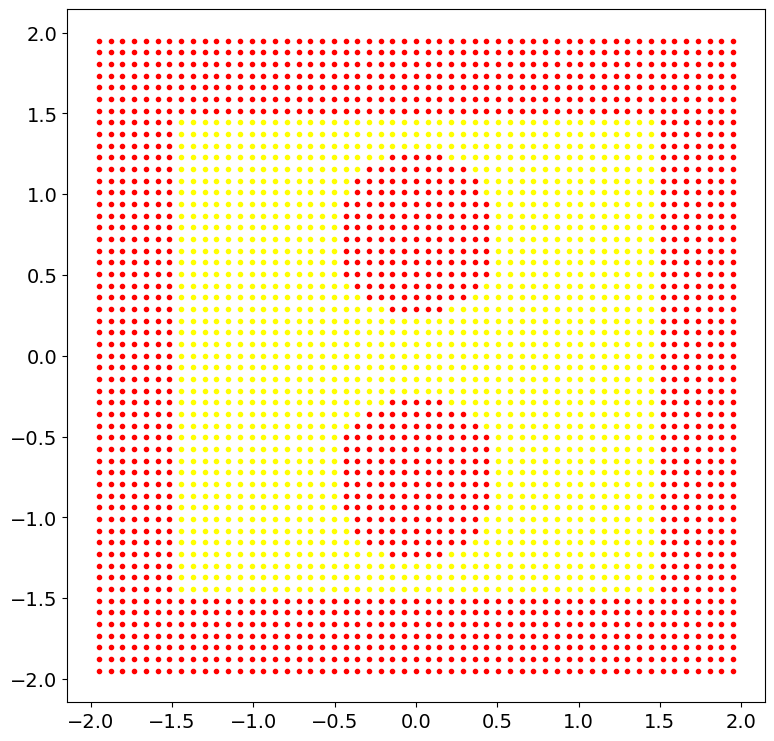

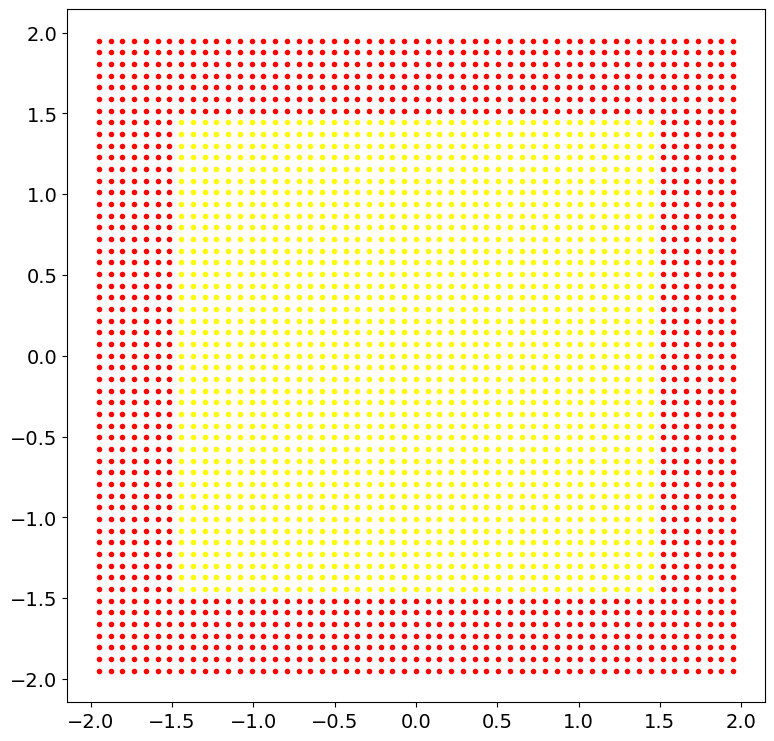

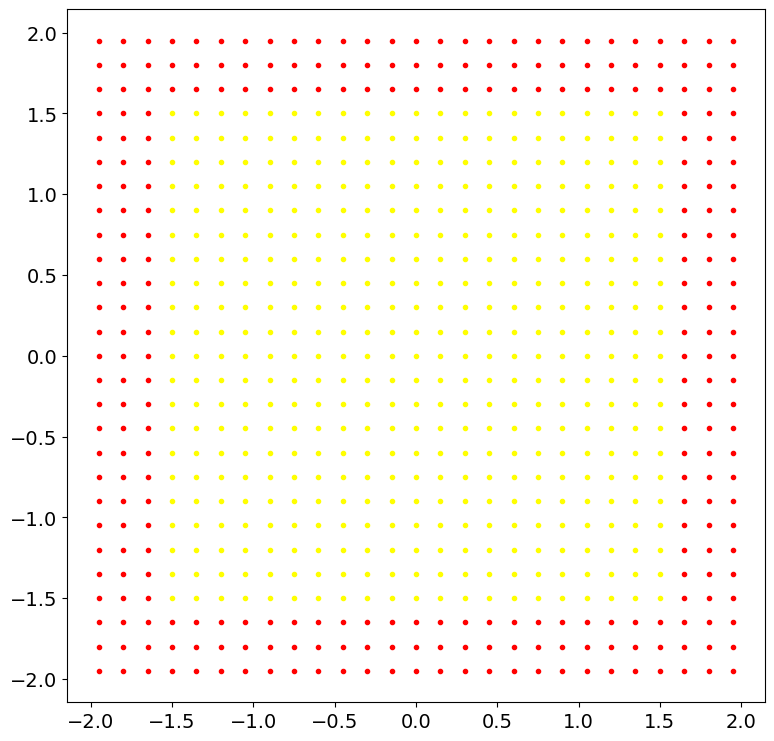

In [2]:
#########################
### Data Construction ###
#########################

# grid parameters 
width         = 3
unsafe_margin = 0.3

# main grid -- unsafe_margin defines wall obstacles
grid, obs_dict = make_rectangle(height=width, width=width, density=200, unsafe_margin=unsafe_margin, center=(0,0))

# generate two circular obstacles
obs_dict = insert_shape(np.array([0,  0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)
obs_dict = insert_shape(np.array([0, -0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)

# supplementary grids for [c]enters and unsafe [s]amples
c_grid, c_obs_dict = make_rectangle(height=width, width=width, density=200, unsafe_margin=unsafe_margin, center=(0,0))
s_grid, s_obs_dict = make_rectangle(height=width, width=width, density=50 , unsafe_margin=unsafe_margin, center=(0,0))

# show the created grids
plot_data(  grid,   obs_dict)
plot_data(c_grid, c_obs_dict)
plot_data(s_grid, s_obs_dict)

In [3]:
###########################
### Agent Configuration ###
###########################

dynamics = hj.systems.Planar()
bf = 31   # csrbf order
b  = -0.05    # offset 
s  = 0.66 # csrbf zeroing
sensor_radius = 1
rx = 1.5 # sample radius
nm = 0.2 # nm * n_safe = number of neighbors to consider
p  = 0.5 # num neighber percentile under which boundary
rc = 1   # radius around scan in which centers are chosen

# make agent
a = Agent(dynamics, np.array([0, 0]), grid, obs_dict, width=width, 
                                            sensor_radius=1, 
                                            bf = bf, 
                                            b = b, 
                                            s = s)

obstacles=np.array([pt for pt in grid if obs_dict[tuple(np.round(pt, 3))] != 0])
a.obstacles = obstacles

In [4]:
############################
### Scan for initial CBF ###
############################

# scan for obstacles and generate unsafe samples
scan_safe, scan_unsafe = a.scan()
samples  = a.sample(rx, grid=s_grid)
if scan_unsafe.shape[0] != 0:
    x_unsafe = np.vstack((scan_unsafe, samples))
else: # in case no obstacles detected
    x_unsafe = samples

# create buffer region
n_safe = scan_safe.shape[0]
x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)

# collect centers within rc from c_grid
C = []
for x in c_grid:
    if np.linalg.norm(x - a.pos) <= rc:
        C.append(x)
C = np.array(C)
print(C.shape)
a.centers.append(C)

(593, 2)


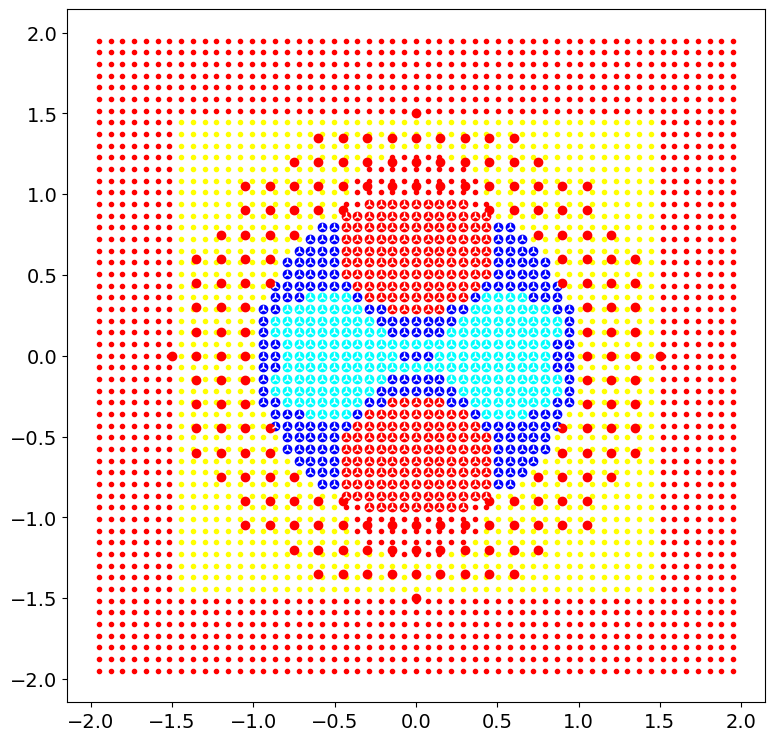

In [5]:
#############################
### Plot initial CBF data ###
#############################

plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                           (x_buffer, "blue"  , 'o'), 
                           (x_unsafe, "red"   , 'o'),
                           (C       , "white" , '2')])

In [6]:
##############################
### Initial CBF Parameters ###
##############################

theta_max    = 10
max_elem     = 100
gamma_safe   = 0.3
gamma_unsafe = -0.01
gamma_dyn    = 0.01
lam_safe     = 25
lam_dyn      = 5
lam_unsafe   = 125
lam_dh       = 0.5

In [7]:
#########################
### Solve Initial CBF ###
#########################

h = get_h(a)
L = get_learning_cbfs_lagrangian(a, x_safe, x_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, np.random.rand(C.shape[0], 1), approx_grad=False, iprint=50)
a.thetas.append(theta)
a.rectify_c_and_theta()

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          593     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21277D+03    |proj g|=  3.65533D+01


 This problem is unconstrained.



At iterate   50    f=  8.53992D+02    |proj g|=  1.05147D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  593     75    153      1     0     0   1.062D+00   8.539D+02
  F =   853.93911155121475     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(593, 2)



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


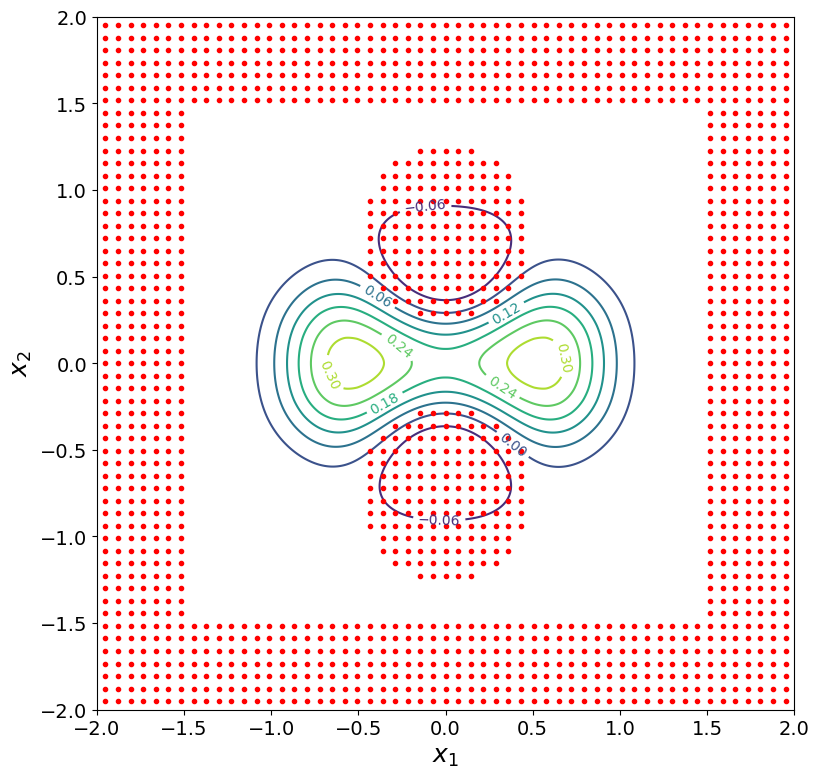

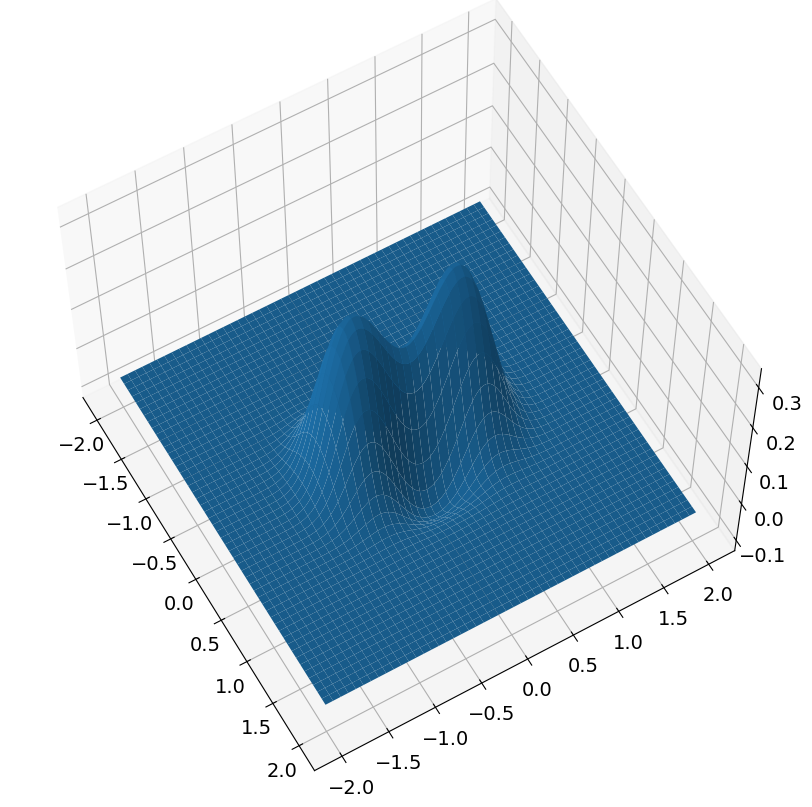

In [8]:
########################
### Plot Initial CBF ###
########################

#start = timer()
plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)
#elapsed_time = timer() - start
#print("time:", elapsed_time)

In [9]:
##################################
### Configure Safe Exploration ###
##################################

tol  = 0.05 # h-value at which to halt approac
dx   = 0.2 # if |x'-x|<dx, approach again
tend = 50  # Duration of boundary approach
T    = 3   # MPC horizon (default timestep is 0.05)
N    = 30  # number of CBFs to learn

target: [0.24158218 0.6259149 ]
target in goto [0.24158218 0.6259149 ]
position is [0 0]
h is 0.20273835802064305
start time is 0


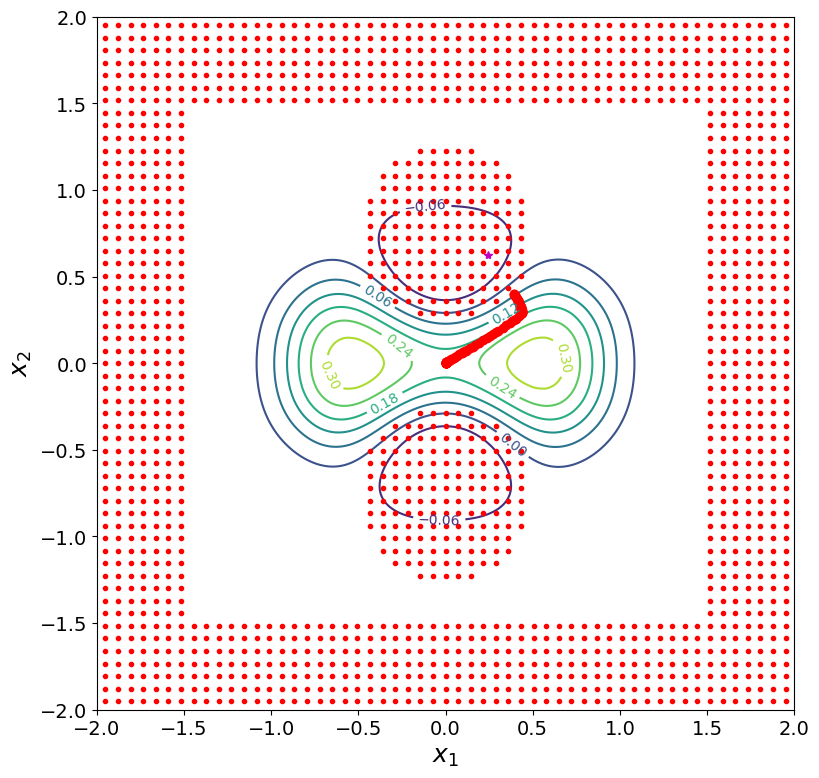

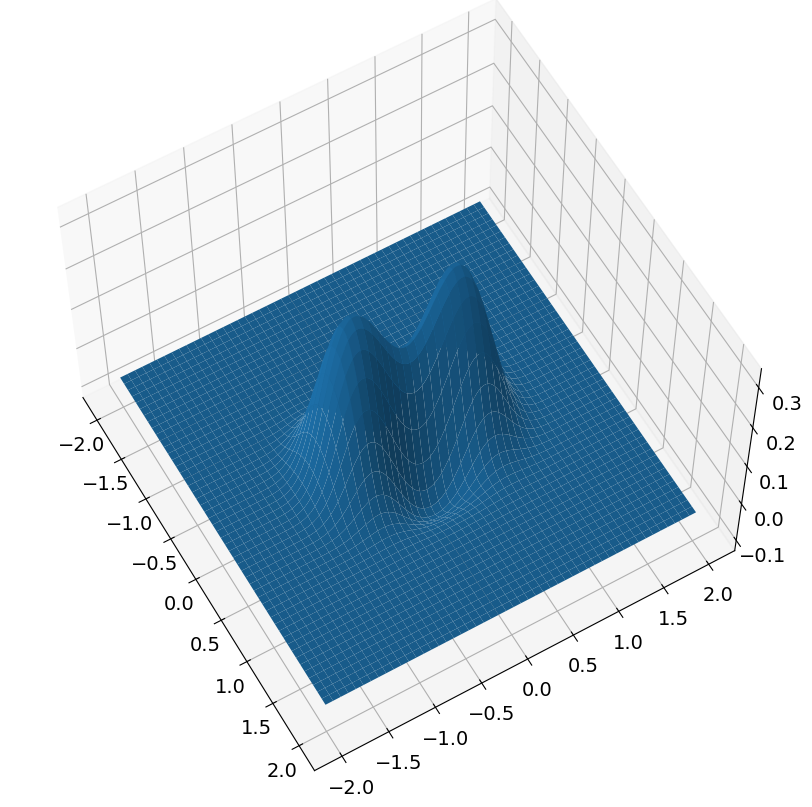

new position is [0.39293146 0.40107168]
h is now 0.049999999999999975
new time is 50
dx: 0.561474509696799


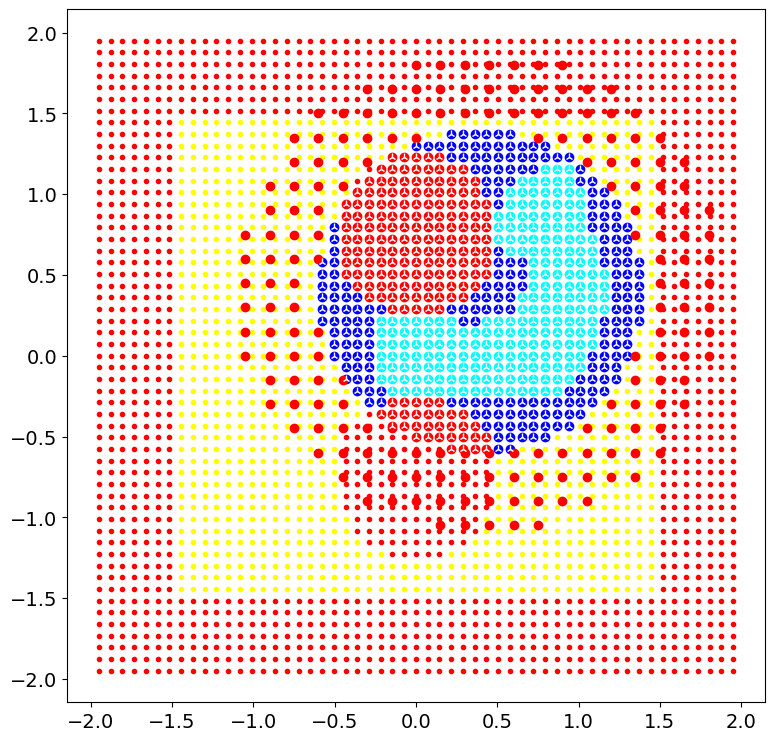

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          608     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31425D+06    |proj g|=  1.07038D+02


 This problem is unconstrained.



At iterate   50    f=  9.11316D+02    |proj g|=  7.16972D-01

At iterate  100    f=  9.11244D+02    |proj g|=  8.52216D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  608    125    188      1     0     0   8.509D-01   9.112D+02
  F =   911.24042120441572     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(593, 2)
(608, 2)
numc 608
cmax before 593
numc > self.cmax
C[i] shape before (593, 2)
C[i] shape after (608, 2)
theta[i] shape before (593,)
theta[i] shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)


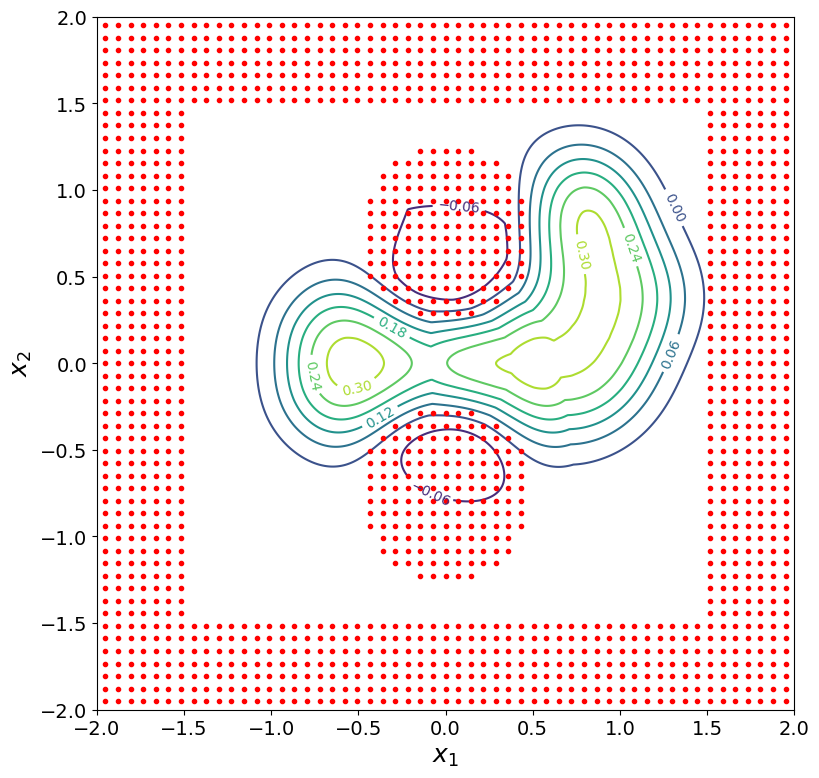

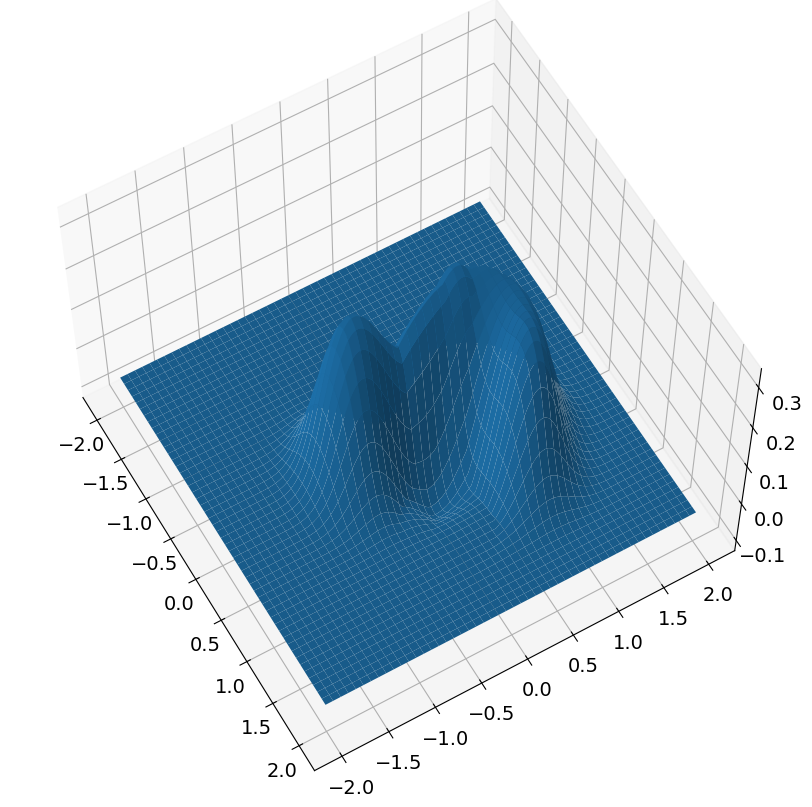

target: [0.62325581 1.78975324]
target in goto [0.62325581 1.78975324]
position is [0.39293146 0.40107168]
h is 0.049999999999999975
start time is 50


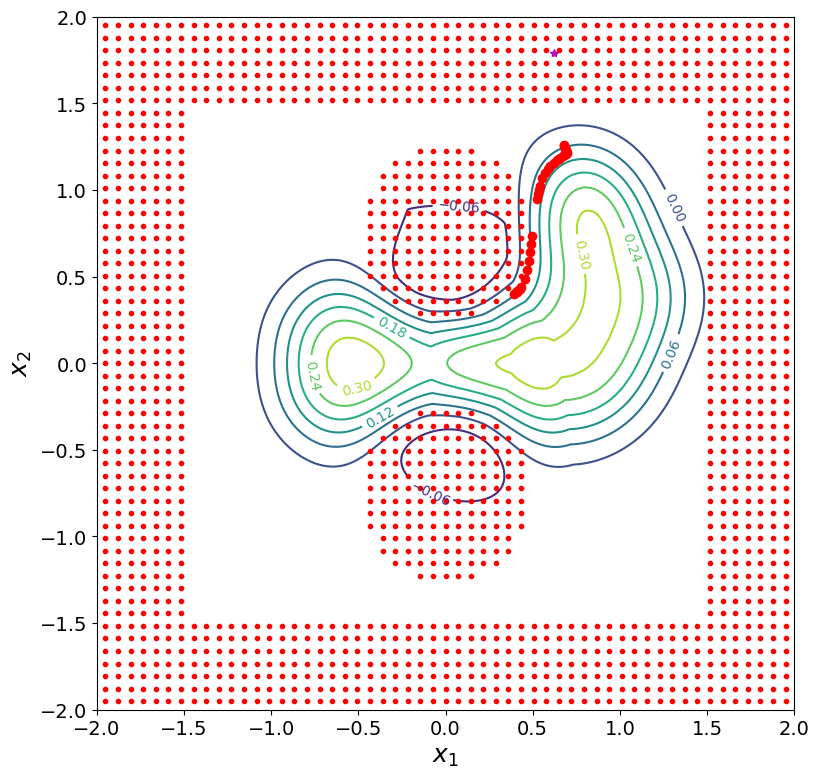

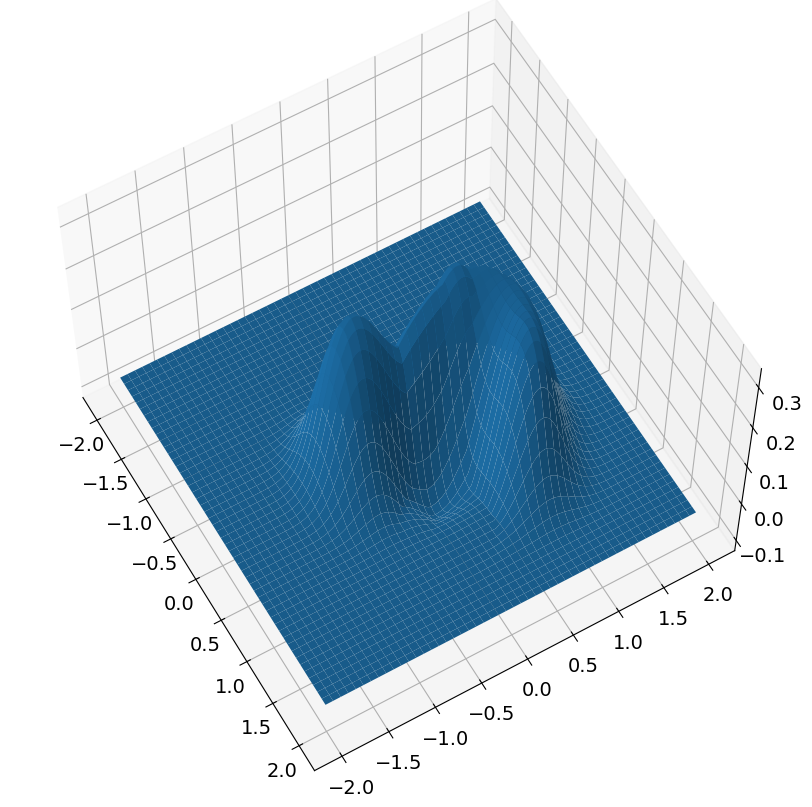

new position is [0.6788909  1.26192848]
h is now 0.05000000000000003
new time is 100
dx: 0.9071092709931562


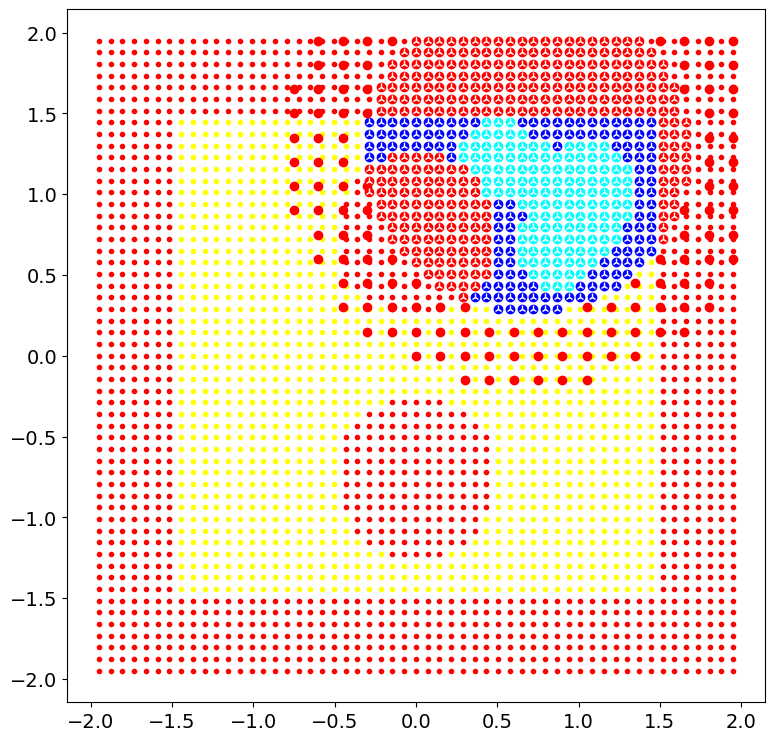

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          557     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18556D+06    |proj g|=  1.11419D+02


 This problem is unconstrained.



At iterate   50    f=  5.86728D+02    |proj g|=  1.01534D+00

At iterate  100    f=  5.86671D+02    |proj g|=  1.35031D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  557    142    242      1     0     0   1.324D+00   5.867D+02
  F =   586.65140918207931     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(557, 2)
numc 557
cmax before 608
numc <= self.cmax
Cnew shape before (557, 2)
Cnew shape after (557, 2)
theta shape before (557,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)


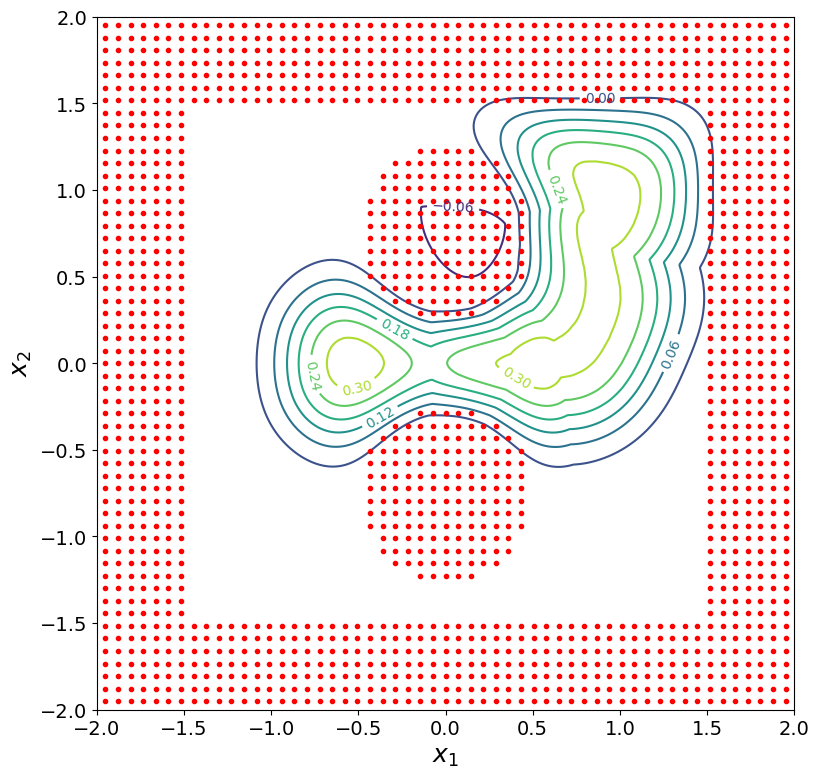

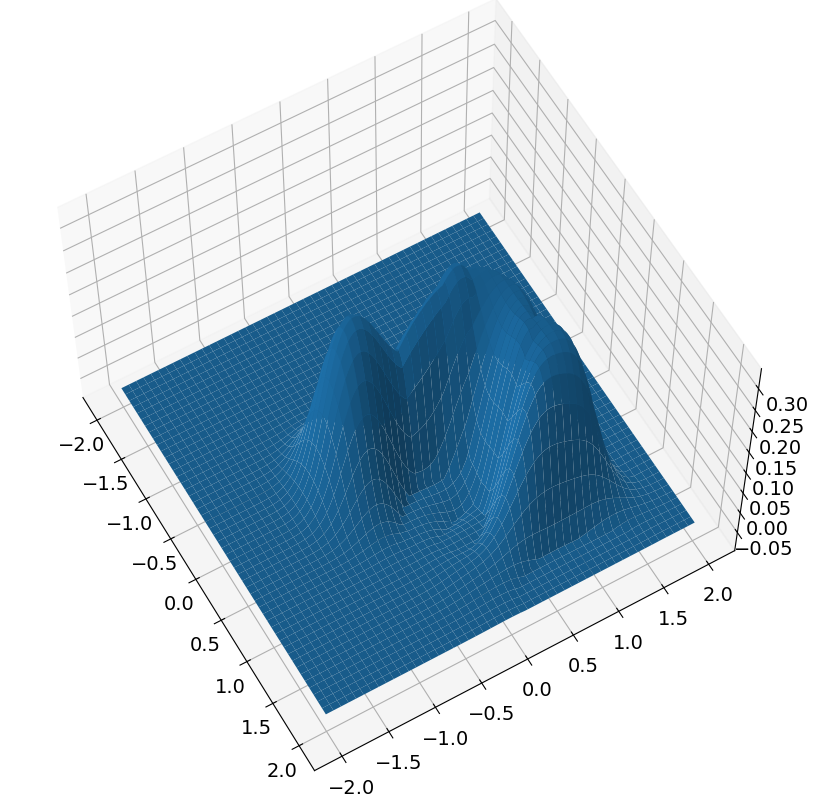

target: [1.6494577  0.35161649]
target in goto [1.6494577  0.35161649]
position is [0.6788909  1.26192848]
h is 0.24157141164999174
start time is 100


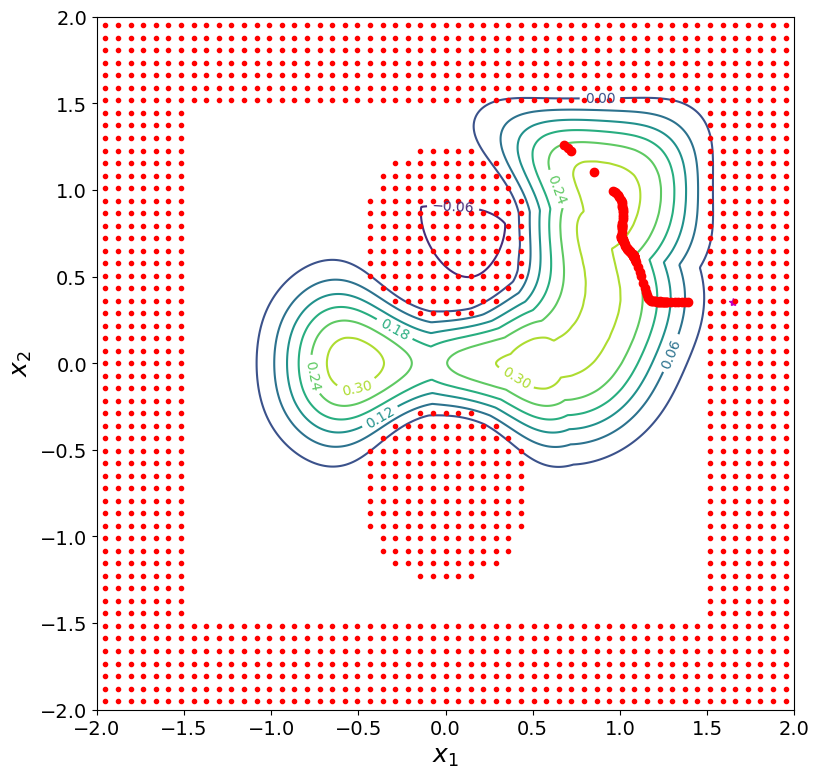

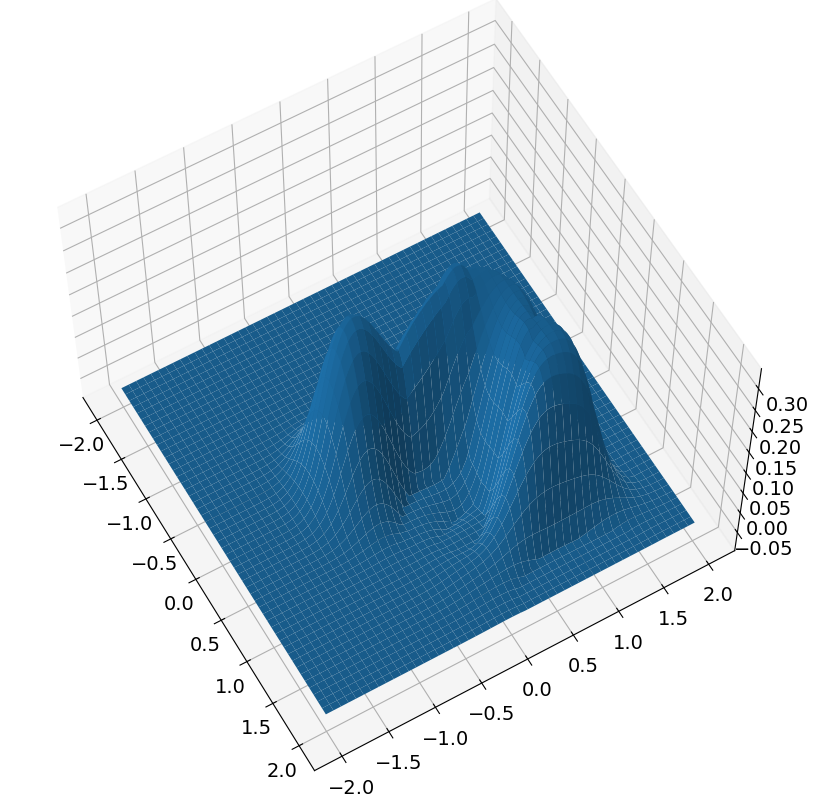

new position is [1.38833228 0.35348277]
h is now 0.04999999999999992
new time is 150
dx: 1.1526407389220705


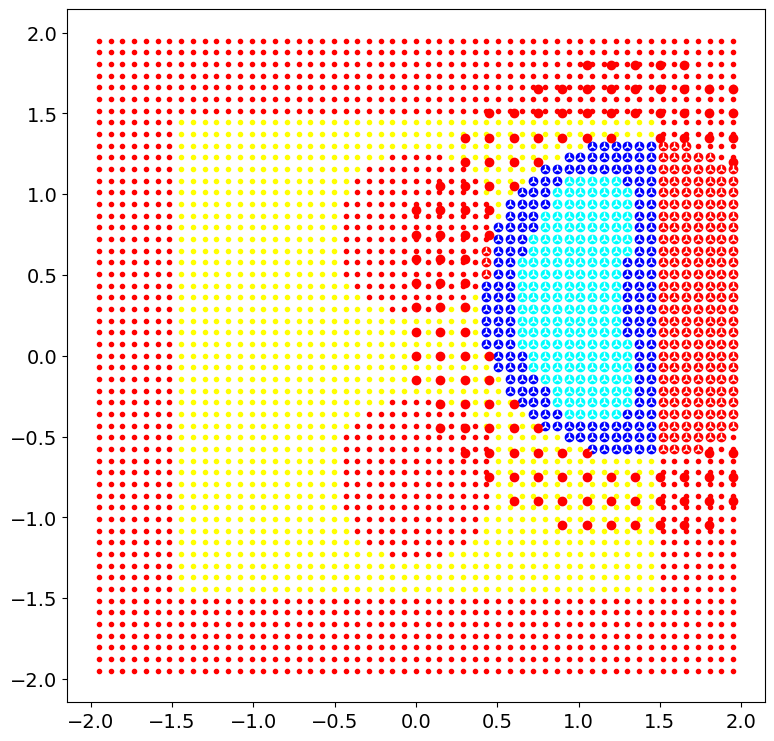

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          516     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.11041D+06    |proj g|=  1.12931D+02

At iterate   50    f=  6.36117D+02    |proj g|=  9.08606D-01

At iterate  100    f=  6.35980D+02    |proj g|=  9.62371D-01

At iterate  150    f=  6.35927D+02    |proj g|=  8.68854D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  516    167    308      1     0     0   9.671D-01   6.359D+02
  F =   635.91135147712066     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers 

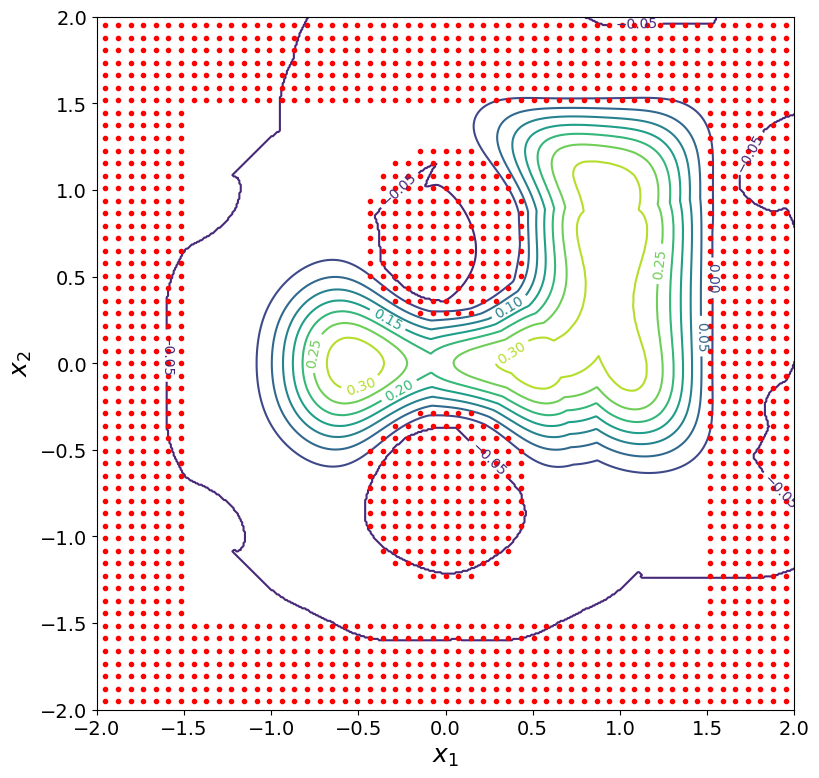

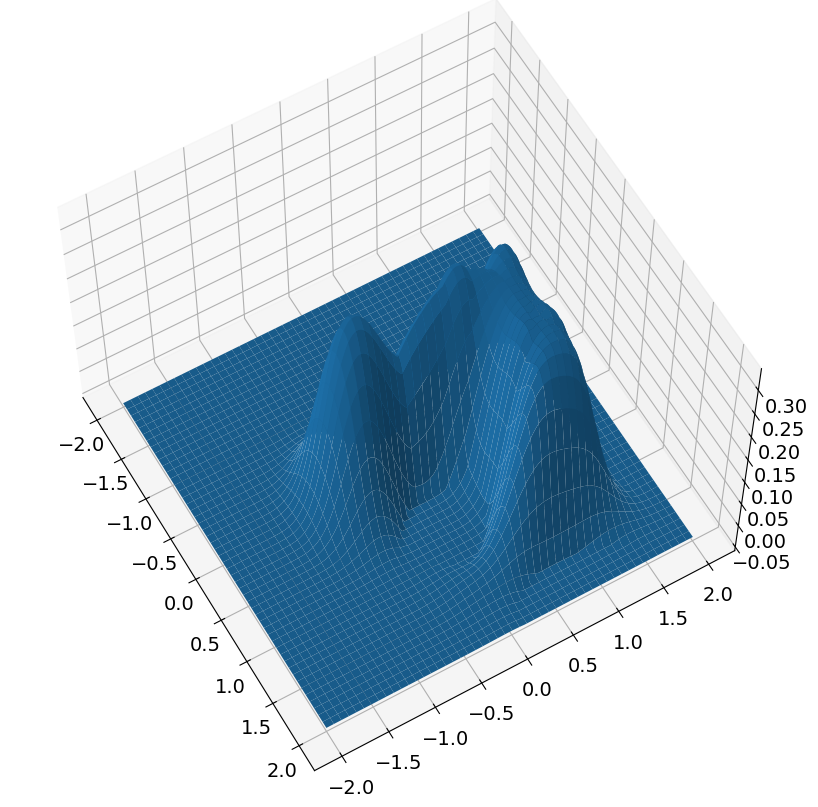

target: [ 1.23961361 -1.79516723]
target in goto [ 1.23961361 -1.79516723]
position is [1.38833228 0.35348277]
h is 0.11562125848375392
start time is 150


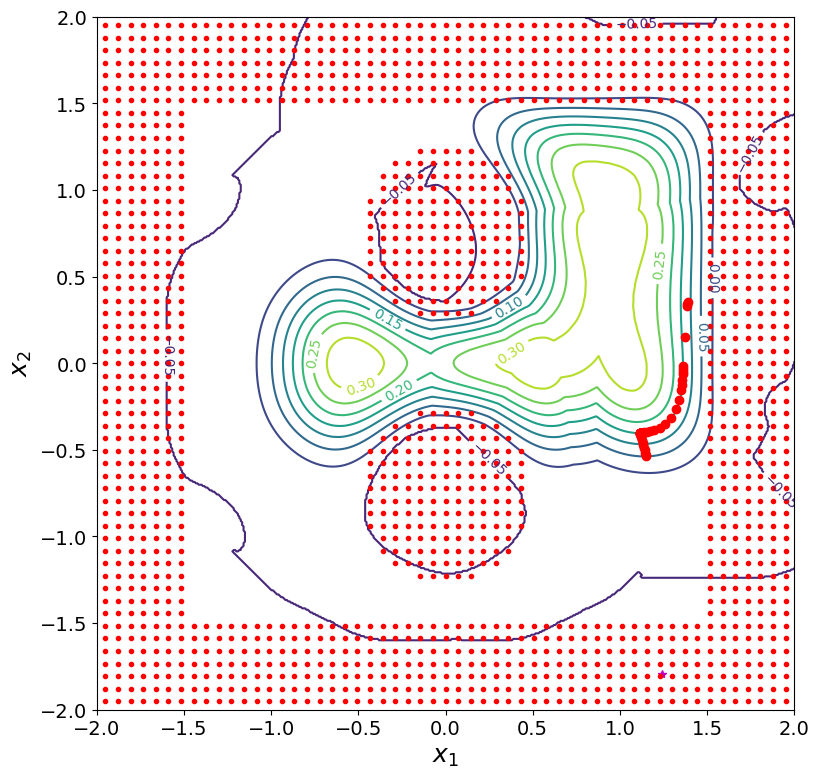

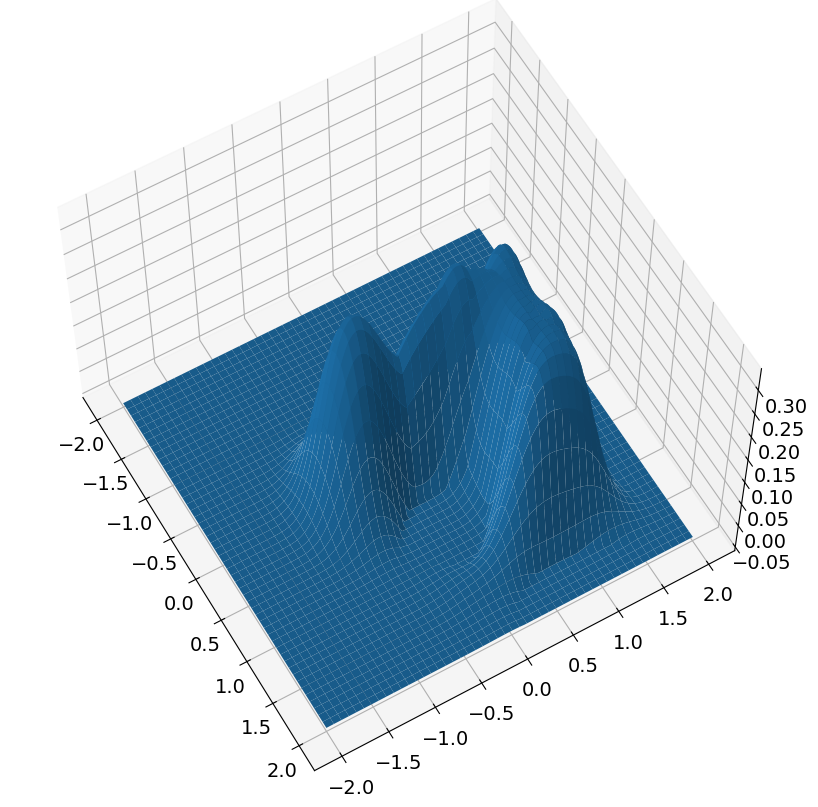

new position is [ 1.15046037 -0.53795869]
h is now 0.049999999999999975
new time is 200
dx: 0.9226326133591938


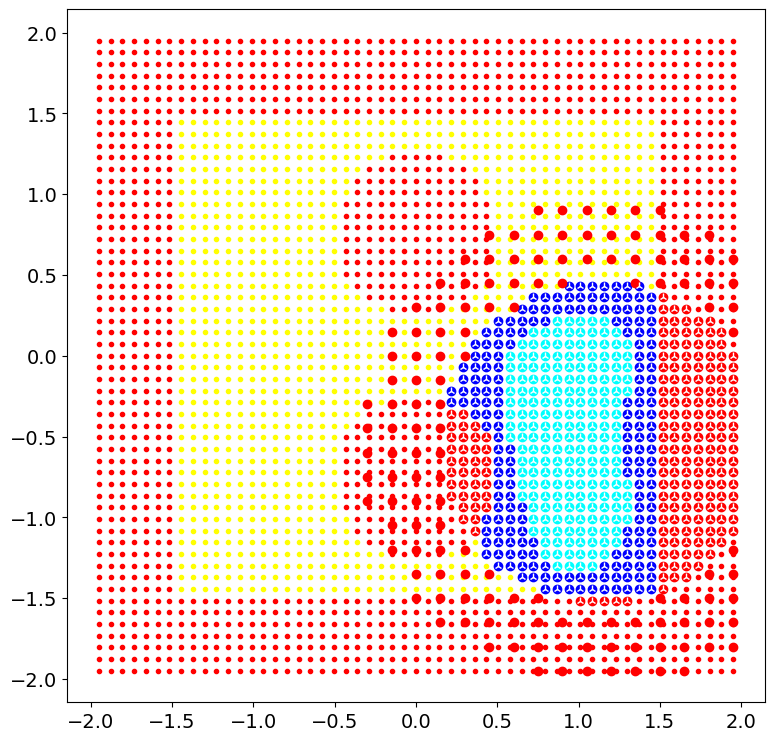

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          578     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25258D+06    |proj g|=  1.10219D+02


 This problem is unconstrained.



At iterate   50    f=  7.03719D+02    |proj g|=  1.06791D+00

At iterate  100    f=  7.03640D+02    |proj g|=  1.23743D+00

At iterate  150    f=  7.03620D+02    |proj g|=  1.24815D+00

At iterate  200    f=  7.03608D+02    |proj g|=  2.81177D+00

At iterate  250    f=  7.03584D+02    |proj g|=  6.74119D-01
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(578, 2)
numc 578
cmax before 608
numc <= self.cmax
Cnew shape before (578, 2)
Cnew shape after (578, 2)
theta shape before (578,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  

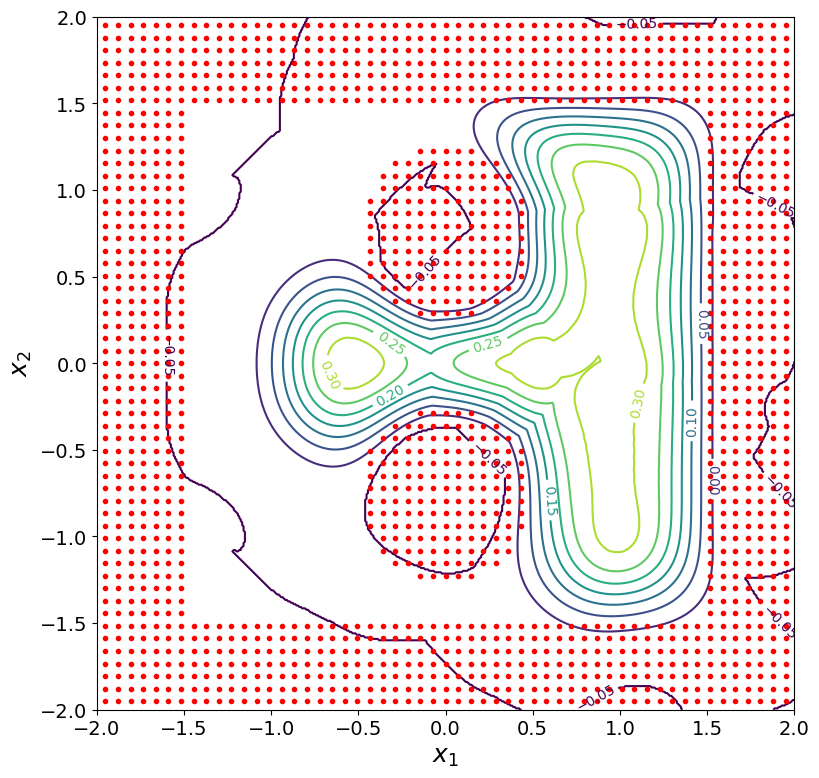

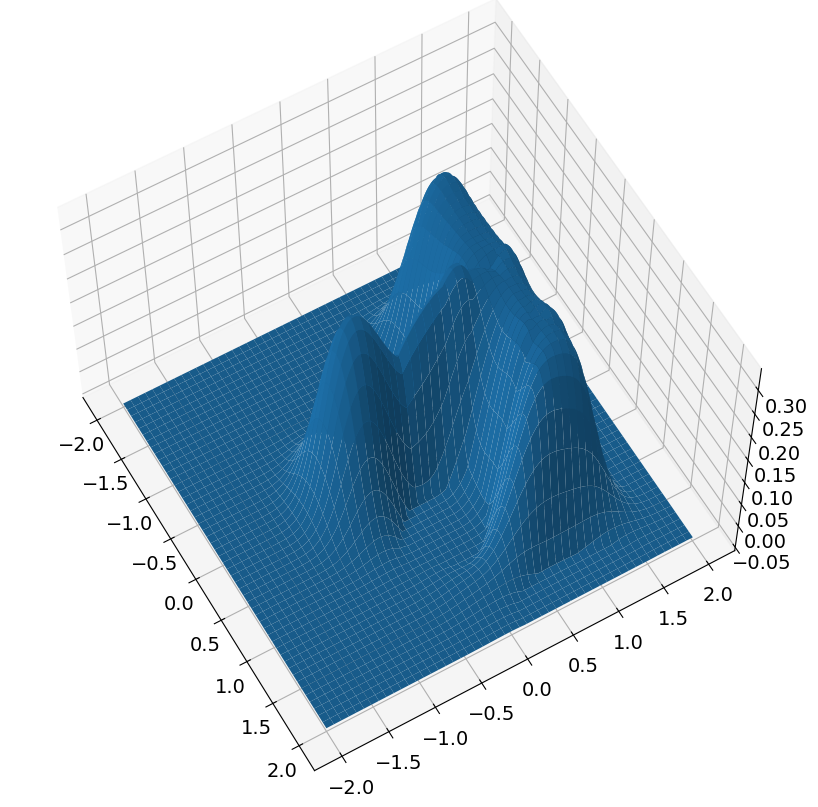

target: [-0.55205919  1.78079097]
target in goto [-0.55205919  1.78079097]
position is [ 1.15046037 -0.53795869]
h is 0.28362363001954
start time is 200


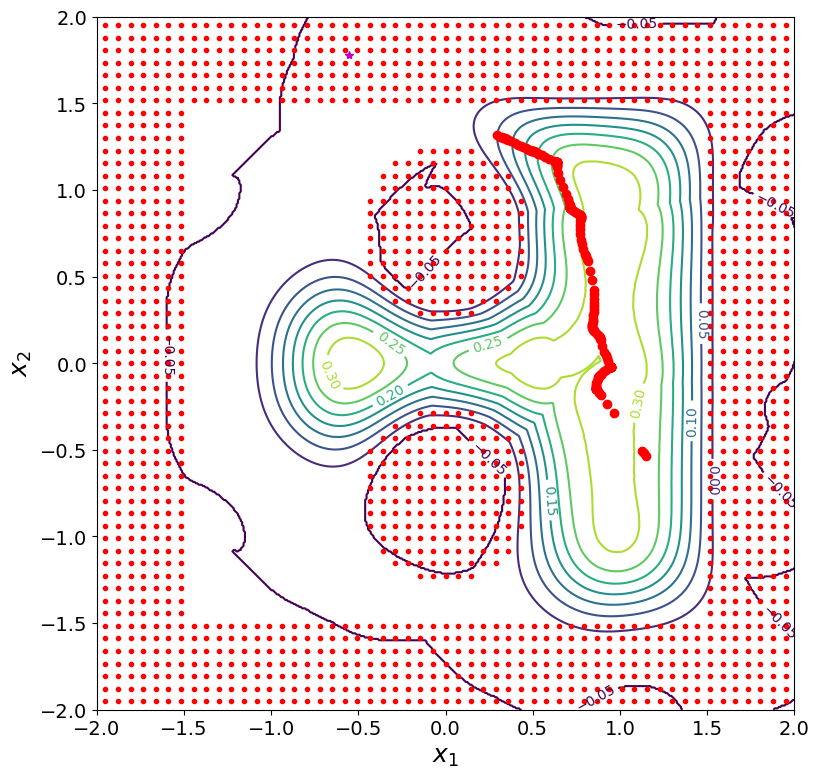

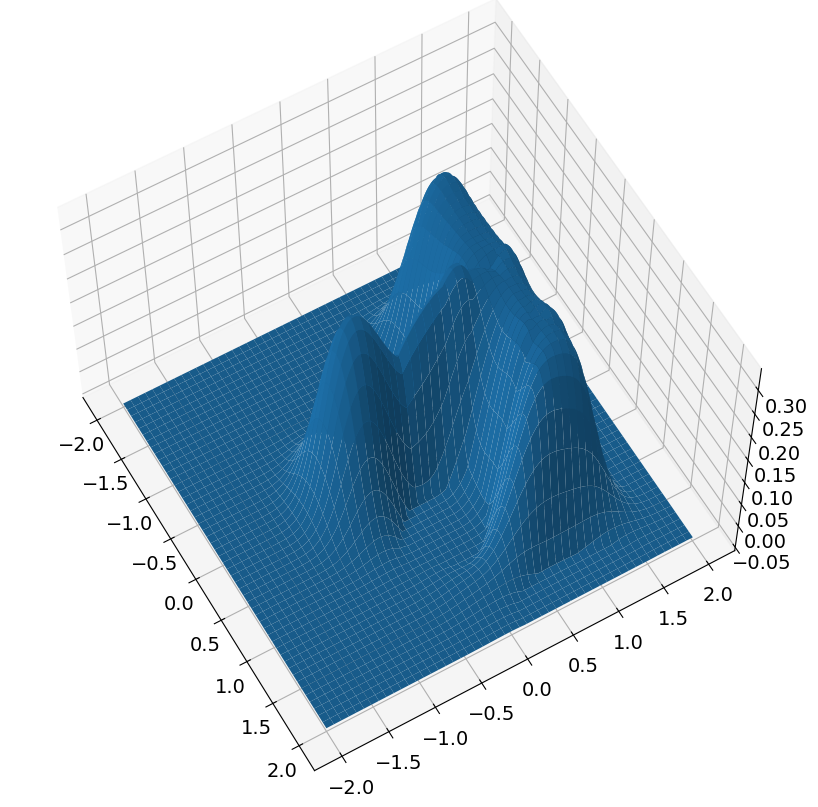

new position is [0.296633   1.31533927]
h is now 0.049999999999999975
new time is 250
dx: 2.040523097552668


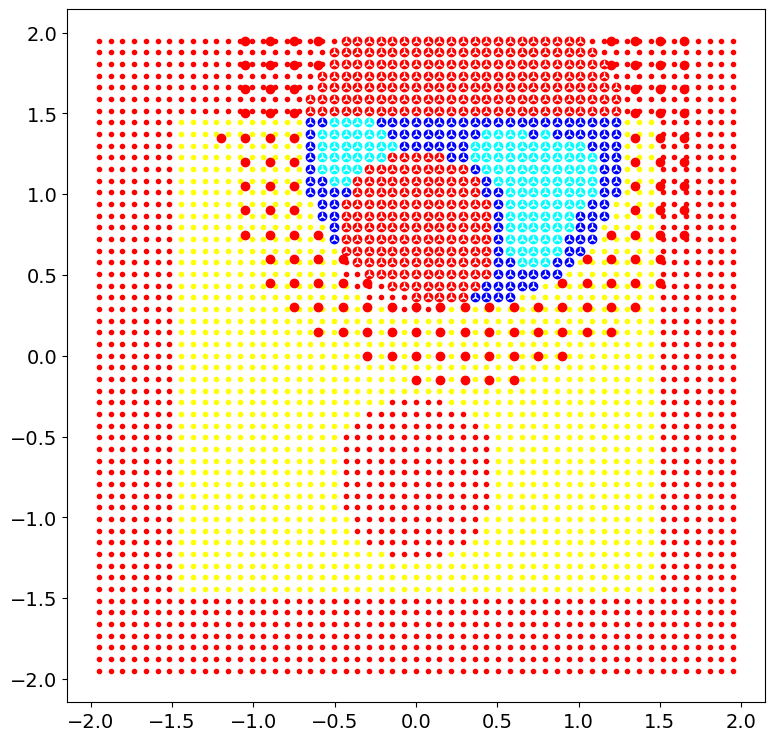

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          537     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.13305D+06    |proj g|=  1.08302D+02


 This problem is unconstrained.



At iterate   50    f=  6.29706D+02    |proj g|=  1.59289D+00

At iterate  100    f=  6.29640D+02    |proj g|=  8.40359D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  537    102    223      1     0     0   8.404D-01   6.296D+02
  F =   629.63988360213887     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(537, 2)
numc 537
cmax before 608
numc <= self.cmax
Cnew shape before (537, 2)
Cnew shape after (537, 2)
theta shape before (537,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608,

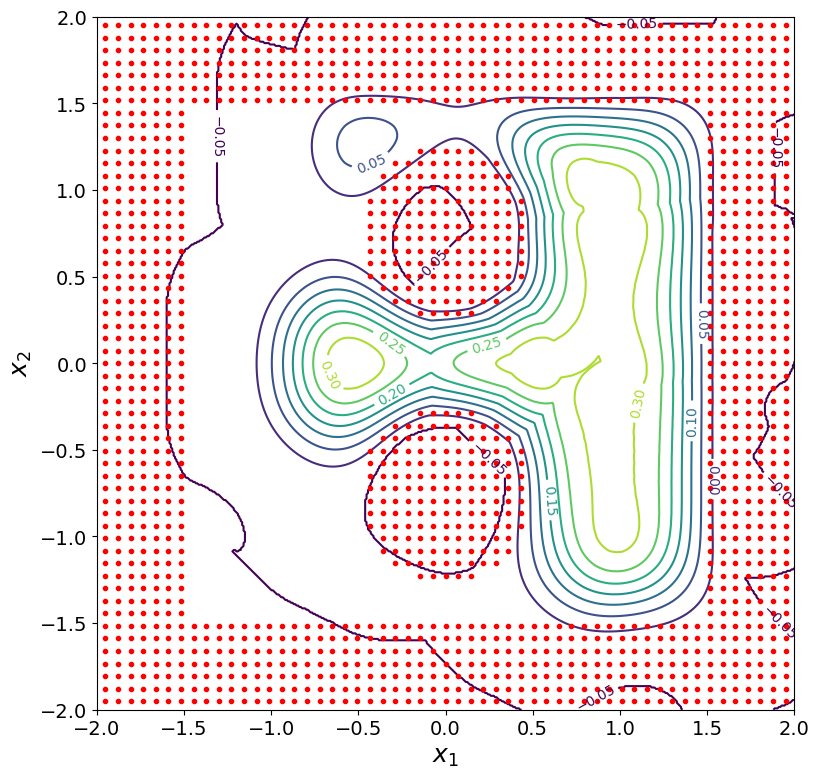

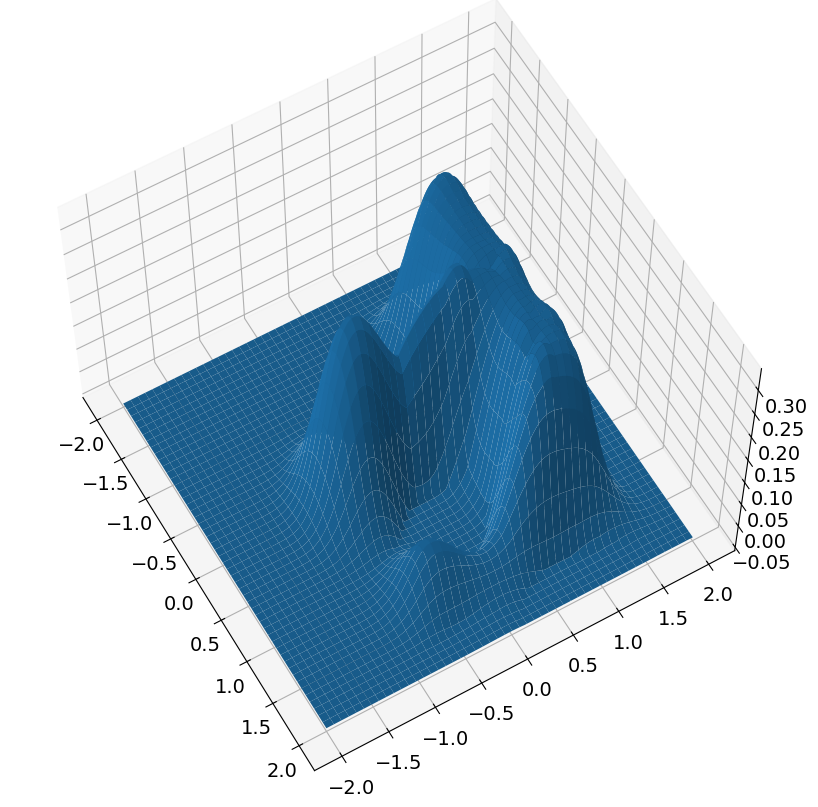

target: [1.90488714 1.48878682]
target in goto [1.90488714 1.48878682]
position is [0.296633   1.31533927]
h is 0.049999999999999975
start time is 250


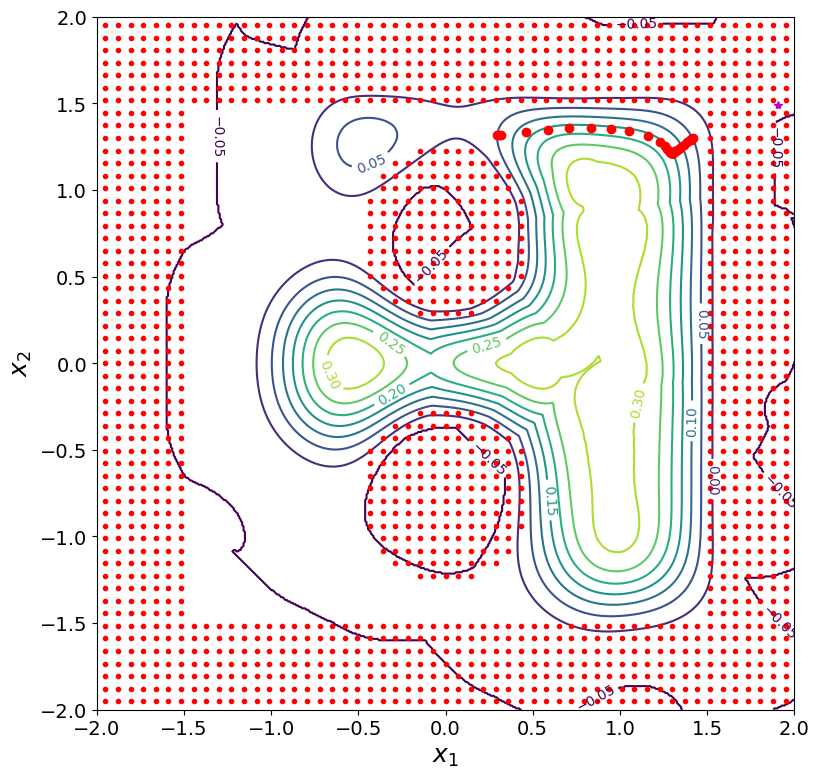

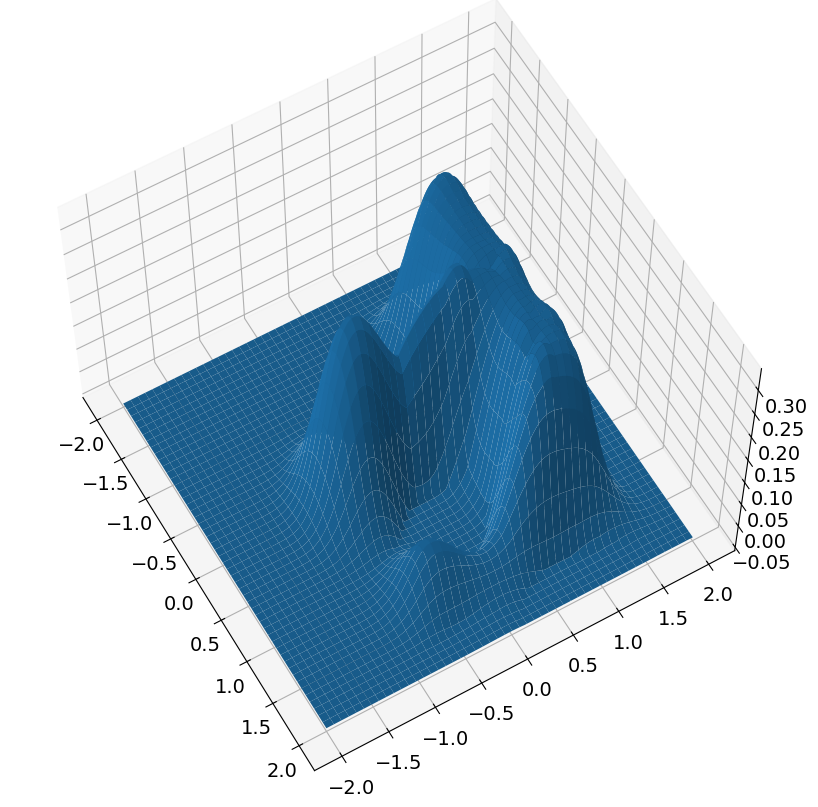

new position is [1.41674839 1.2980099 ]
h is now 0.05000000000000003
new time is 300
dx: 1.1202494364061781


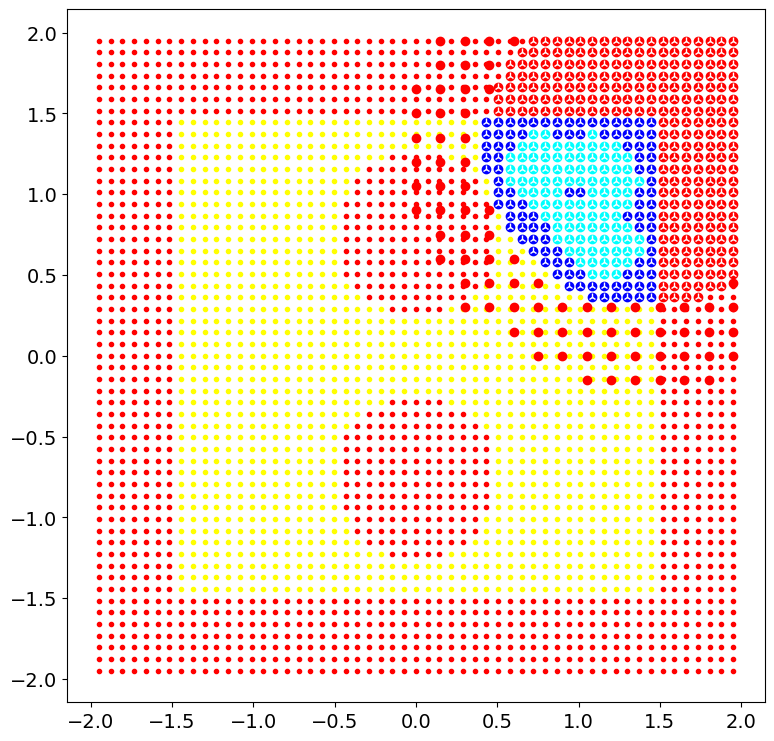

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          447     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.51178D+05    |proj g|=  1.11883D+02


 This problem is unconstrained.



At iterate   50    f=  4.38047D+02    |proj g|=  7.99428D-01

centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(447, 2)
numc 447
cmax before 608
numc <= self.cmax
Cnew shape before (447, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  447     76    167      1     0     0   4.050D-01   4.380D+02
  F =   437.97826160300127     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Cnew shape after (447, 2)
theta shape before (447,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


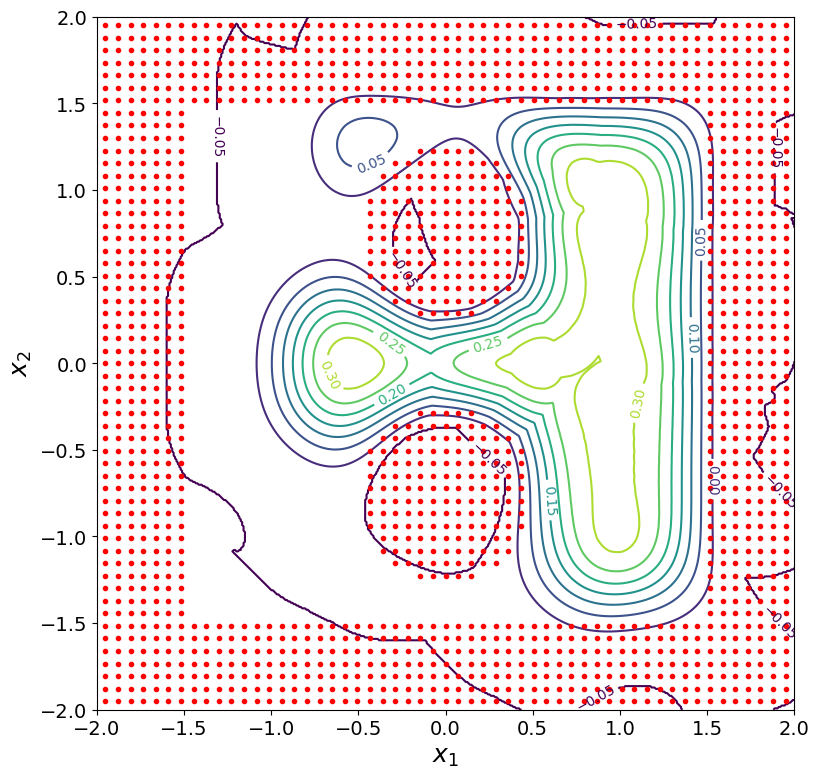

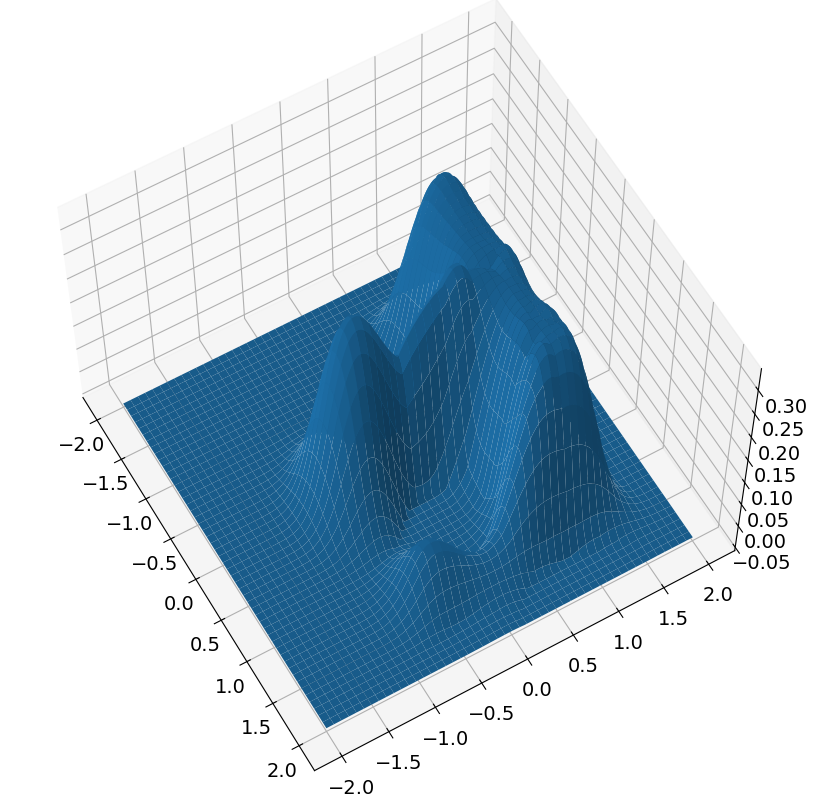

target: [ 0.02093357 -1.00518119]
target in goto [ 0.02093357 -1.00518119]
position is [1.41674839 1.2980099 ]
h is 0.05646952045572855
start time is 300


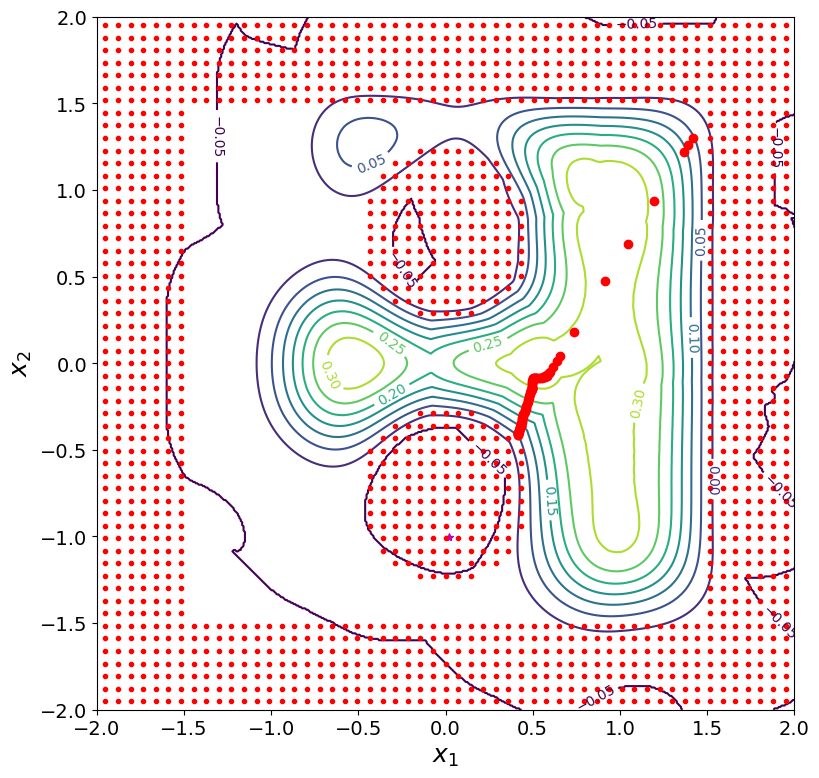

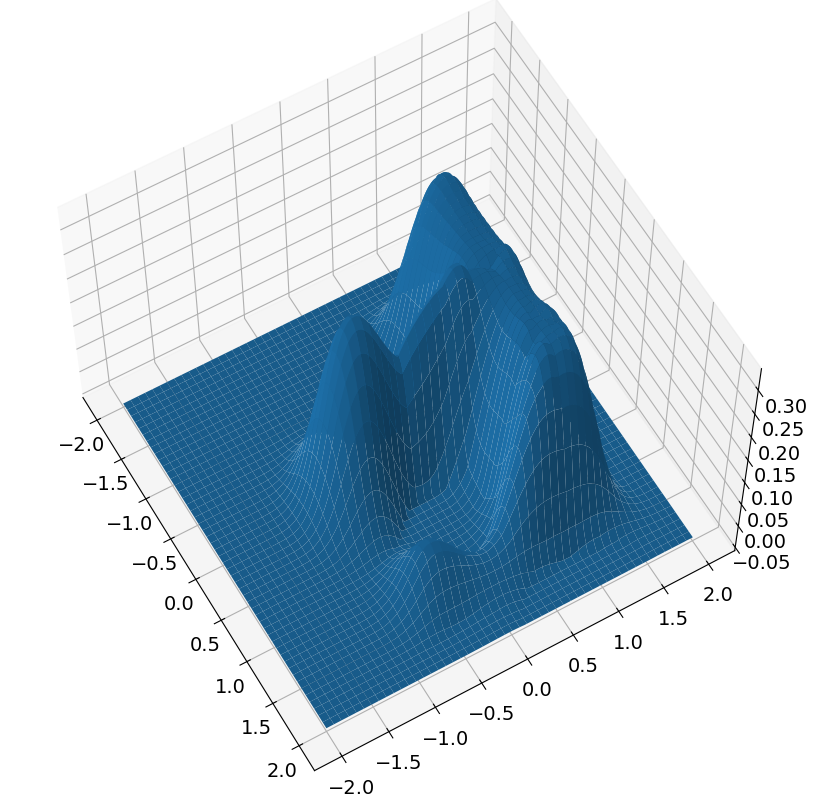

new position is [ 0.41375217 -0.41497722]
h is now 0.05
new time is 350
dx: 1.9850255156001044


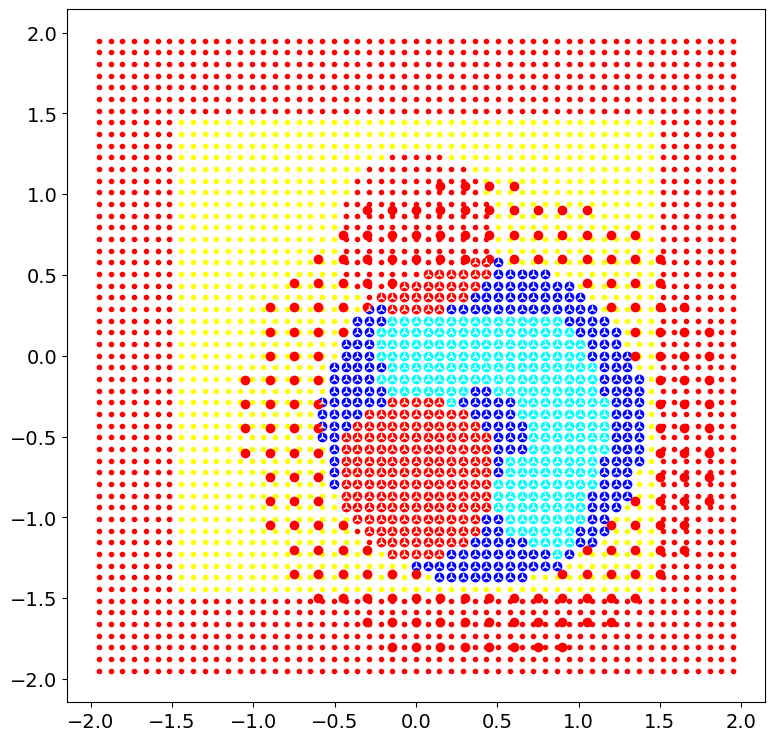

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          607     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32065D+06    |proj g|=  1.06741D+02


 This problem is unconstrained.



At iterate   50    f=  9.25522D+02    |proj g|=  1.54938D+00

At iterate  100    f=  9.25430D+02    |proj g|=  5.68976D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  607    121    206      1     0     0   5.689D-01   9.254D+02
  F =   925.42900721406954     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(607, 2)
numc 607
cmax before 608
numc <= self.cmax
Cnew shape before (607, 2)
Cnew shape after (607, 2)
theta shape before (607,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608,

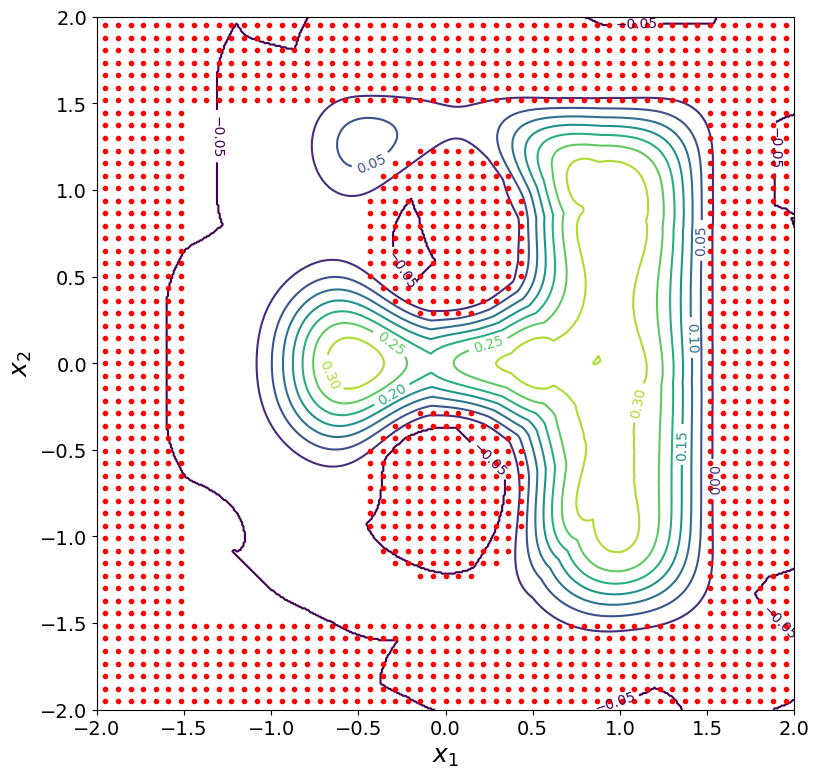

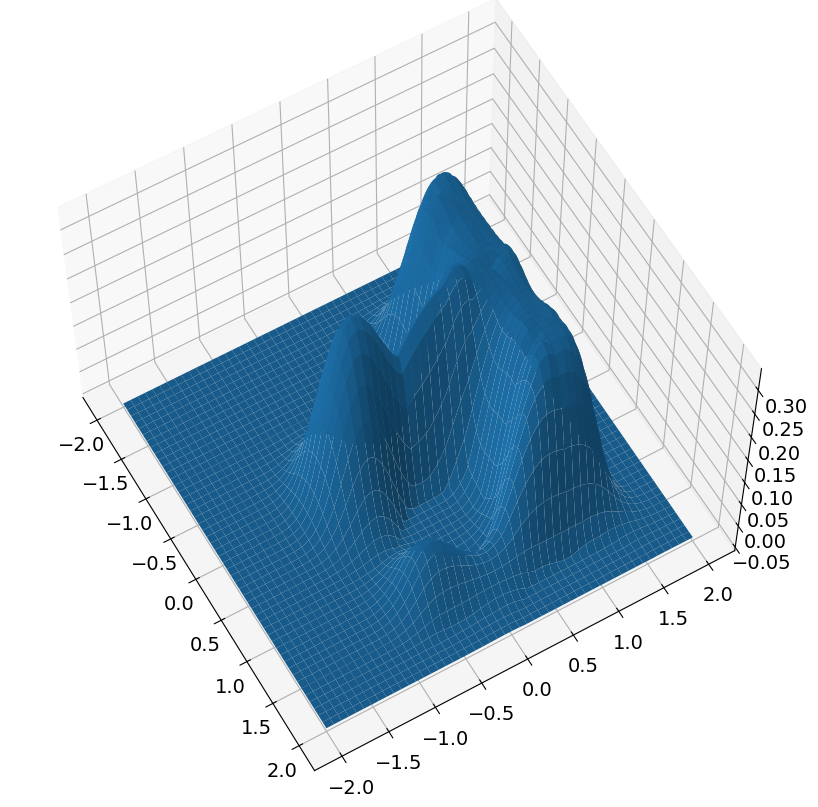

target: [ 1.61221322 -0.95117962]
target in goto [ 1.61221322 -0.95117962]
position is [ 0.41375217 -0.41497722]
h is 0.050208487743271205
start time is 350


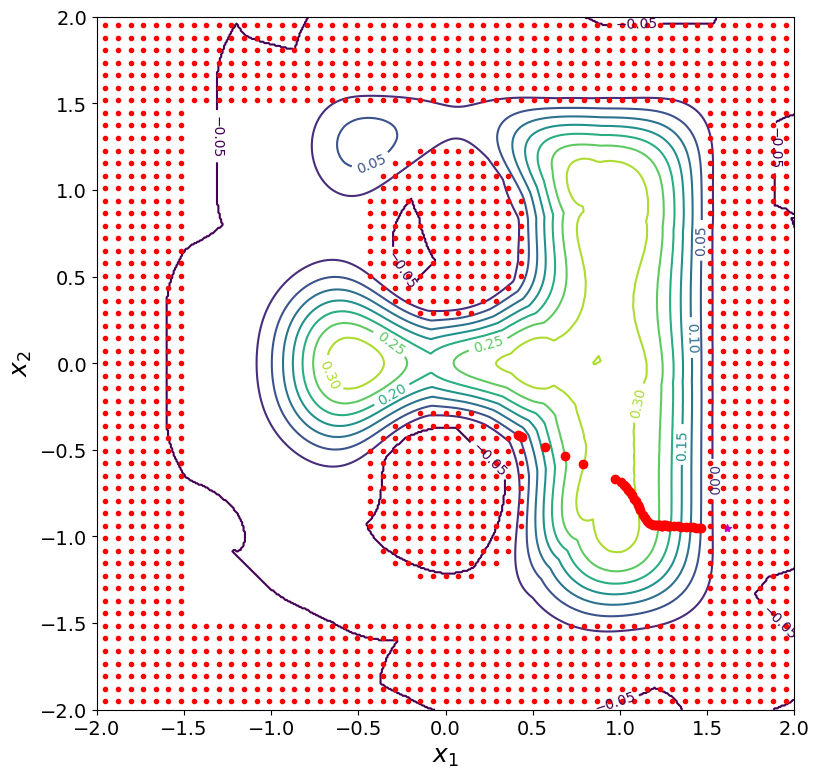

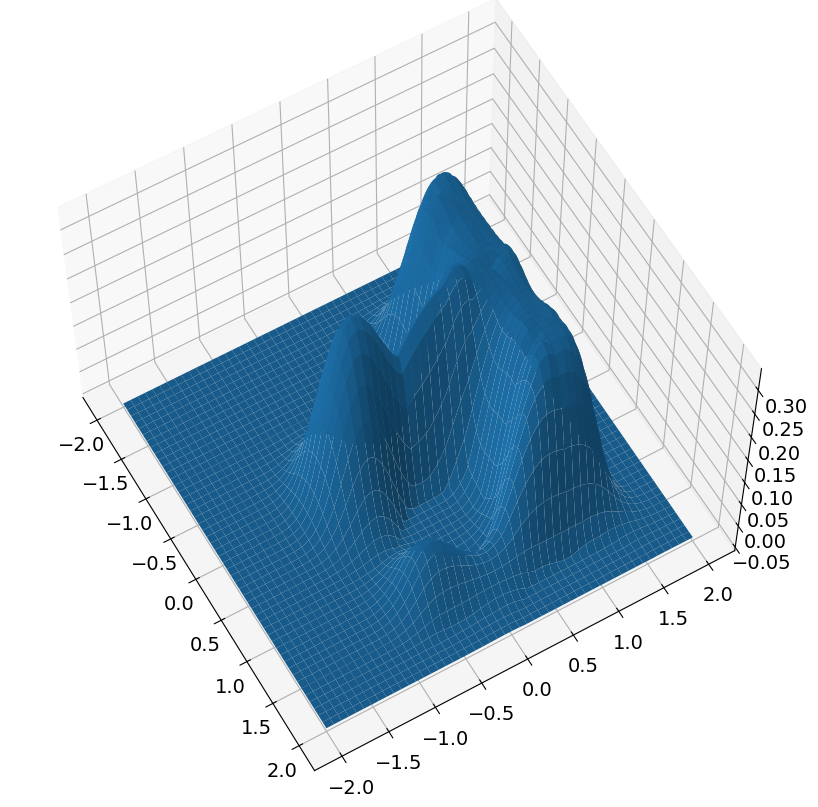

new position is [ 1.46406439 -0.94953334]
h is now 0.05000000000000002
new time is 400
dx: 1.1785185632898263


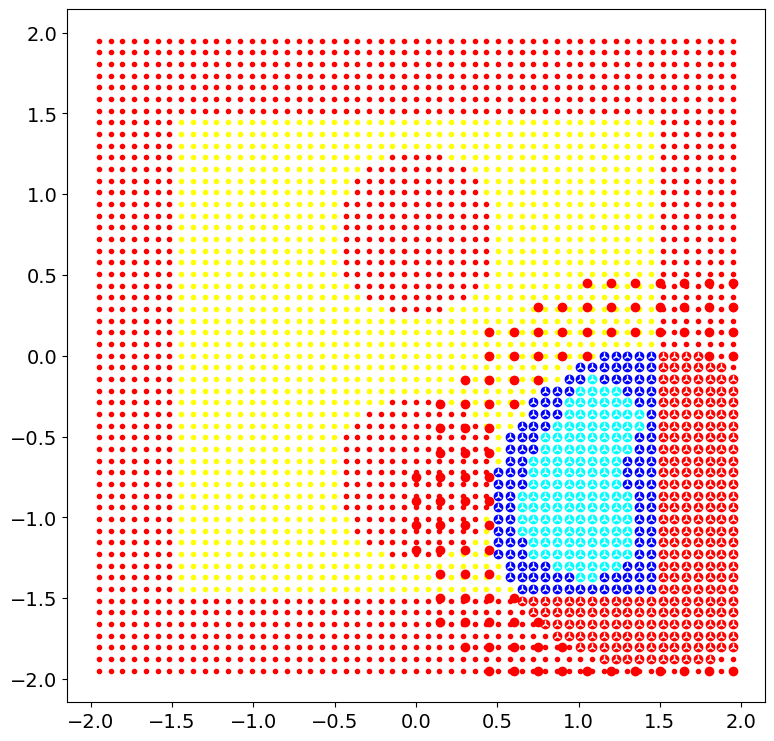

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          490     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.04705D+06    |proj g|=  1.14501D+02

At iterate   50    f=  5.25713D+02    |proj g|=  1.29919D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  490     77    120      1     0     0   3.960D-01   5.256D+02
  F =   525.63117668779989     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(490, 2)
numc 490
cmax before 608
numc

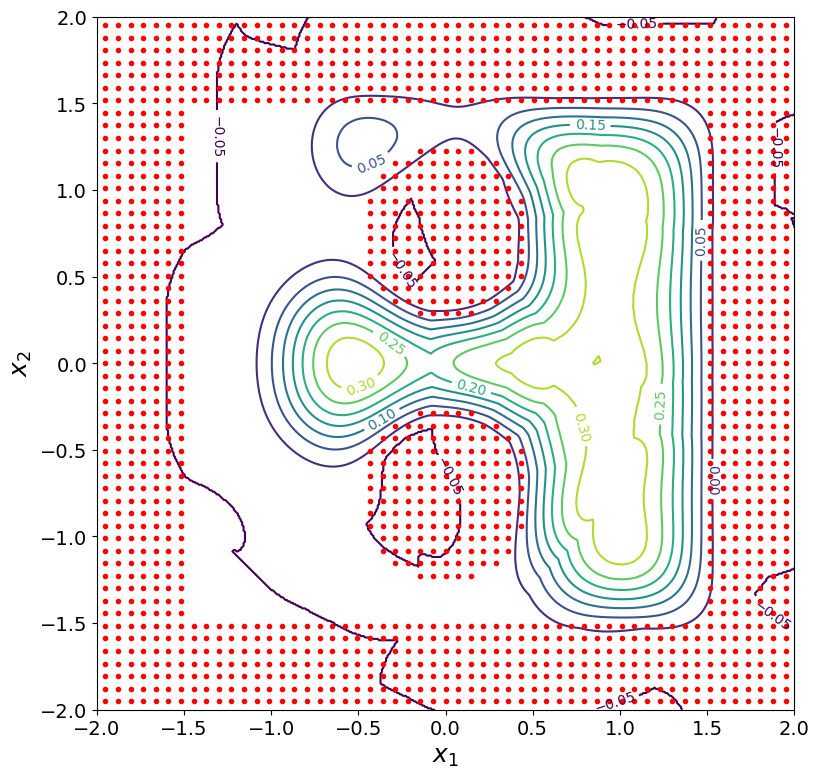

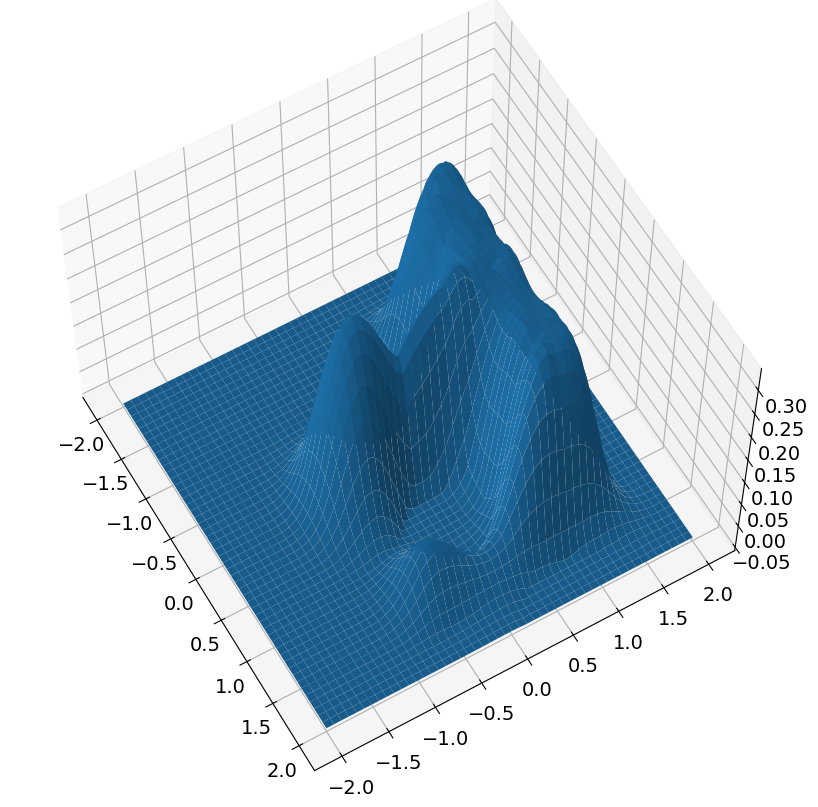

target: [ 1.70026623 -1.32936589]
target in goto [ 1.70026623 -1.32936589]
position is [ 1.46406439 -0.94953334]
h is 0.053120166041501174
start time is 400


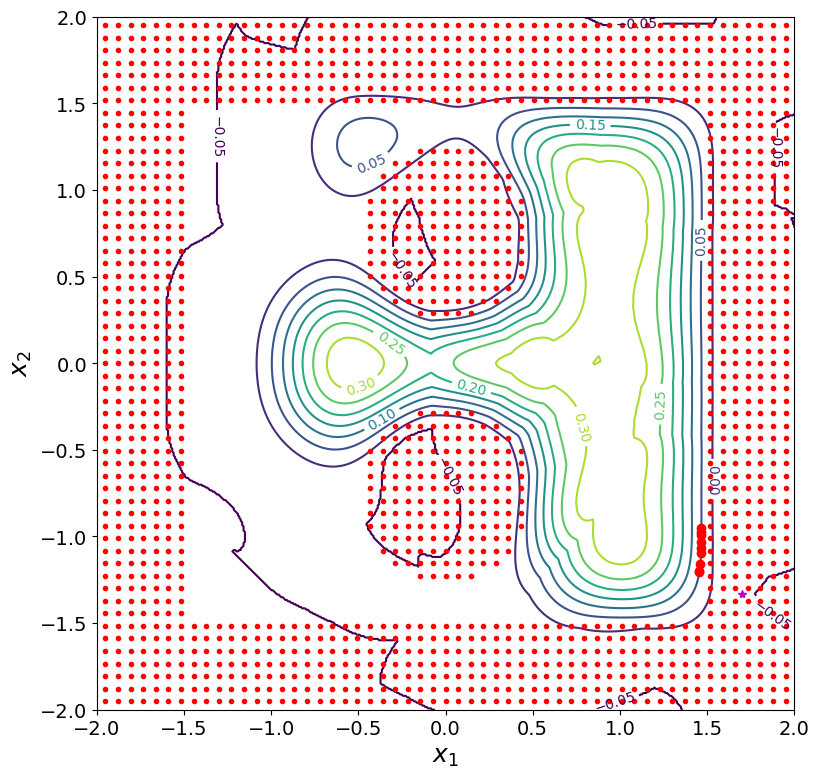

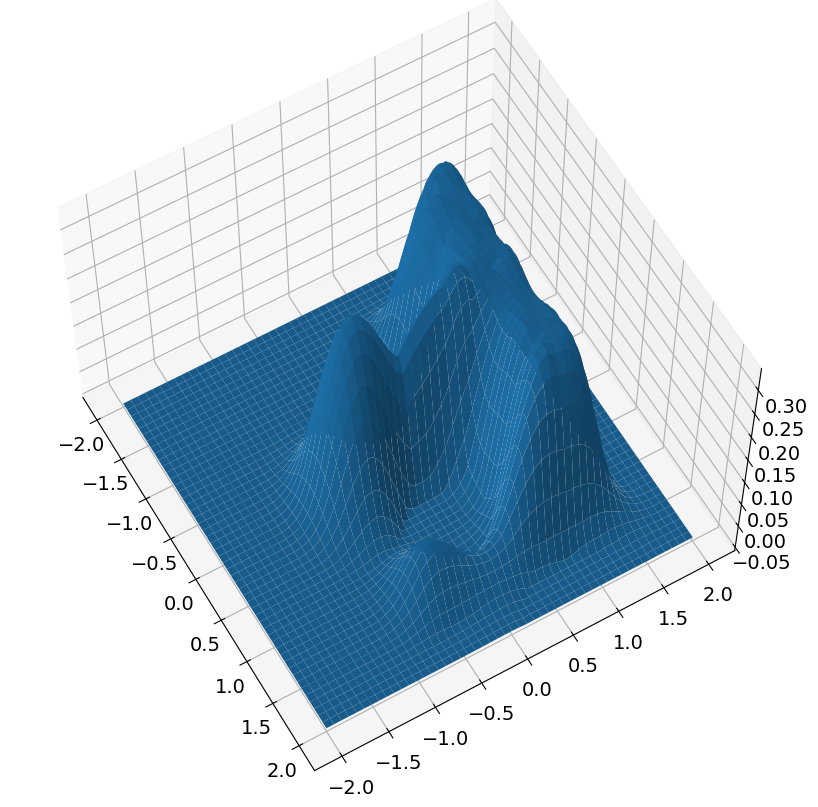

new position is [ 1.45623502 -1.20221461]
h is now 0.04999999999999995
new time is 450
dx: 0.25280253935108604


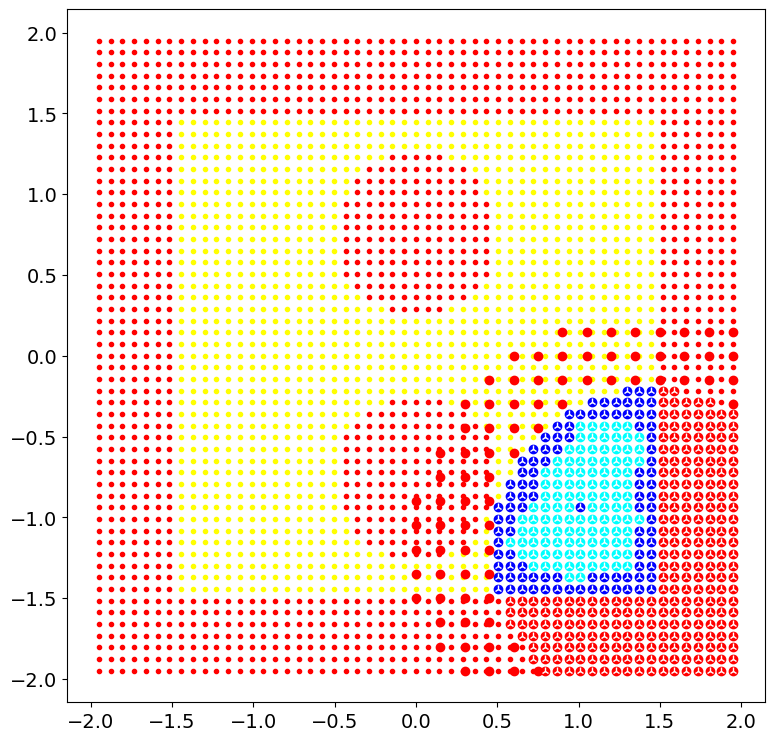

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          460     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.77119D+05    |proj g|=  1.12962D+02


 This problem is unconstrained.



At iterate   50    f=  4.75272D+02    |proj g|=  1.10660D+00

At iterate  100    f=  4.75194D+02    |proj g|=  8.28106D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  460    122    260      1     0     0   8.102D-01   4.752D+02
  F =   475.18224823060575     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(460, 2)
numc 460
cmax before 608
numc <= self.cmax
Cnew shape before (460, 2)
Cnew shape after (460, 2)
theta shape before (460,)
theta_shape after (608,)
cmax after 608
centers shape after
(608,

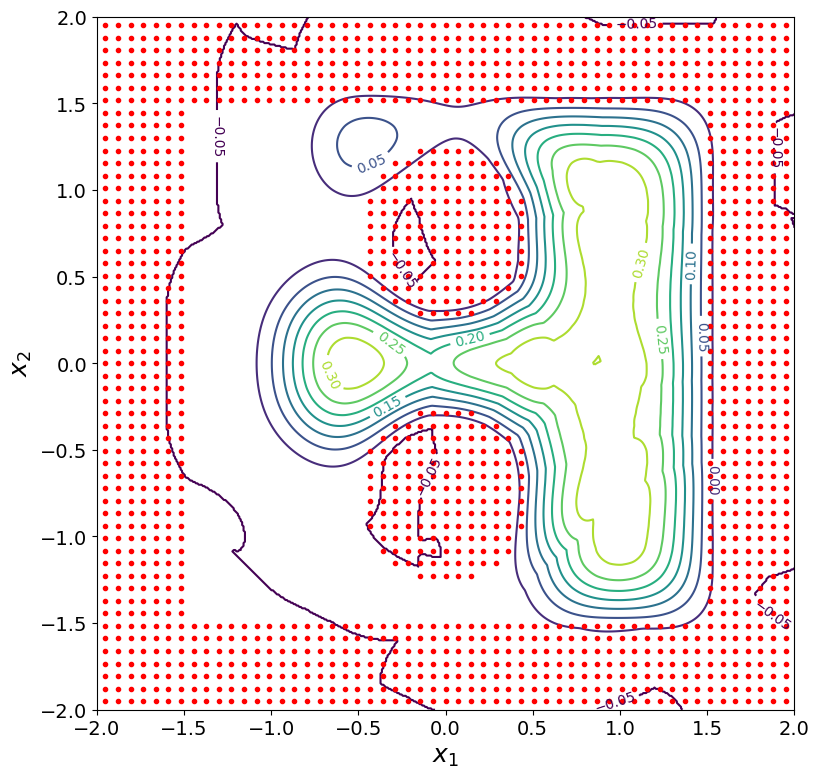

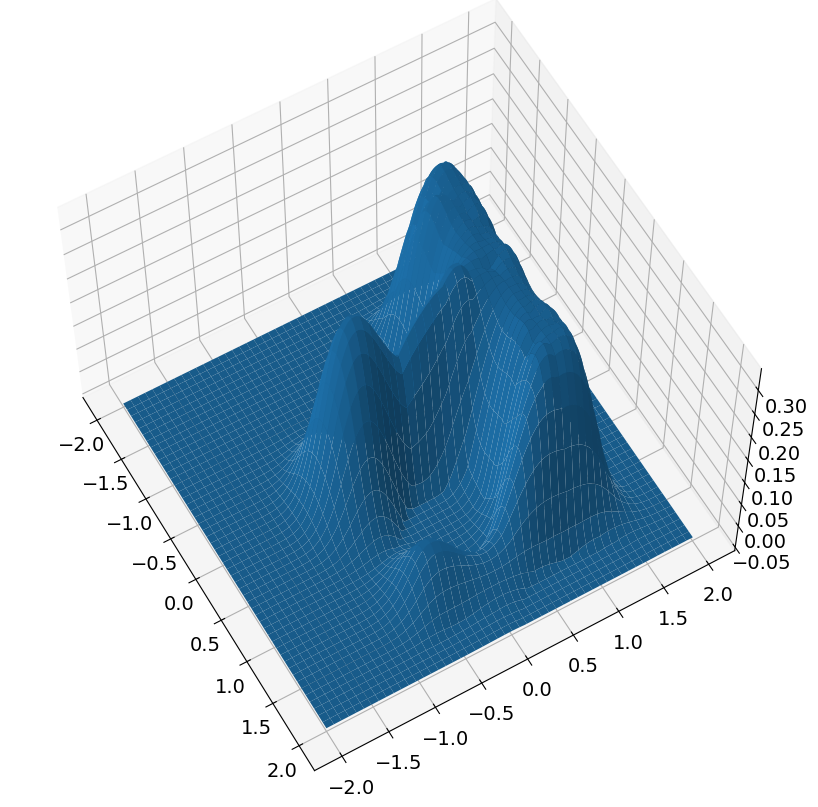

target: [-0.67205697  1.78846522]
target in goto [-0.67205697  1.78846522]
position is [ 1.45623502 -1.20221461]
h is 0.051228400262724946
start time is 450


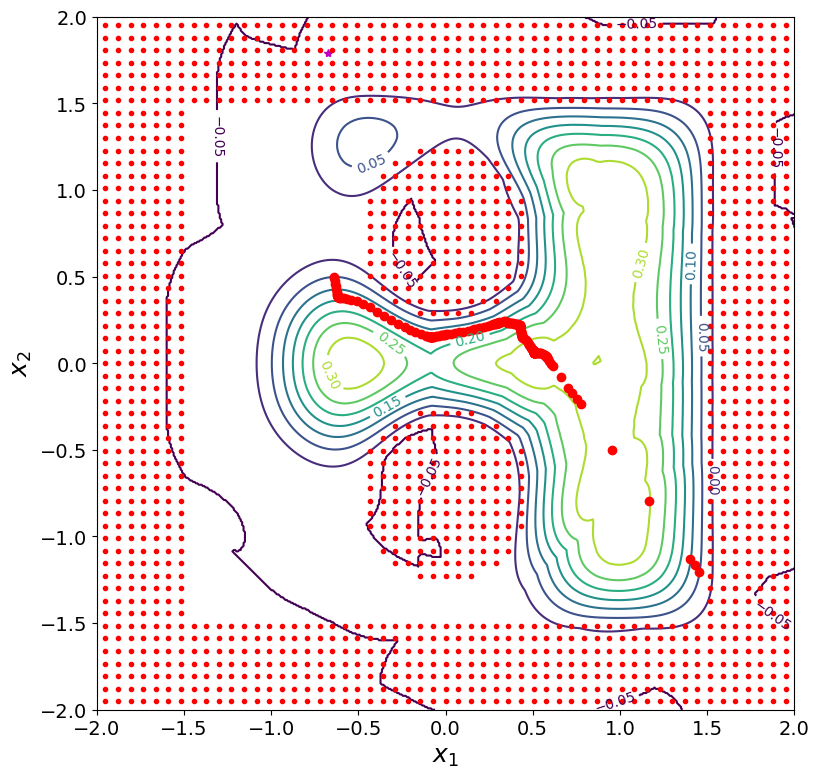

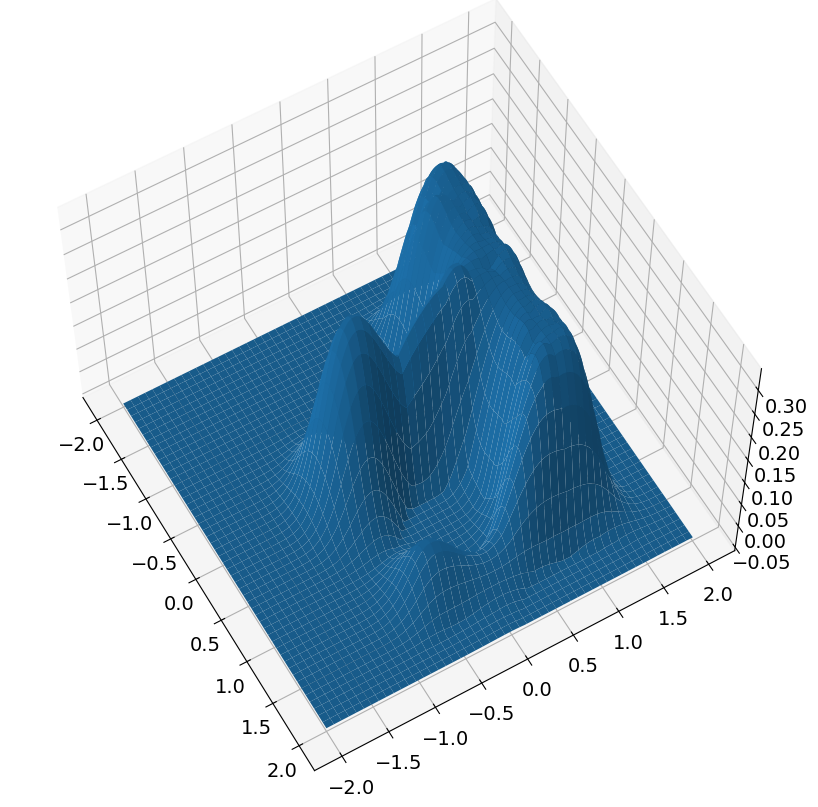

new position is [-0.63944154  0.49799098]
h is now 0.05
new time is 500
dx: 2.698621742956151


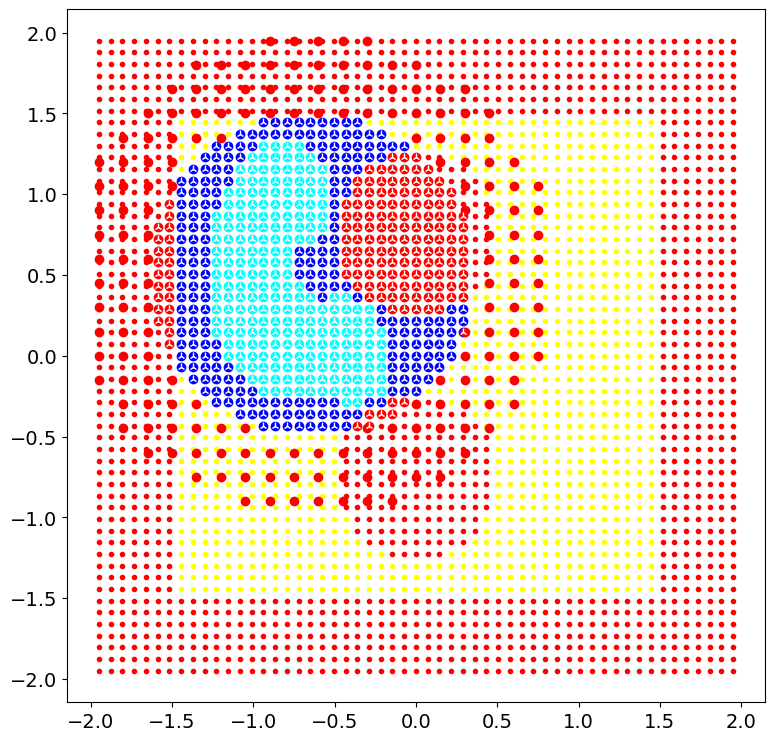

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          599     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32033D+06    |proj g|=  1.12673D+02


 This problem is unconstrained.



At iterate   50    f=  8.25608D+02    |proj g|=  9.74697D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  599     98    155      1     0     0   6.683D-01   8.255D+02
  F =   825.54240617349240     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(599, 2)
numc 599
cmax before 608
numc <= self.cmax
Cnew shape before (599, 2)
Cnew shape after (599, 2)
theta shape before (599,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608

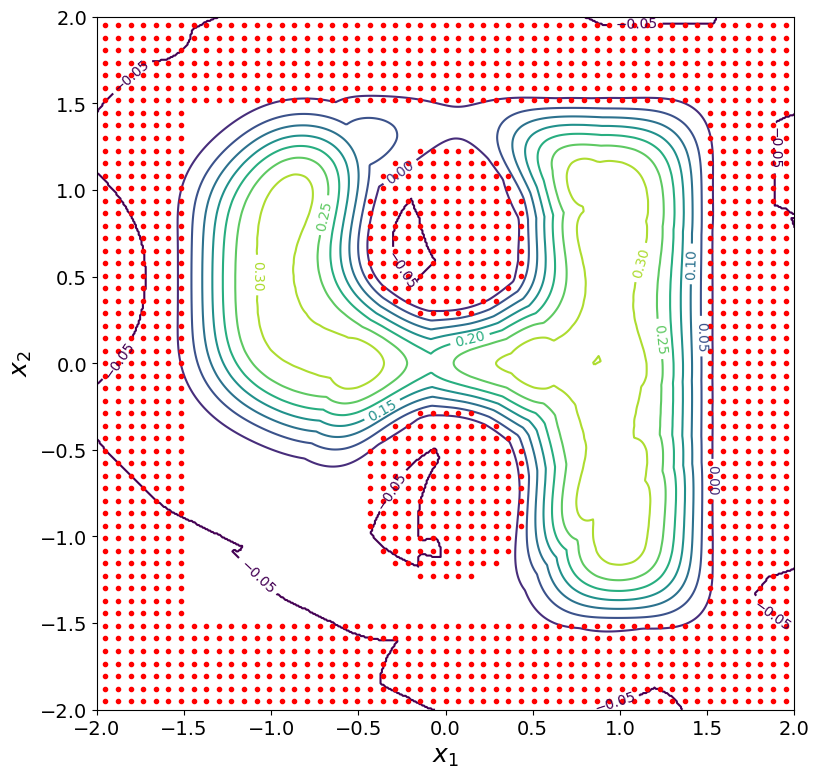

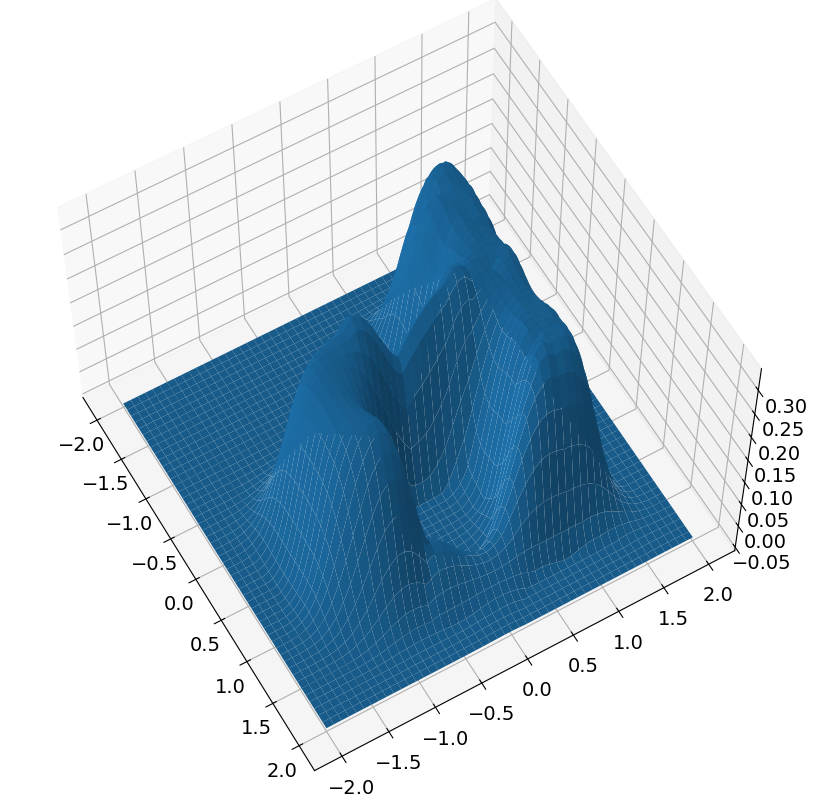

target: [-0.53633919  1.606416  ]
target in goto [-0.53633919  1.606416  ]
position is [-0.63944154  0.49799098]
h is 0.20039024486821028
start time is 500


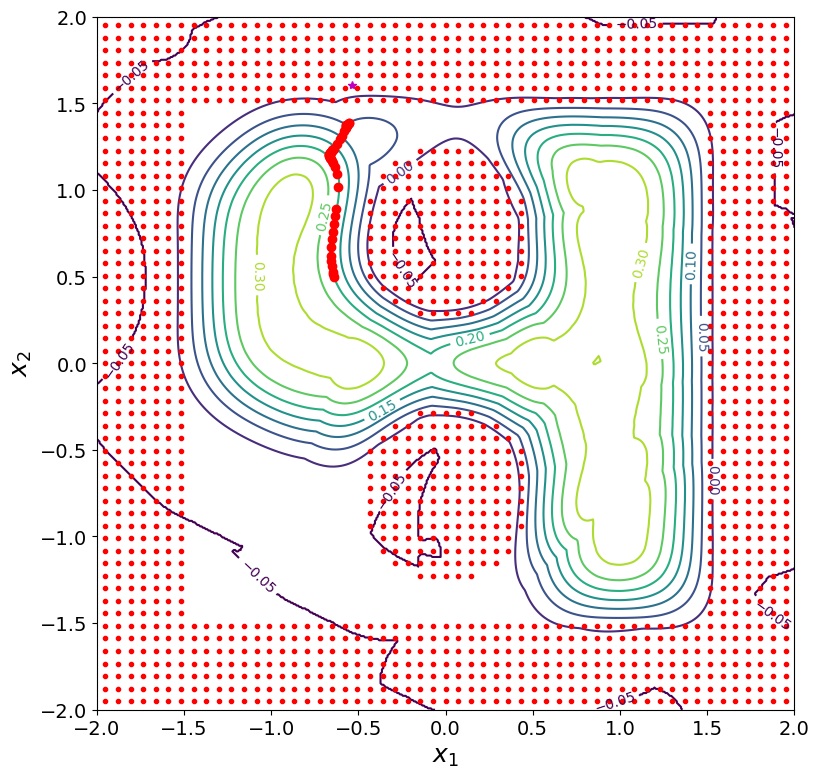

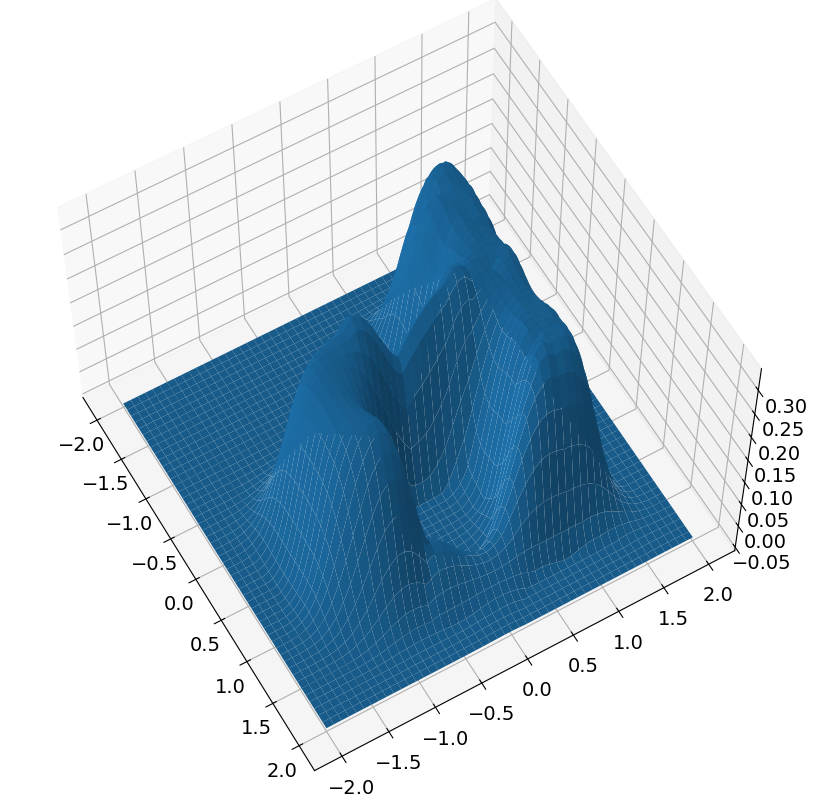

new position is [-0.55328213  1.38729963]
h is now 0.04999999999999995
new time is 550
dx: 0.8934726154619912


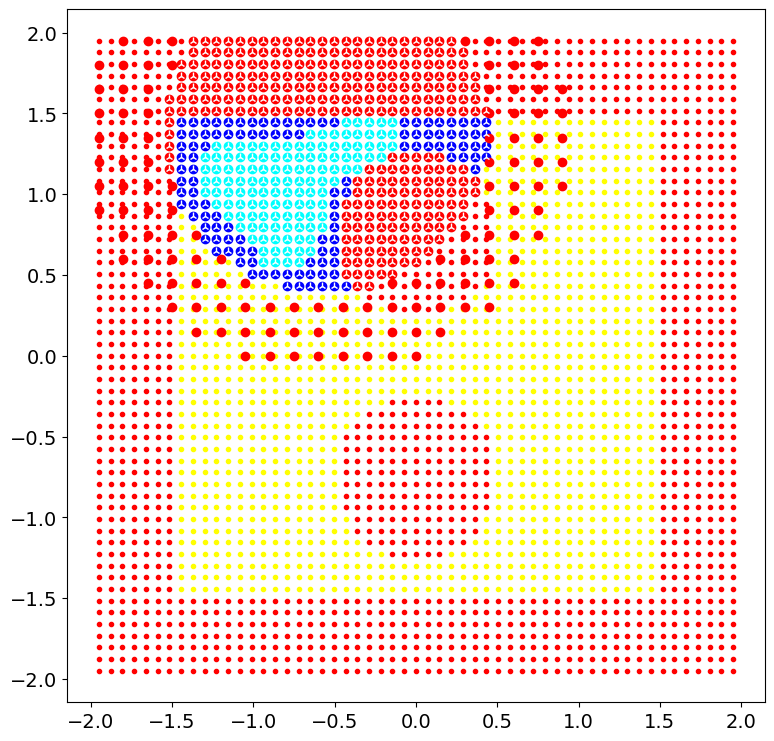

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          518     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.10125D+06    |proj g|=  1.13874D+02


 This problem is unconstrained.



At iterate   50    f=  5.93243D+02    |proj g|=  1.09450D+00

At iterate  100    f=  5.93047D+02    |proj g|=  1.20530D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  518    122    204      1     0     0   8.995D-01   5.930D+02
  F =   593.03084182572911     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(518, 2)
numc 518
cmax before 608
numc <= self.cmax
Cnew shape before (518, 2)
Cnew shape after (518, 2)
theta shape before (518,)
theta_shape after (608,)
cmax after 608
centers

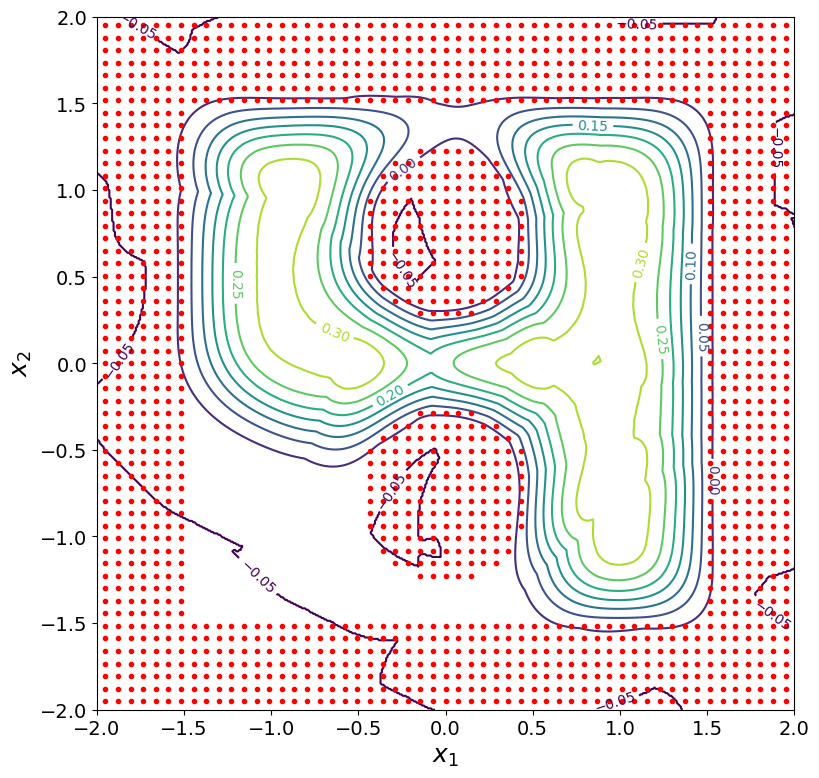

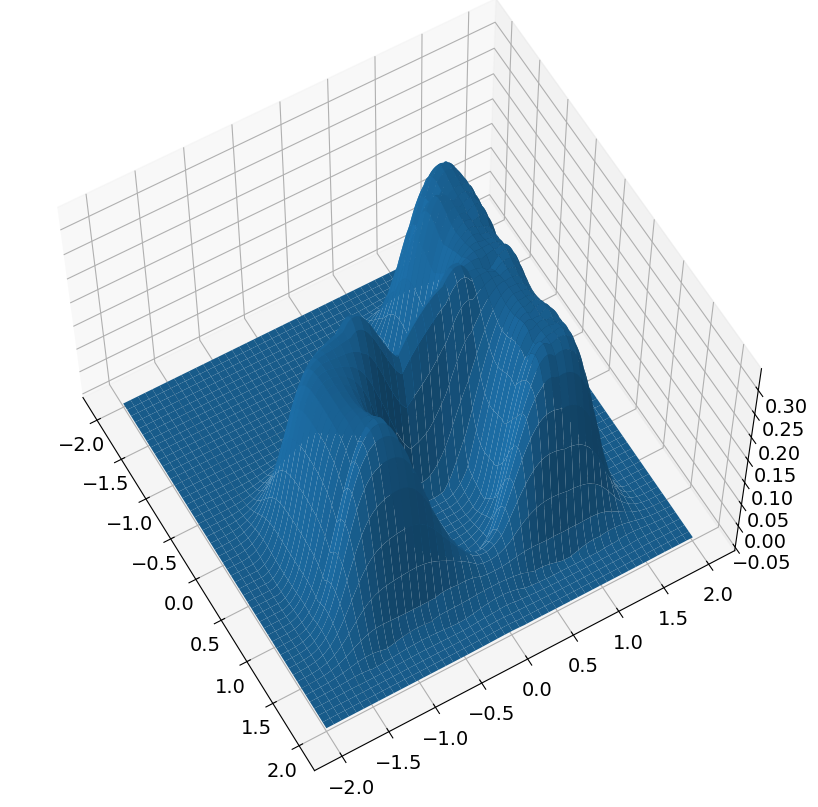

target: [-1.92391169 -1.37177856]
target in goto [-1.92391169 -1.37177856]
position is [-0.55328213  1.38729963]
h is 0.12093197264911092
start time is 550


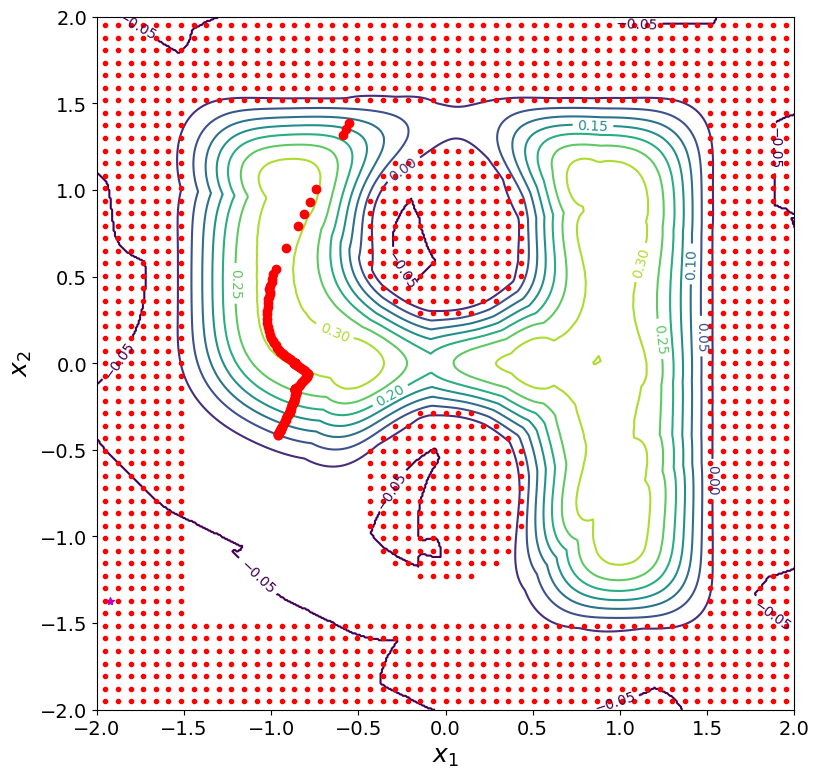

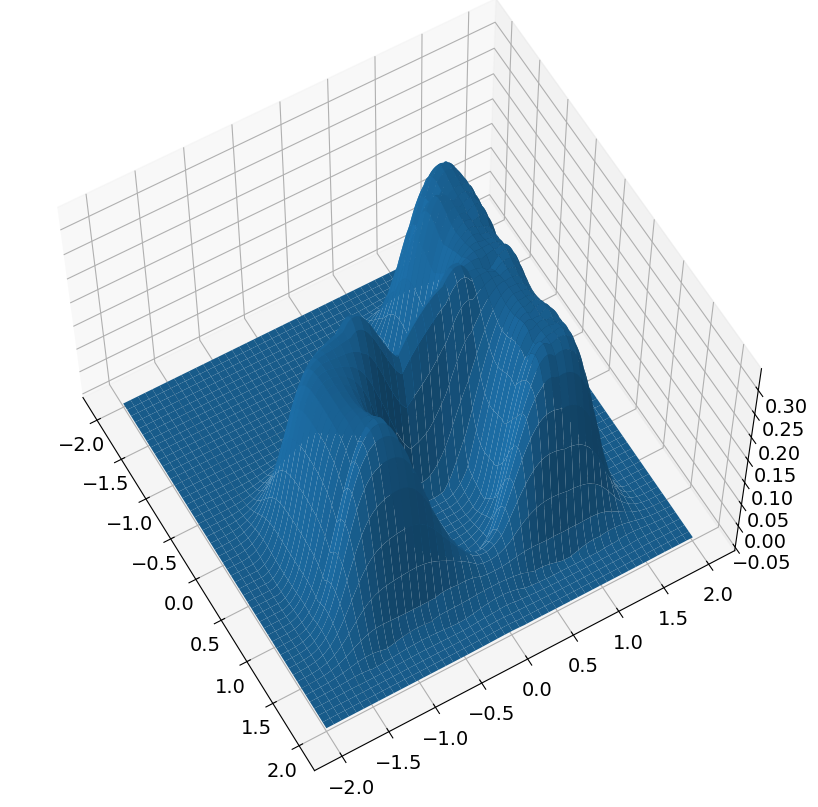

new position is [-0.96072326 -0.41356735]
h is now 0.05
new time is 600
dx: 1.8463829942085752


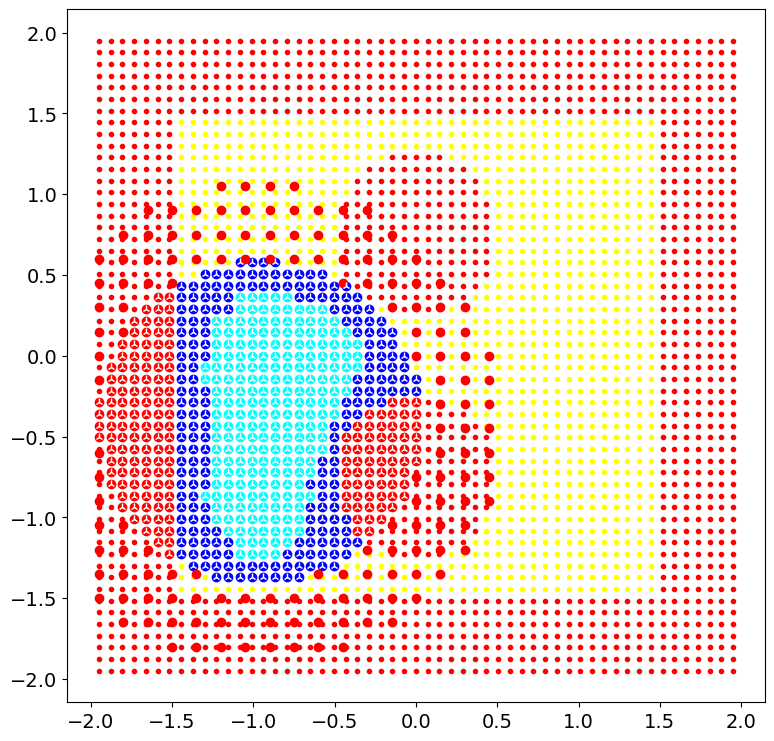

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          606     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31535D+06    |proj g|=  1.19205D+02


 This problem is unconstrained.



At iterate   50    f=  7.62127D+02    |proj g|=  9.92109D-01

At iterate  100    f=  7.61894D+02    |proj g|=  1.00076D+00

At iterate  150    f=  7.61839D+02    |proj g|=  1.77198D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  606    189    285      1     0     0   7.164D-01   7.618D+02
  F =   761.82376067999644     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(606, 2)
numc 606
cmax before 608
numc <= self.cmax
Cnew shape before (606, 2)
Cnew shape after (606, 2)
th

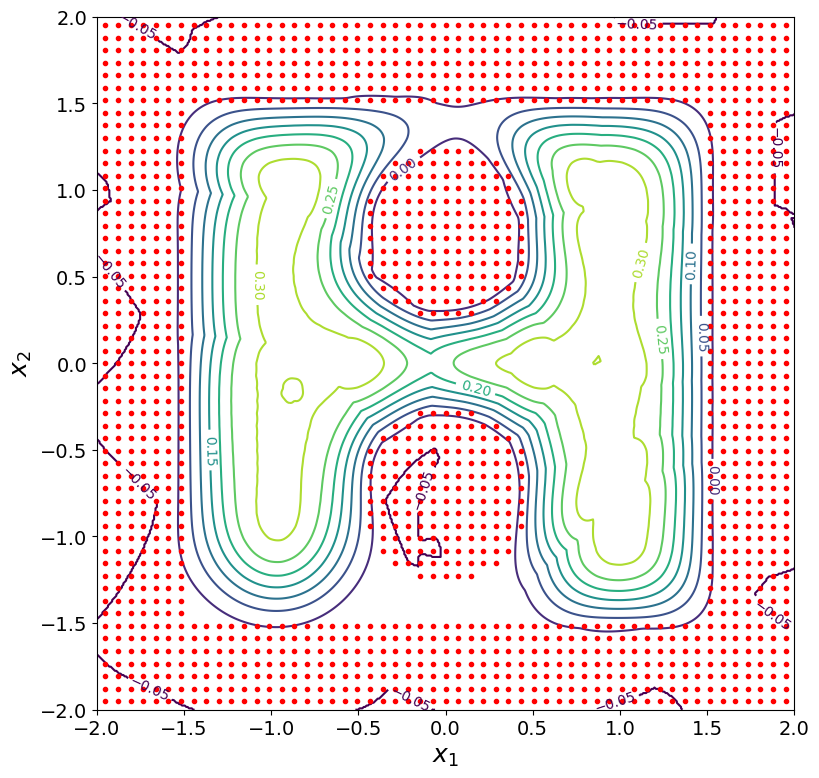

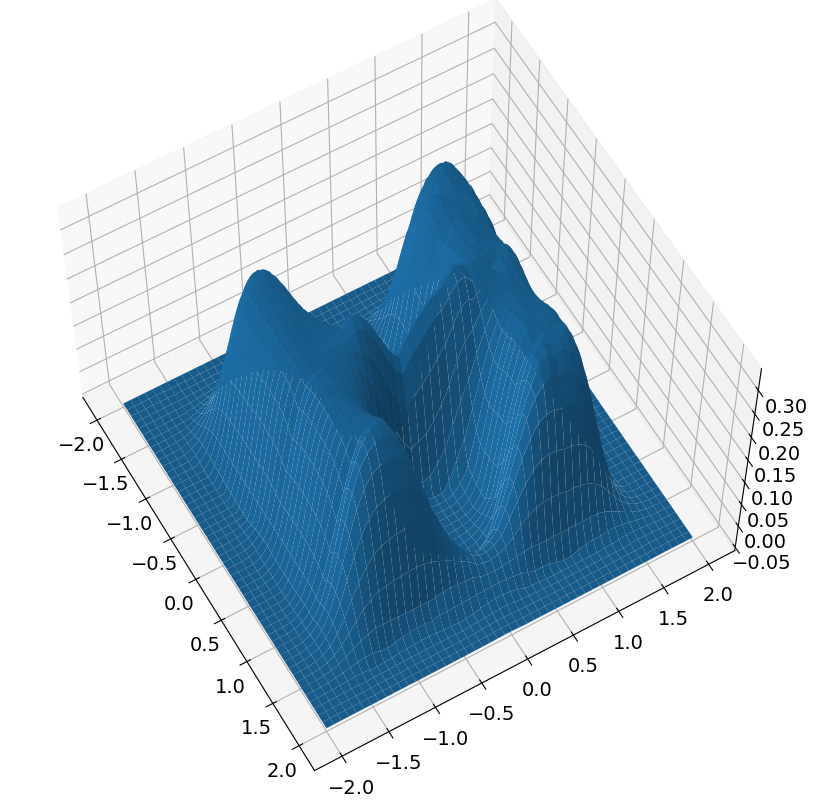

target: [-1.56393707 -1.24421006]
target in goto [-1.56393707 -1.24421006]
position is [-0.96072326 -0.41356735]
h is 0.30650674873559364
start time is 600


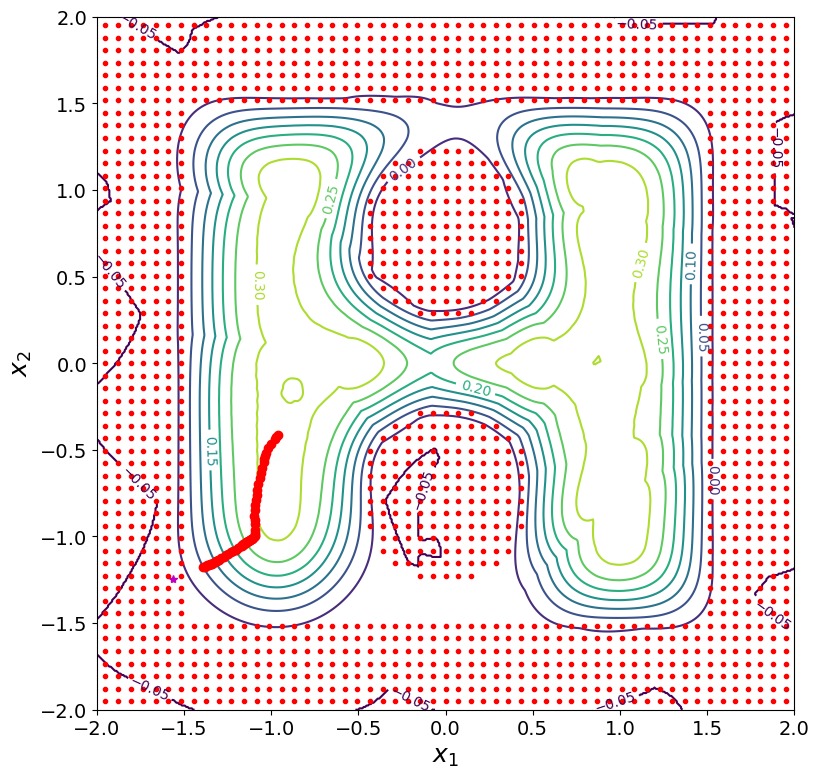

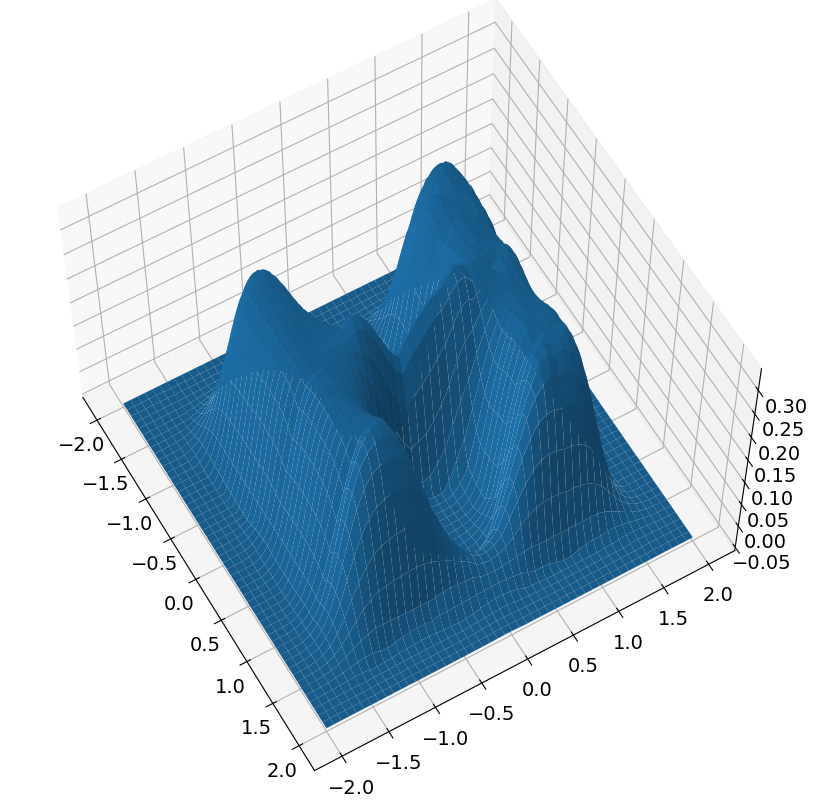

new position is [-1.38801421 -1.17907494]
h is now 0.049999999999999975
new time is 650
dx: 0.8766866099238048


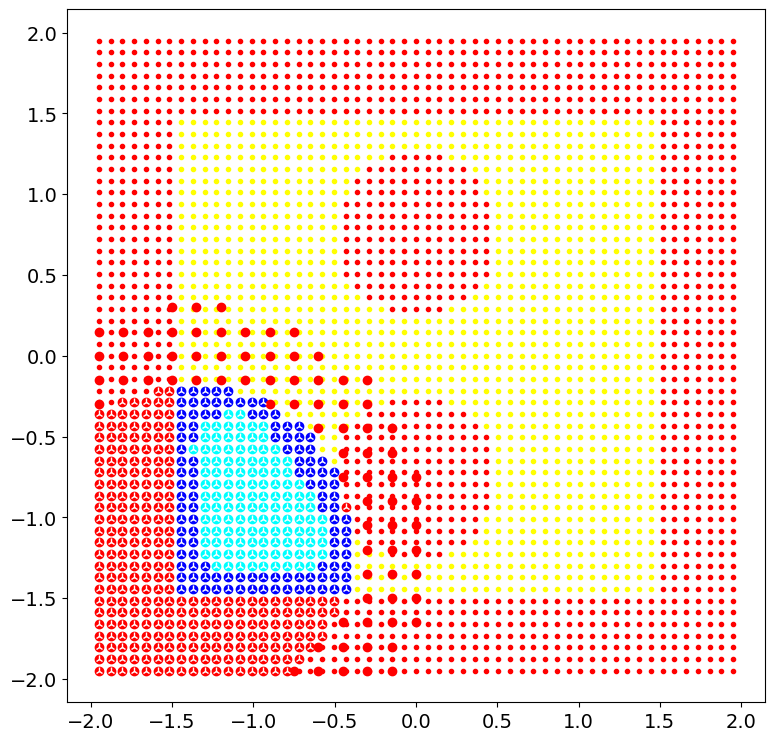

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          487     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.04373D+06    |proj g|=  1.14870D+02


 This problem is unconstrained.



At iterate   50    f=  4.90501D+02    |proj g|=  1.51626D+00

At iterate  100    f=  4.90382D+02    |proj g|=  1.15874D+00



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  487    115    235      2     0     0   5.495D-01   4.904D+02
  F =   490.38026453955376     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(487, 2)
numc 487
cmax before 608
numc <= self.cmax
Cnew shape before (487, 2)
Cnew shape after (487, 2)
theta shape before (487,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(60

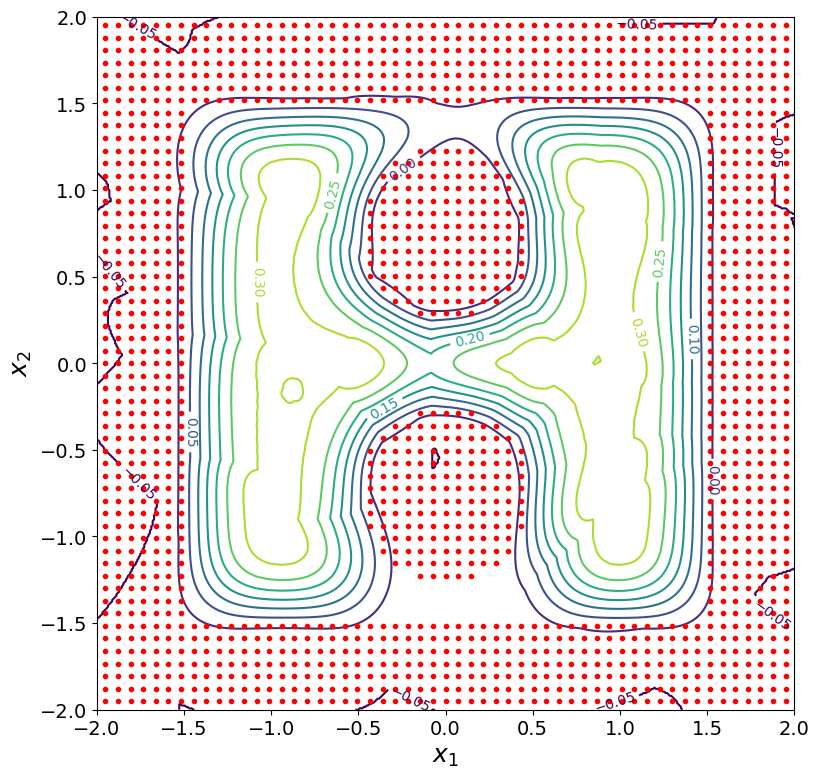

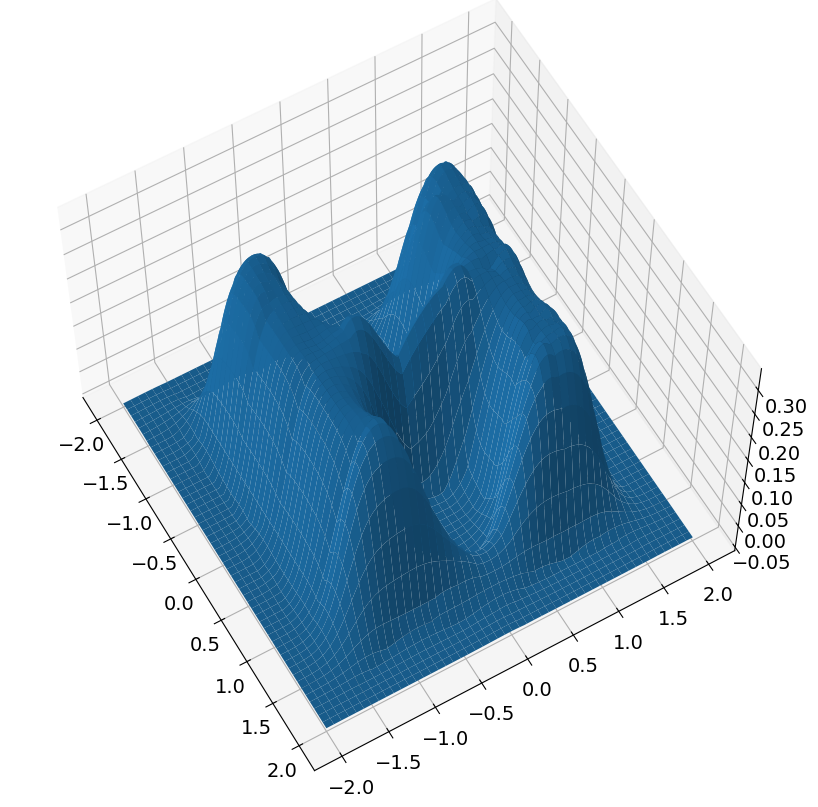

target: [ 1.92504033 -1.88245536]
target in goto [ 1.92504033 -1.88245536]
position is [-1.38801421 -1.17907494]
h is 0.1053028780668845
start time is 650


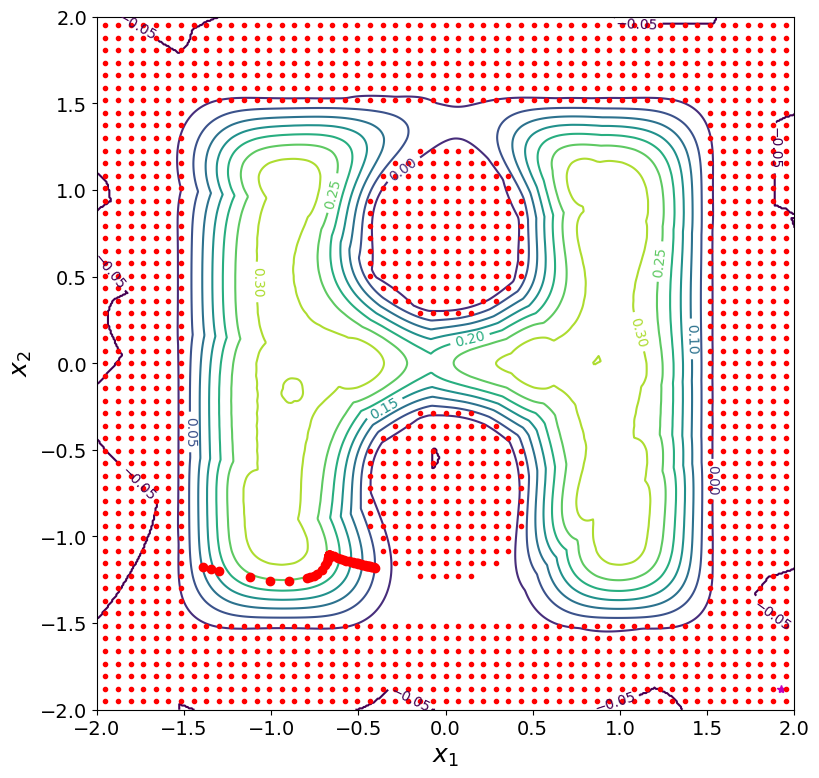

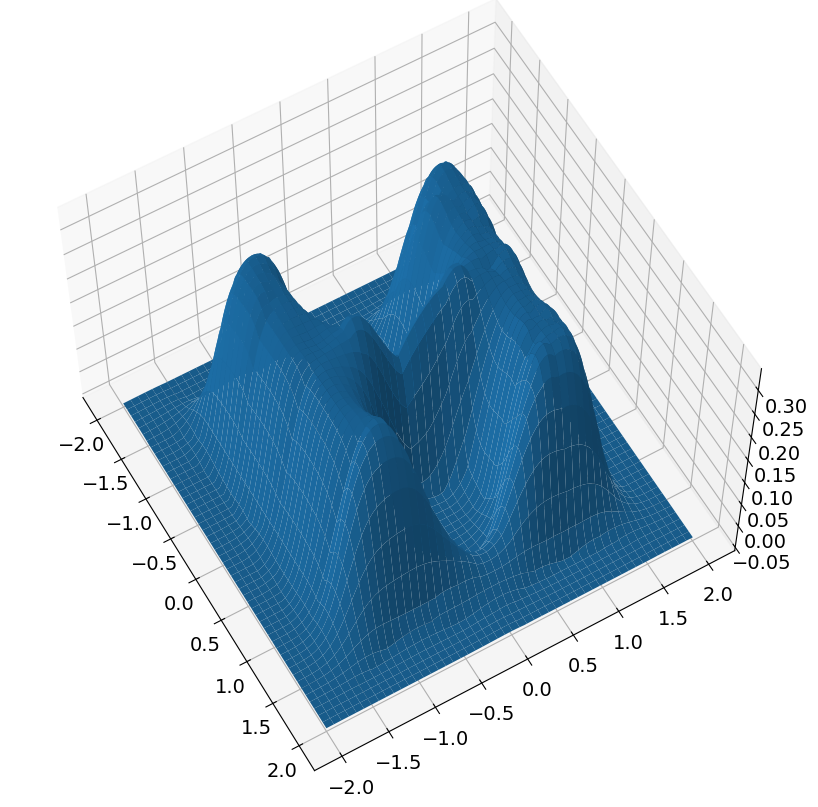

new position is [-0.40574229 -1.18095991]
h is now 0.049999999999999975
new time is 700
dx: 0.982273725647622


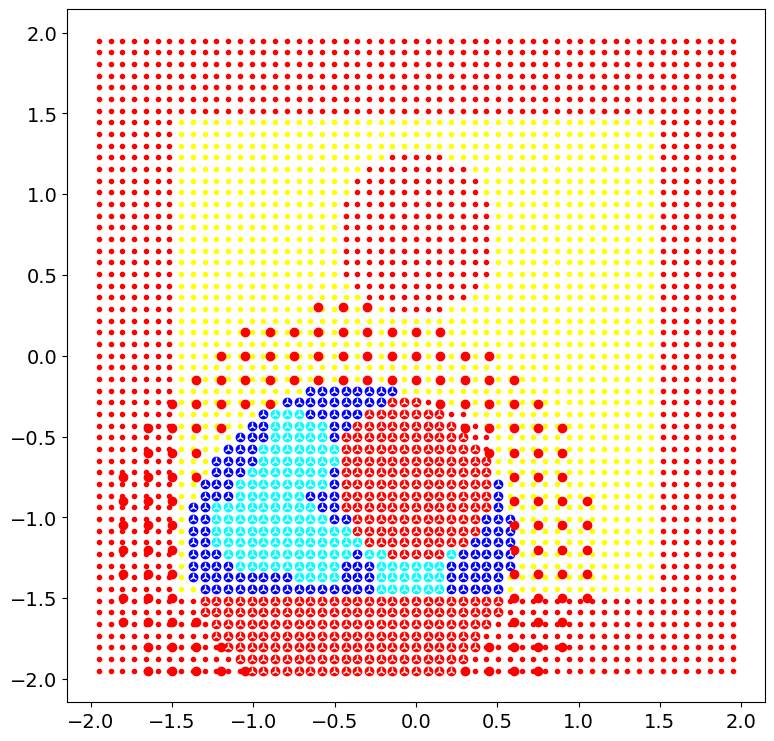

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          575     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22871D+06    |proj g|=  1.12742D+02


 This problem is unconstrained.



At iterate   50    f=  6.82551D+02    |proj g|=  1.30266D+00

At iterate  100    f=  6.82415D+02    |proj g|=  9.43844D-01

At iterate  150    f=  6.82382D+02    |proj g|=  9.25594D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  575    168    265      1     0     0   1.064D+00   6.824D+02
  F =   682.36592195907326     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(575, 2)
numc 575
cmax before 608
numc <= self.cmax
Cnew shape before (575, 2)
Cnew shape

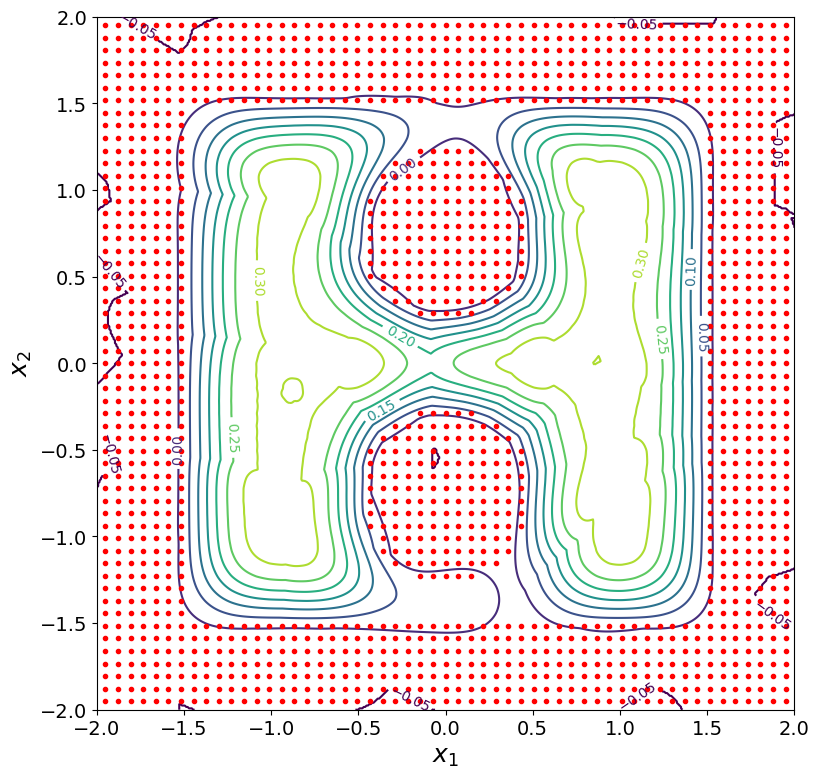

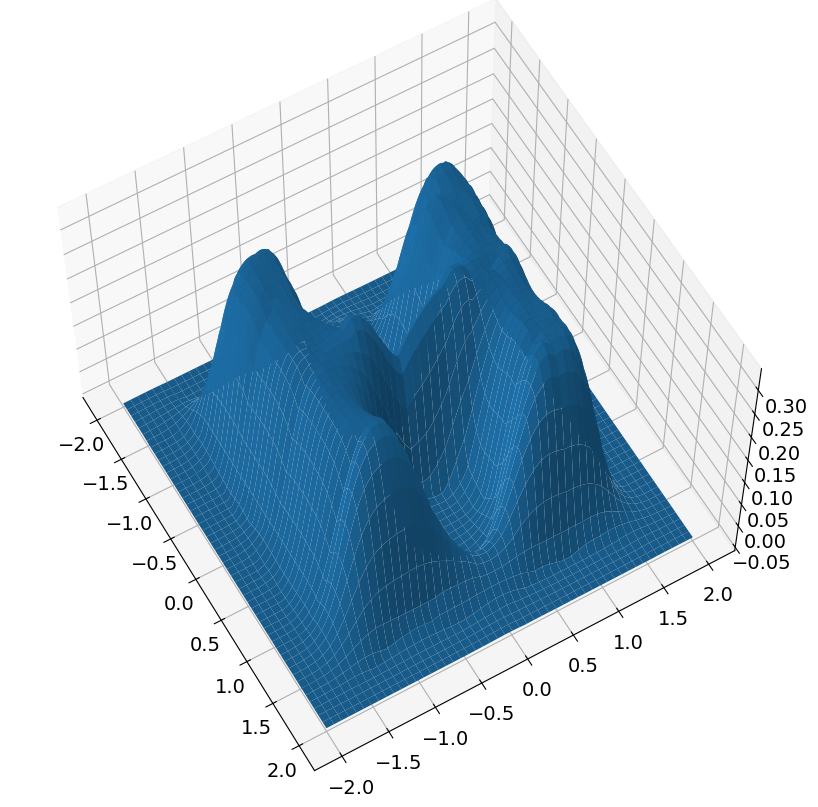

target: [ 1.9297868  -1.65075896]
target in goto [ 1.9297868  -1.65075896]
position is [-0.40574229 -1.18095991]
h is 0.08371513367113835
start time is 700


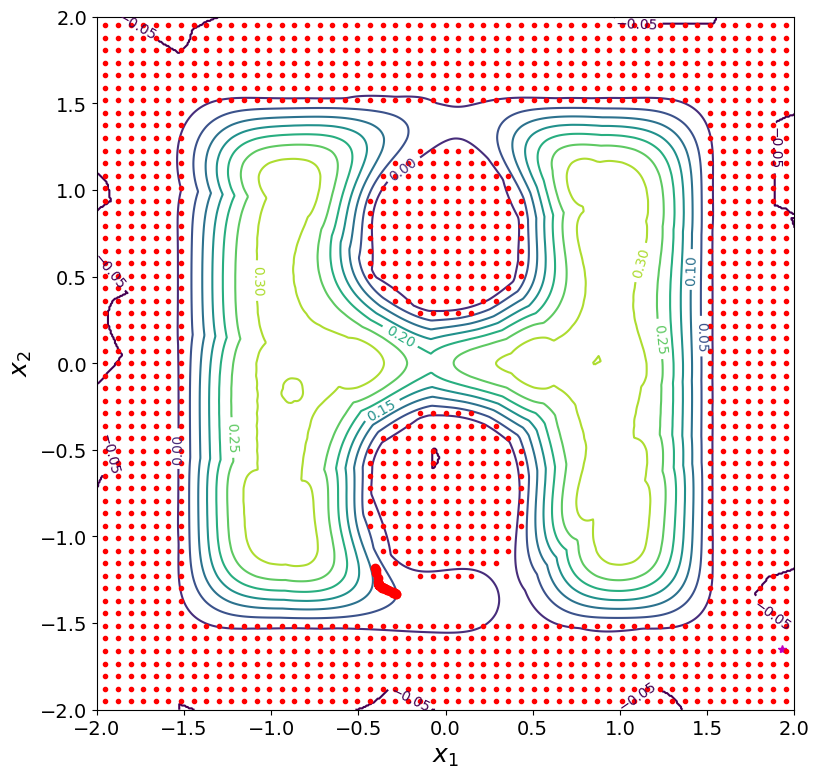

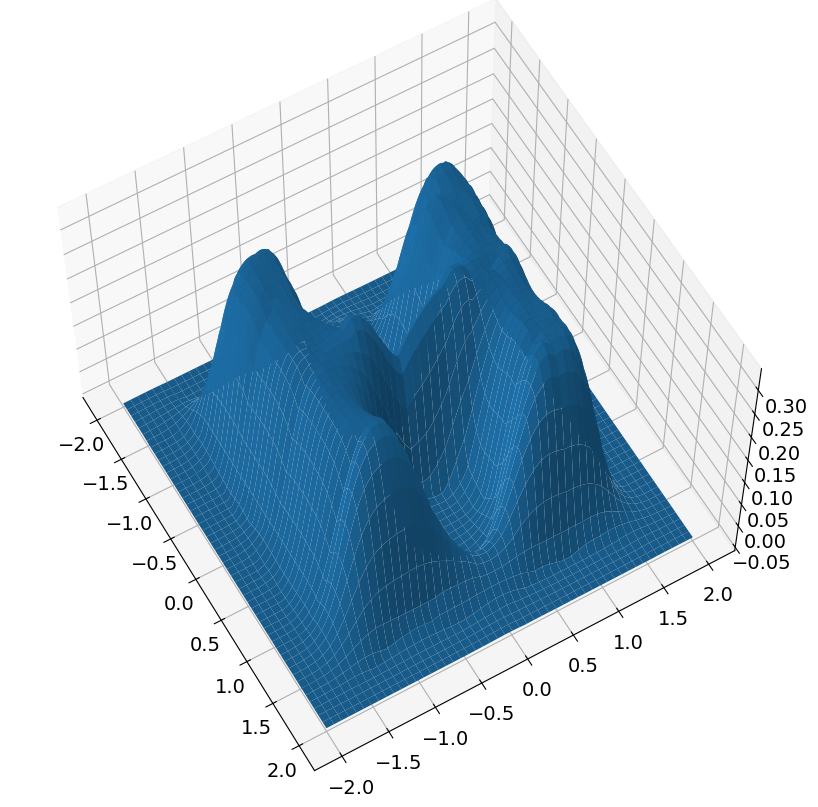

new position is [-0.28180404 -1.33272934]
h is now 0.05
new time is 750
dx: 0.19594552406336355


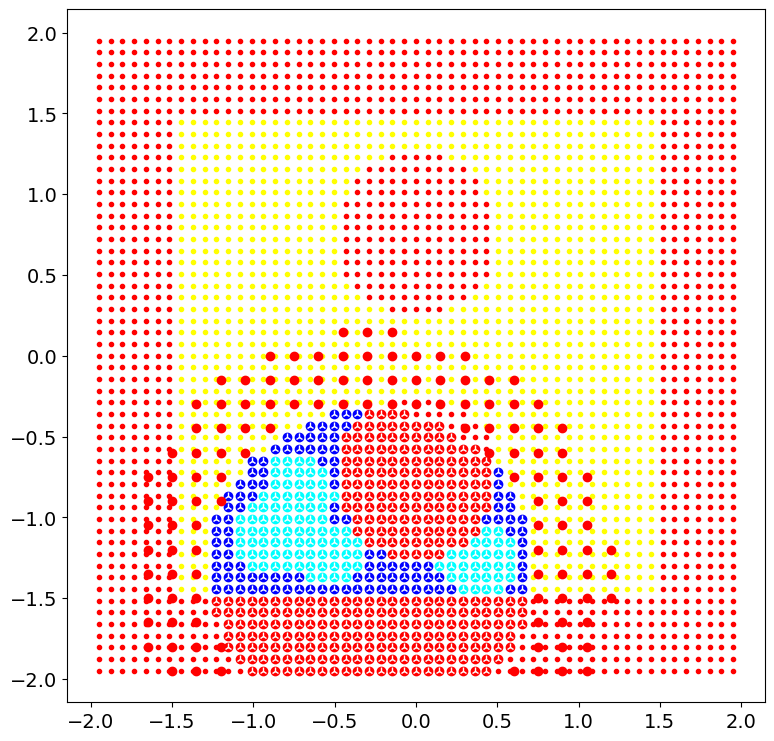

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          531     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.12078D+06    |proj g|=  1.10101D+02


 This problem is unconstrained.



At iterate   50    f=  6.25200D+02    |proj g|=  8.21648D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  531     96    162      1     0     0   7.282D-01   6.252D+02
  F =   625.15029225149488     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(531, 2)
numc 531
cmax before 608
numc <= self.cmax
Cnew shape before (531, 2)
Cnew shape after (531, 2)
theta shape before (531,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608

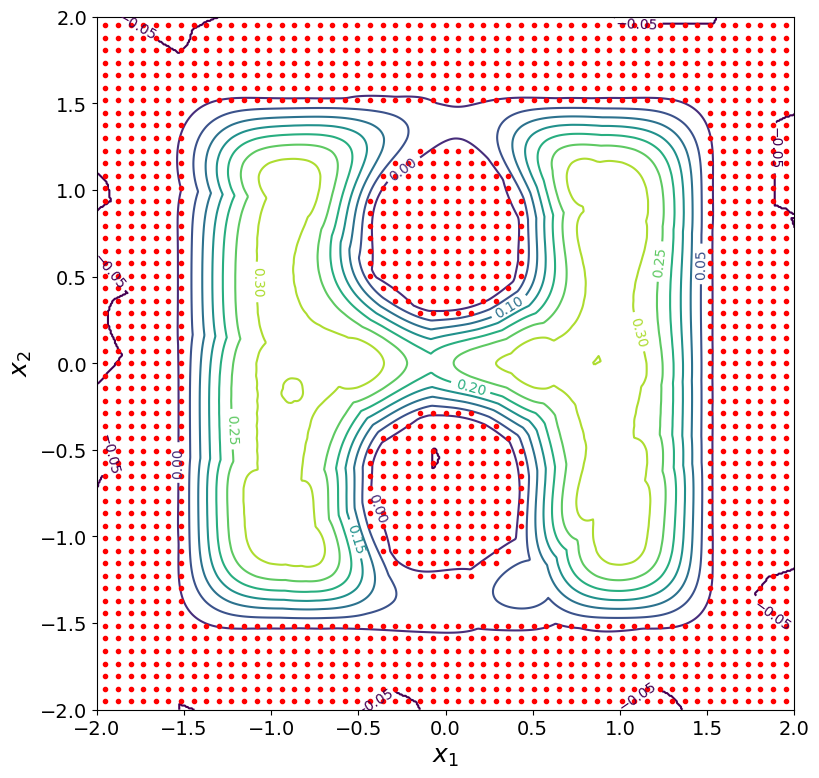

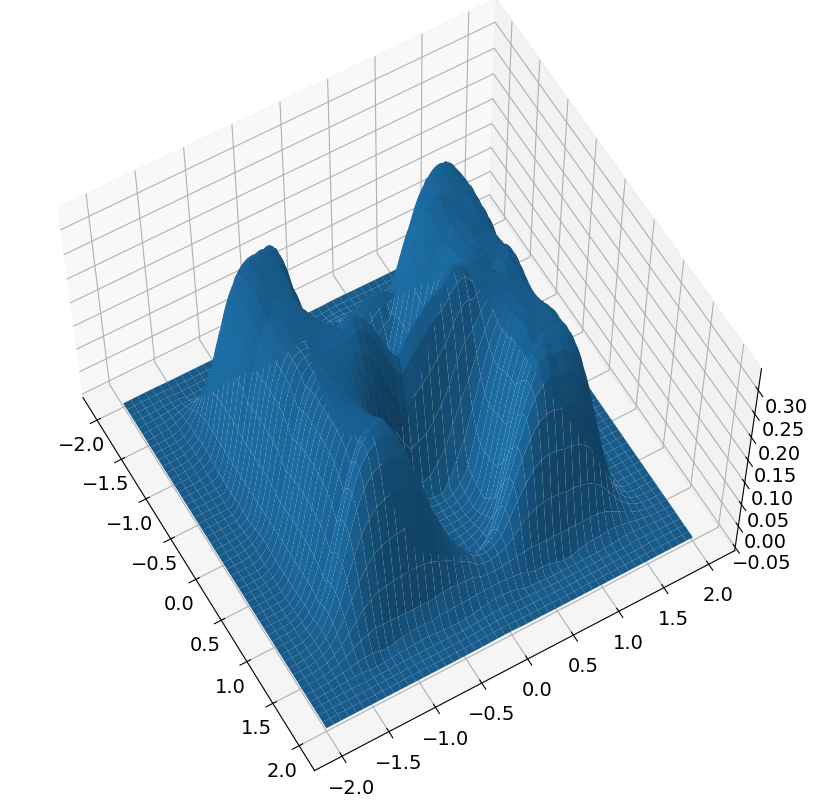

target: [-1.74039994 -1.21798032]
target in goto [-1.74039994 -1.21798032]
position is [-0.28180404 -1.33272934]
h is 0.05
start time is 750


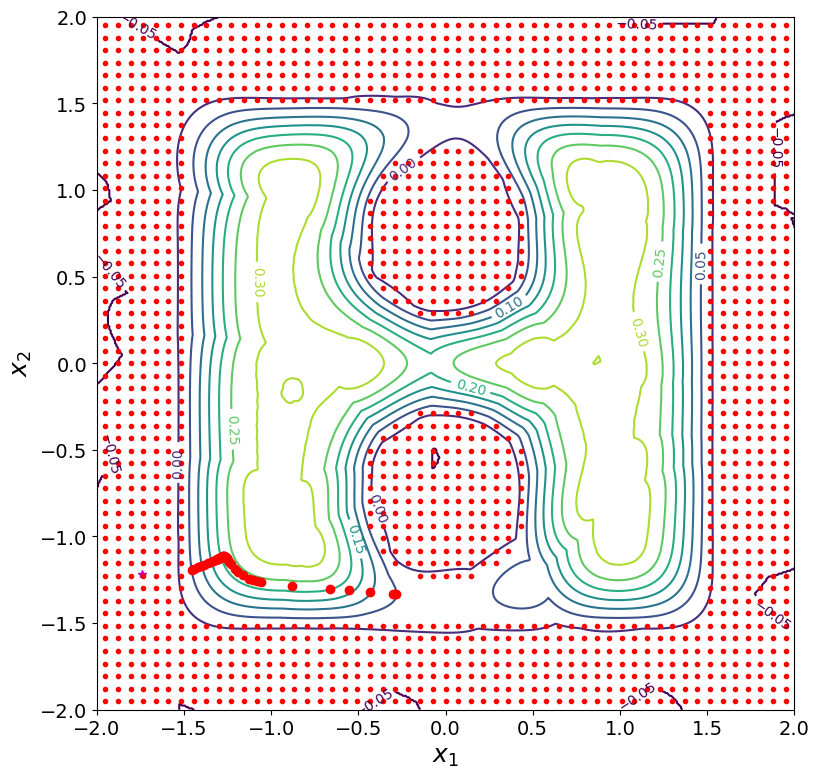

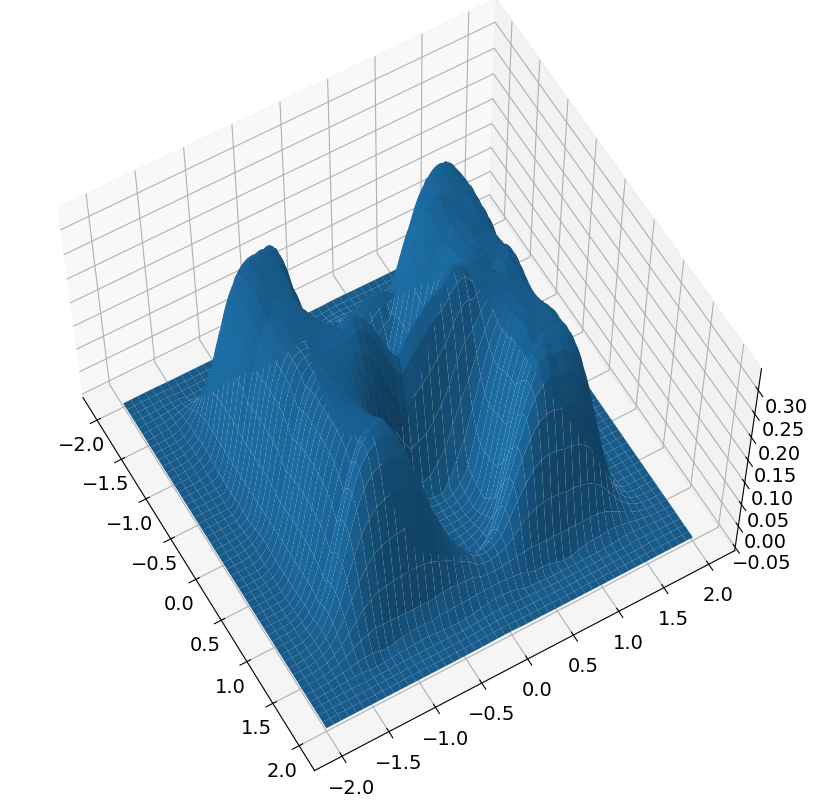

new position is [-1.45639866 -1.191268  ]
h is now 0.04999999999999995
new time is 800
dx: 1.1830823466003242


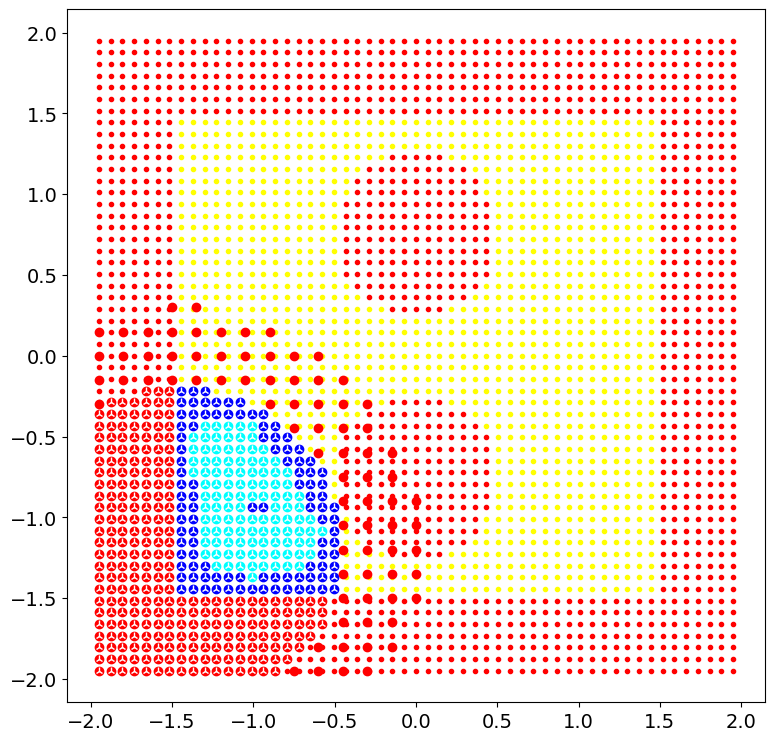

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          461     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.79690D+05    |proj g|=  1.11873D+02


 This problem is unconstrained.



At iterate   50    f=  4.69408D+02    |proj g|=  8.84569D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  461     66    122      1     0     0   3.993D-01   4.694D+02
  F =   469.37174898324690     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(461, 2)
numc 461
cmax before 608
numc <= self.cmax
Cnew shape before (461, 2)
Cnew shape after (461, 2)
theta shape before (461,)
theta_shape after (608,)
cmax after 608
centers shape after
(608

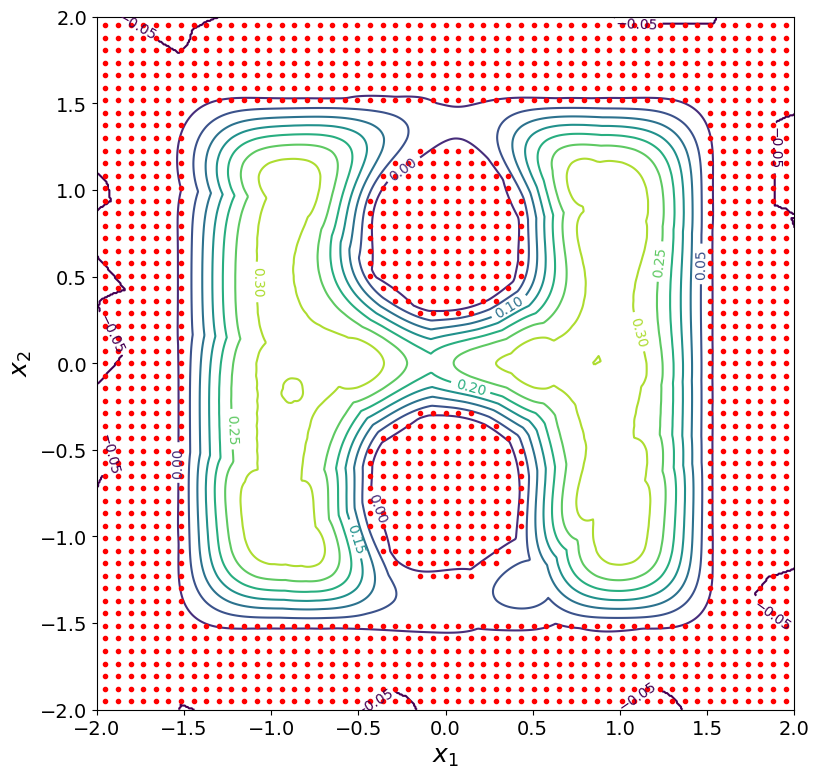

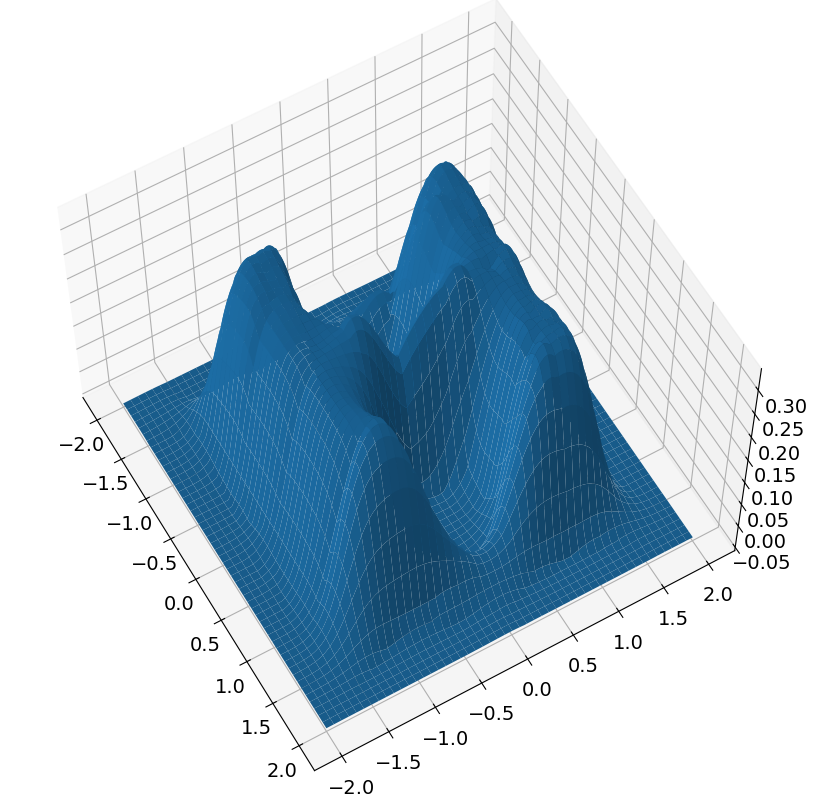

target: [-1.57676477  0.89919396]
target in goto [-1.57676477  0.89919396]
position is [-1.45639866 -1.191268  ]
h is 0.04999999999999995
start time is 800


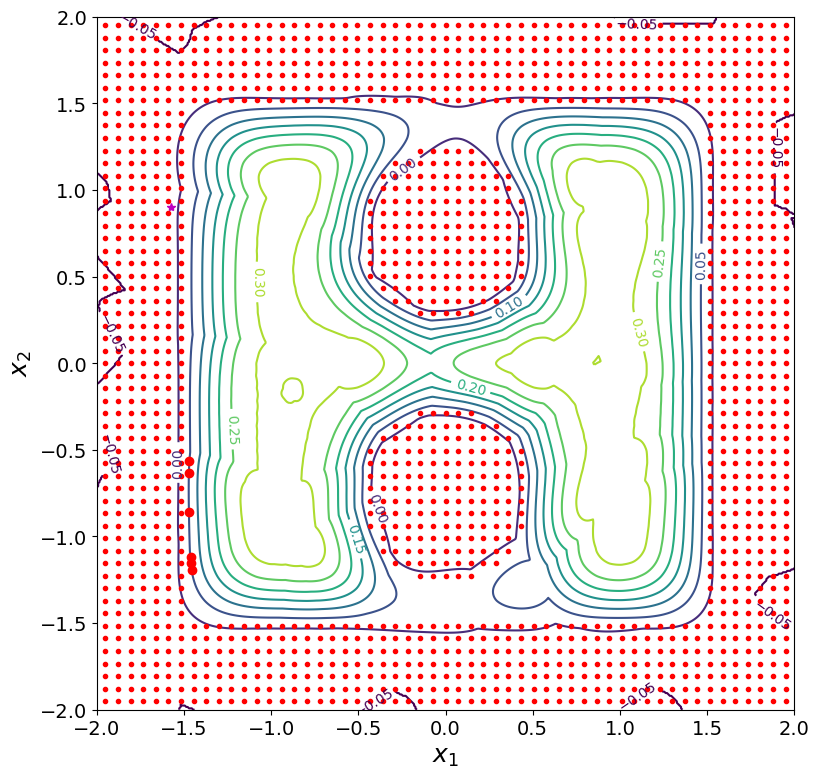

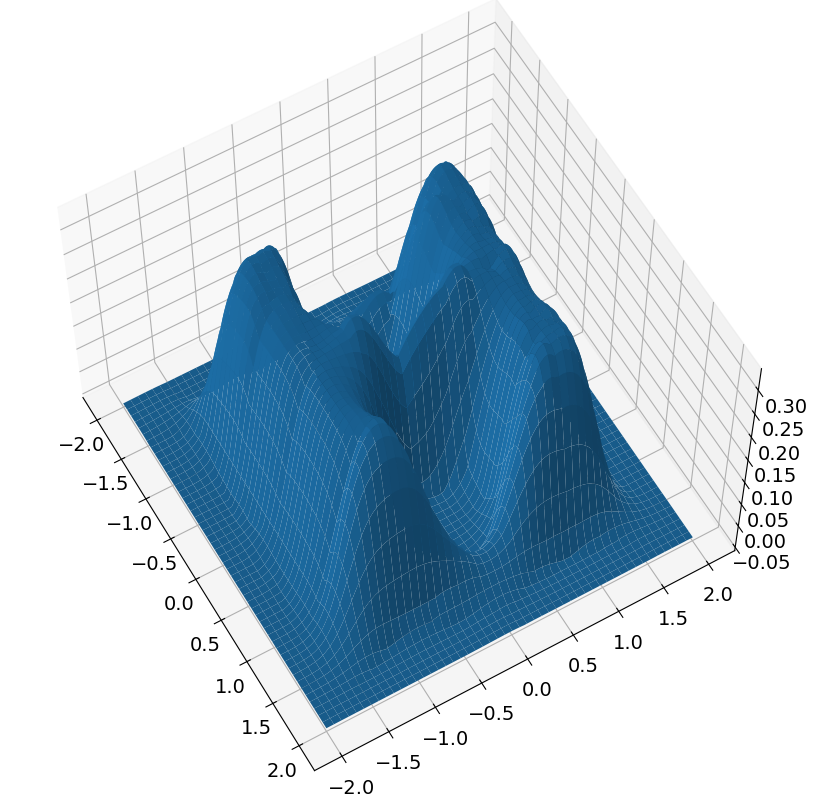

new position is [-1.46882097 -0.56493011]
h is now 0.05000000000000013
new time is 850
dx: 0.6264610669005403


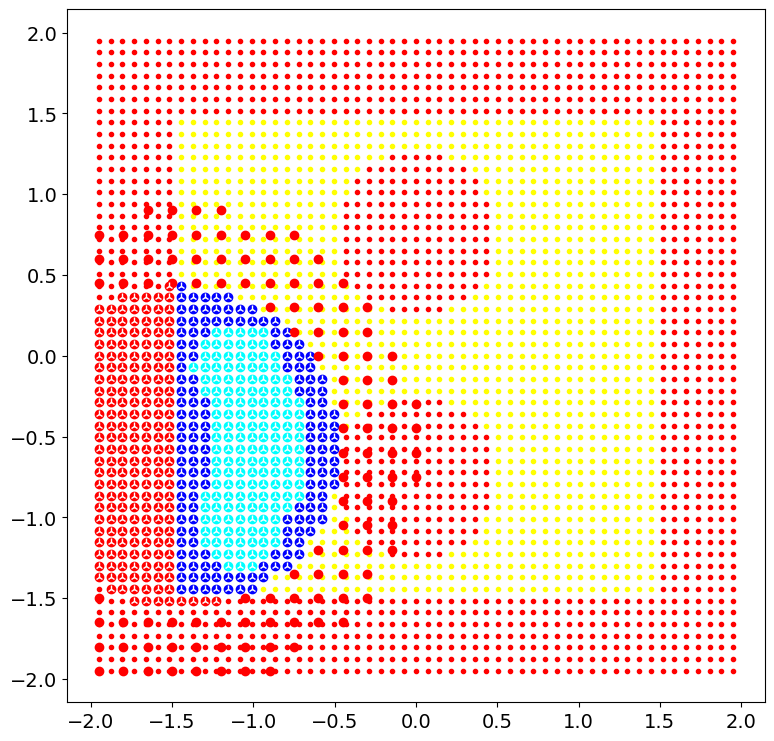

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          490     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05677D+06    |proj g|=  1.14541D+02


 This problem is unconstrained.



At iterate   50    f=  5.89303D+02    |proj g|=  9.01644D-01

At iterate  100    f=  5.89183D+02    |proj g|=  8.18827D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  490    141    220      1     0     0   6.118D-01   5.892D+02
  F =   589.17449050483140     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(490, 2)
numc 490
cmax before 608
numc <= self.cmax
Cnew shape before (490, 2)
Cnew shape after (490, 2)
theta shape before 

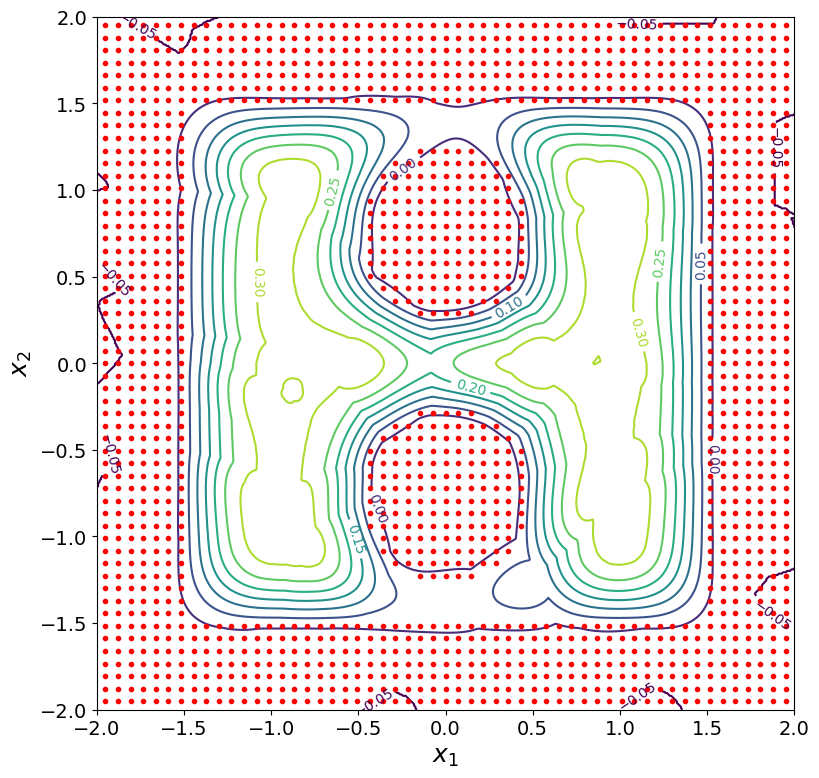

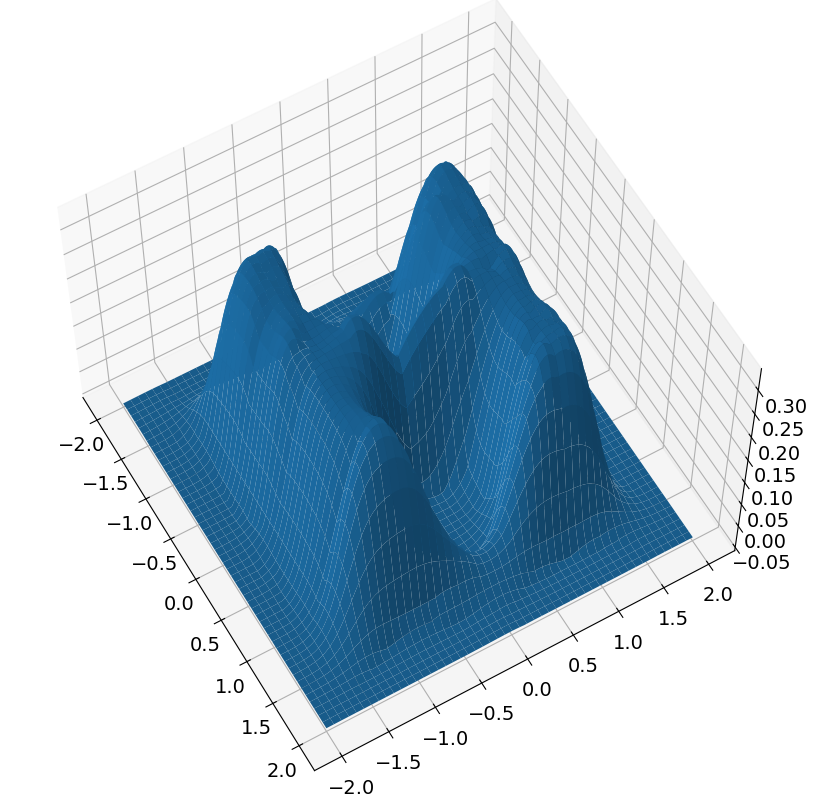

target: [-1.01565144  1.74837101]
target in goto [-1.01565144  1.74837101]
position is [-1.46882097 -0.56493011]
h is 0.05000000000000013
start time is 850


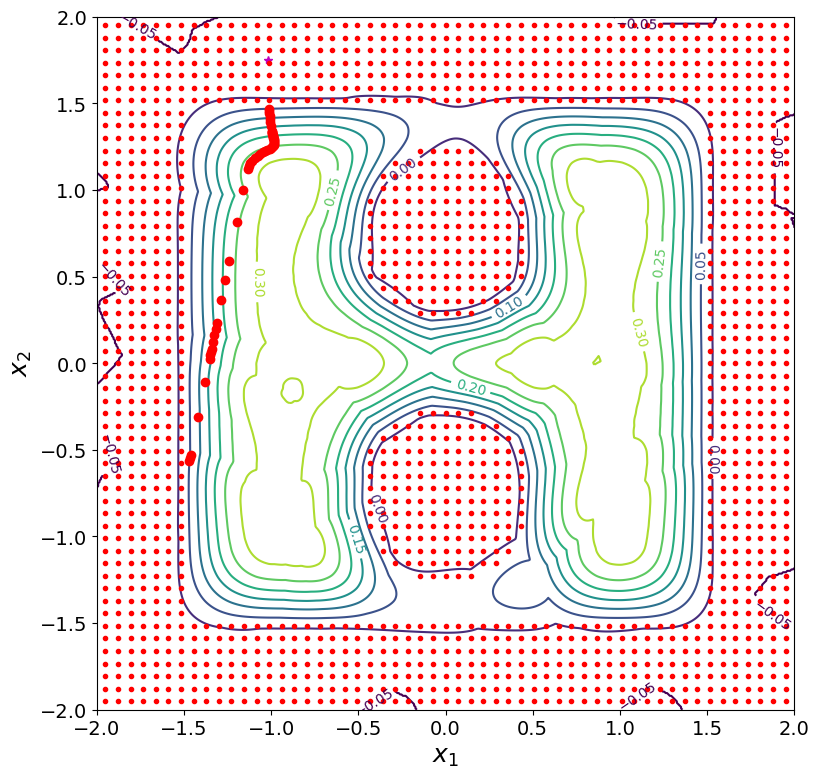

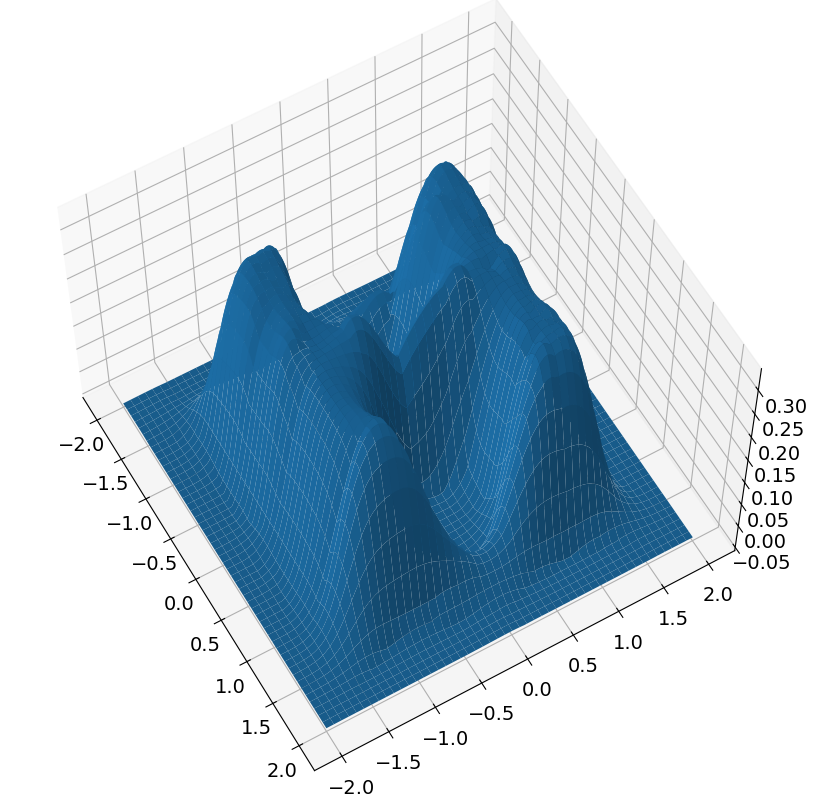

new position is [-1.01234311  1.46881542]
h is now 0.05000000000000006
new time is 900
dx: 2.0843447194678513


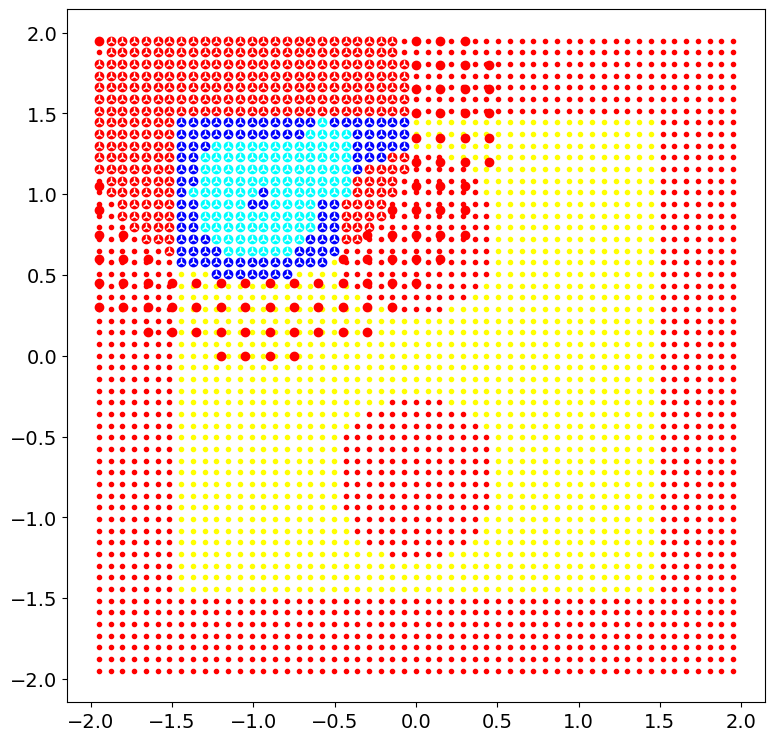

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          491     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.04234D+06    |proj g|=  1.11050D+02


 This problem is unconstrained.



At iterate   50    f=  5.03655D+02    |proj g|=  9.55145D-01

At iterate  100    f=  5.03537D+02    |proj g|=  8.67035D-01
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(491, 2)
numc 491
cmax before 608
numc <= self.cmax
Cnew shape before (491, 2)

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  491    106    167      1     0     0   8.668D-01   5.035D+02
  F =   503.53695633001945     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Cnew shape after (491, 2)
theta shap

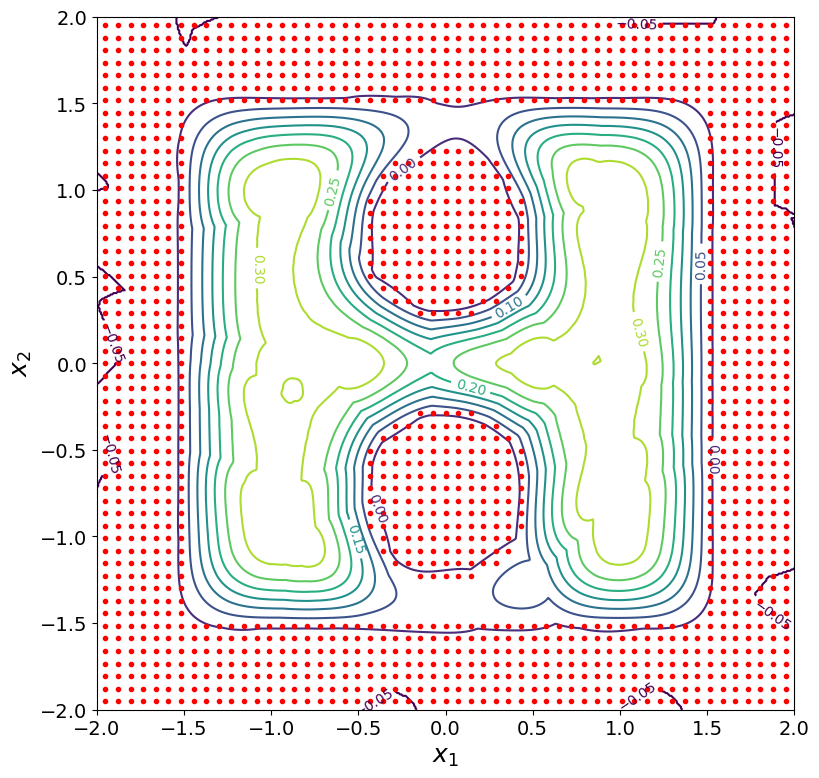

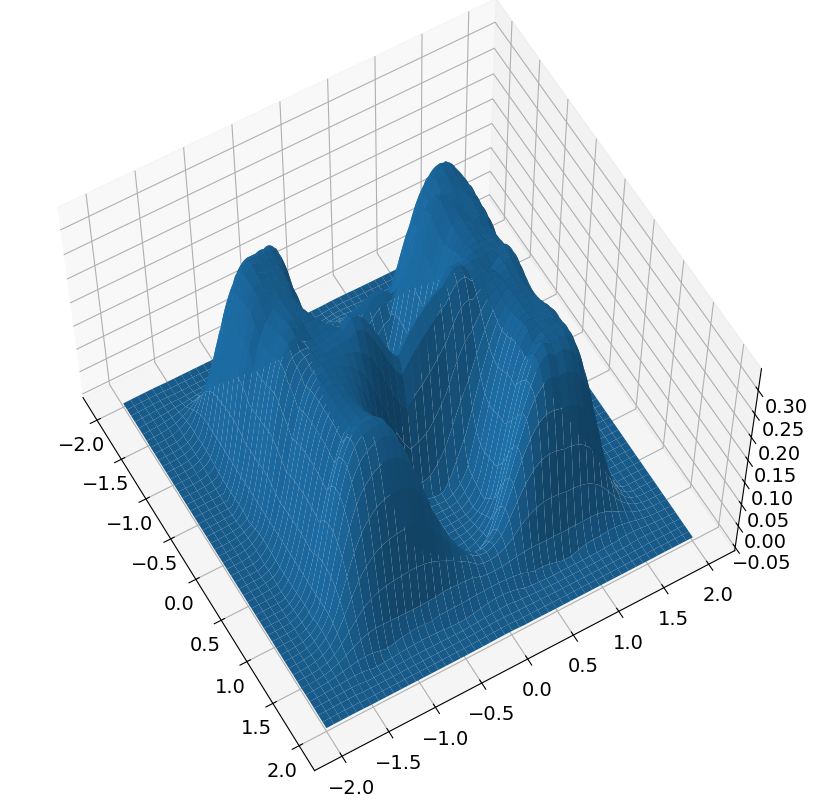

target: [ 1.74731135 -0.39348043]
target in goto [ 1.74731135 -0.39348043]
position is [-1.01234311  1.46881542]
h is 0.05000000000000006
start time is 900


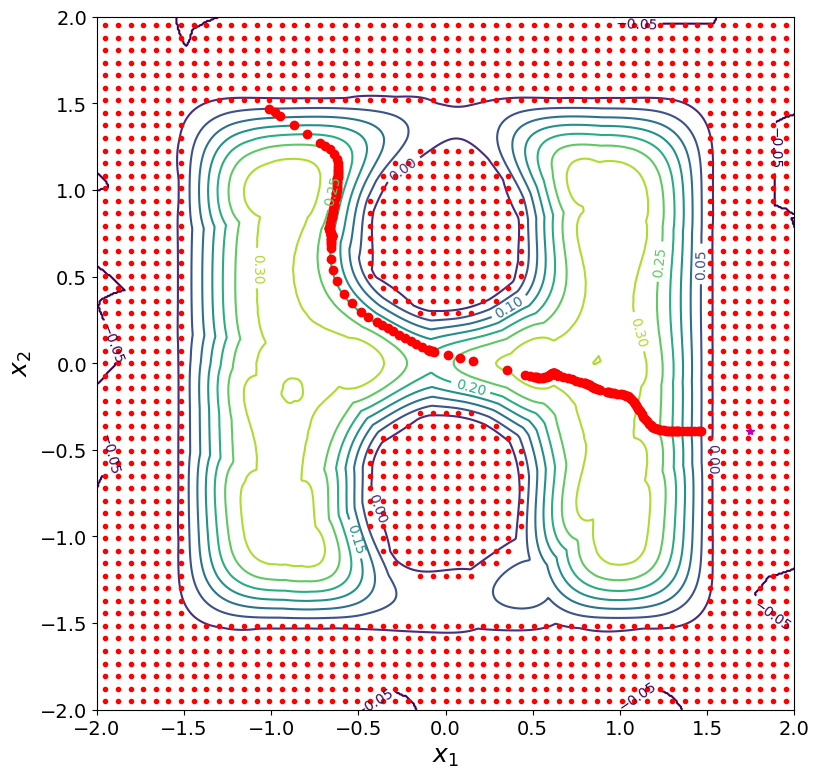

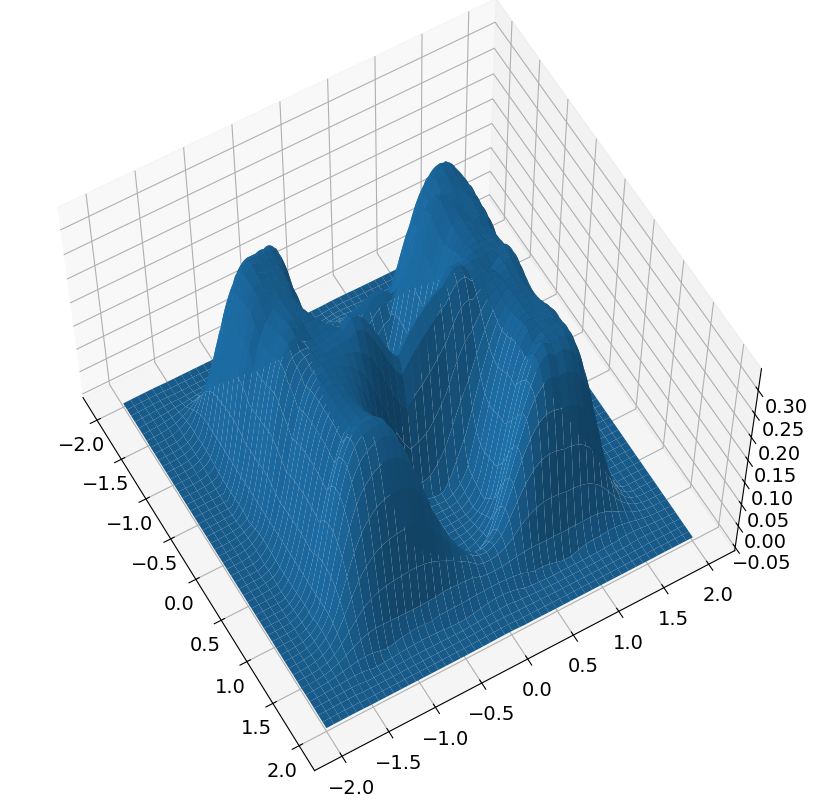

new position is [ 1.46722327 -0.39321499]
h is now 0.05000000000000006
new time is 950
dx: 3.1008719279211046


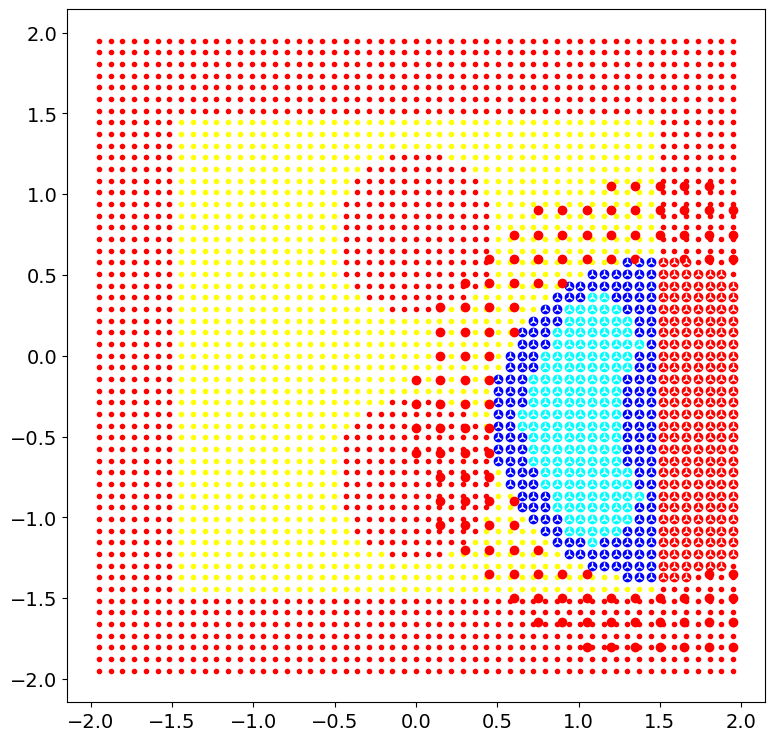

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          492     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05422D+06    |proj g|=  1.13837D+02


 This problem is unconstrained.



At iterate   50    f=  5.96419D+02    |proj g|=  7.45698D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  492     97    185      1     0     0   1.095D+00   5.963D+02
  F =   596.34316480656548     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(492, 2)
numc 492
cmax before 608
numc <= self.cmax
Cnew shape before (492, 2)
Cnew shape after (492, 2)
theta shape before (492,)
theta_shape after (608,)
cmax after 6

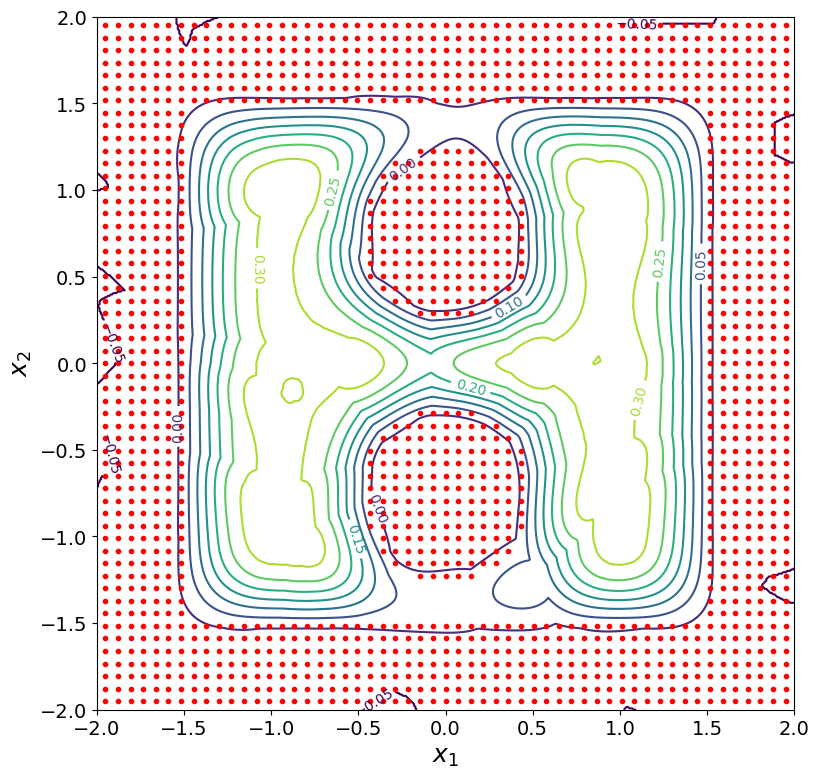

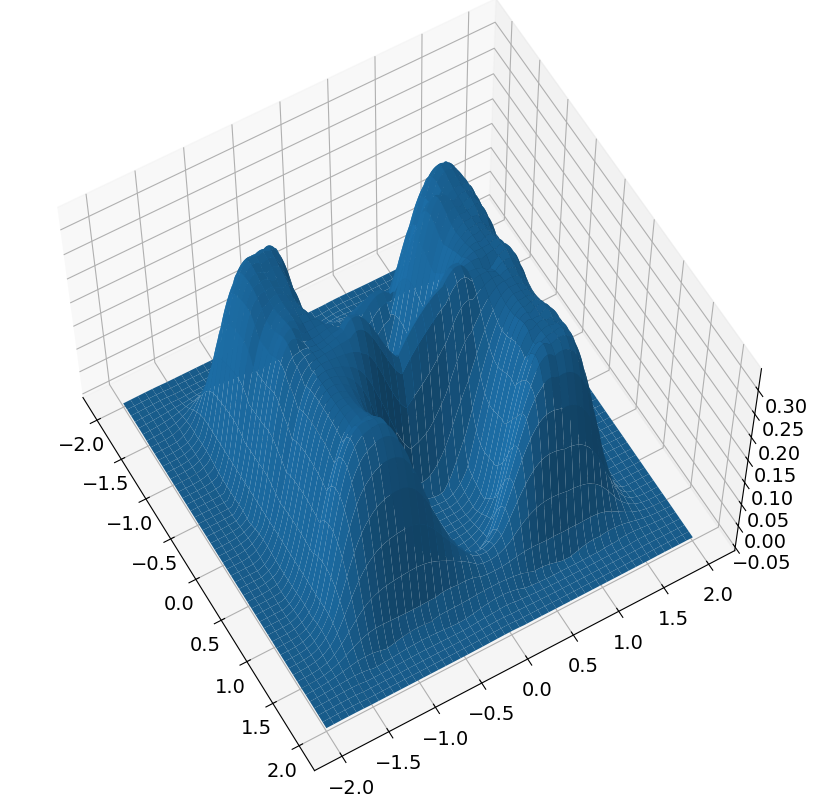

target: [ 1.71615651 -0.41354217]
target in goto [ 1.71615651 -0.41354217]
position is [ 1.46722327 -0.39321499]
h is 0.05000000000000006
start time is 950


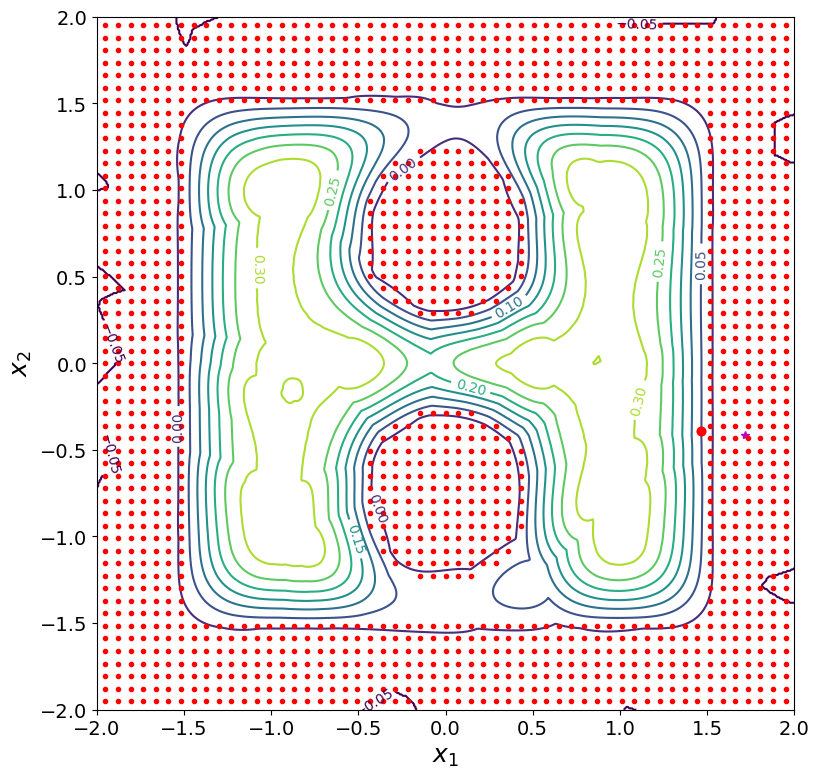

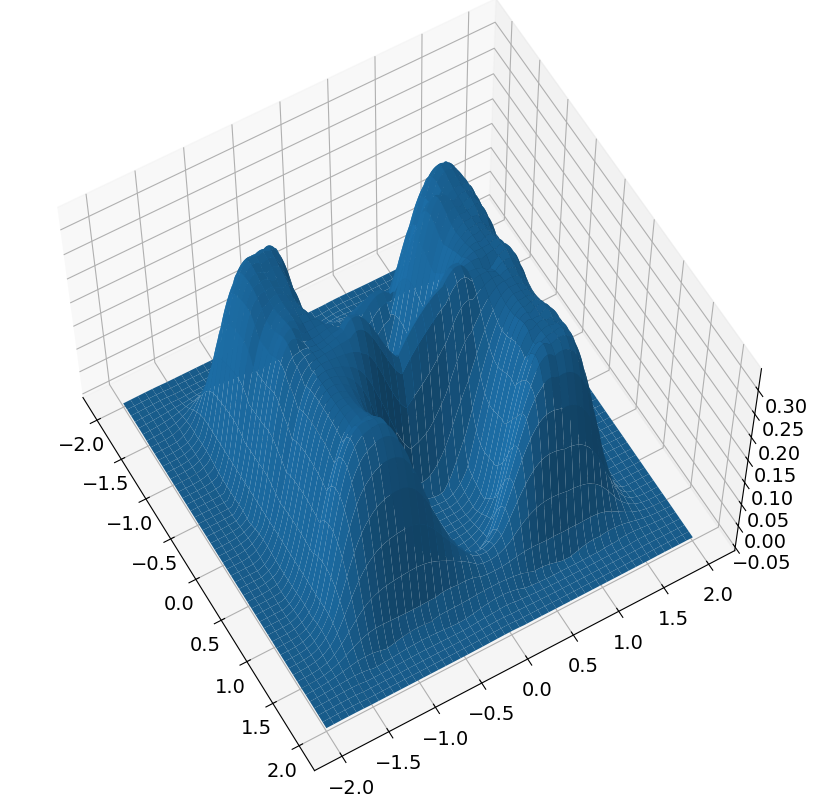

new position is [ 1.46722327 -0.39321499]
h is now 0.05
new time is 1000
dx: 7.771561172376096e-16
target: [-1.66716905 -1.33876288]
target in goto [-1.66716905 -1.33876288]
position is [ 1.46722327 -0.39321499]
h is 0.05
start time is 1000


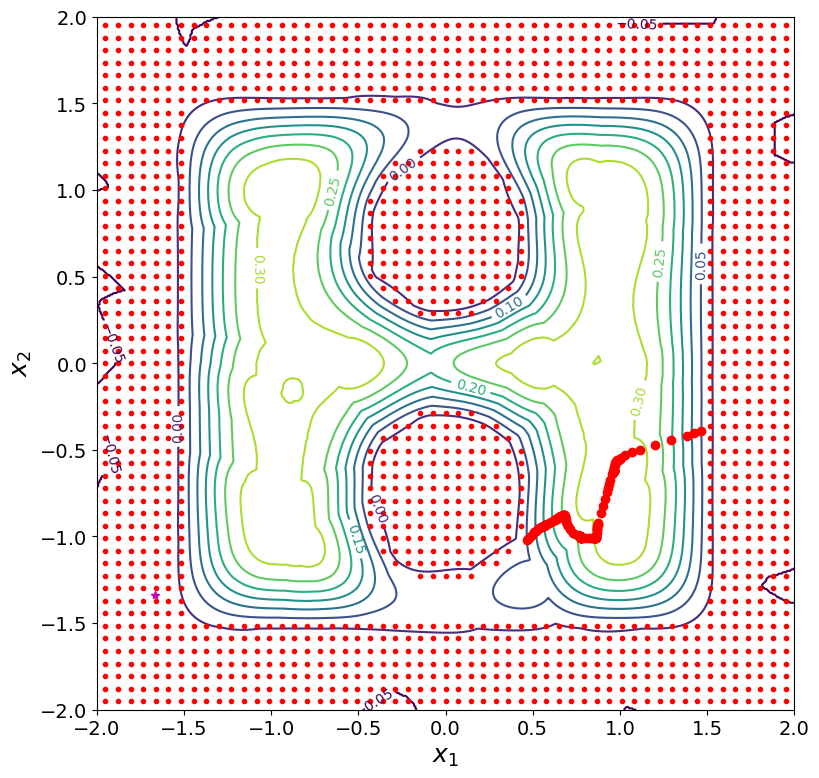

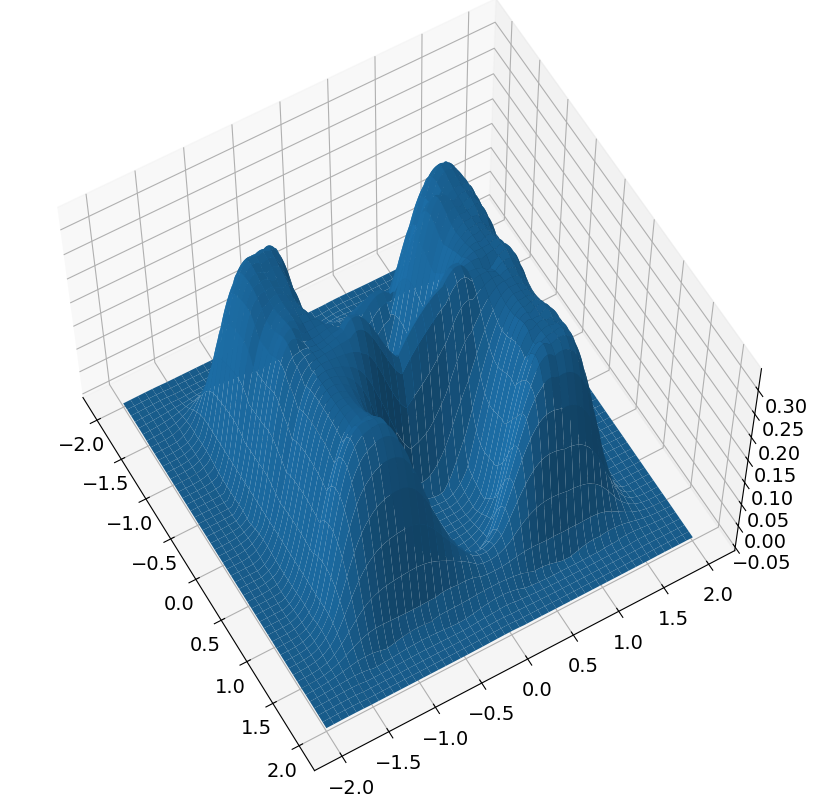

new position is [ 0.4667817  -1.02004456]
h is now 0.05000000000000003
new time is 1050
dx: 1.1805924924493503


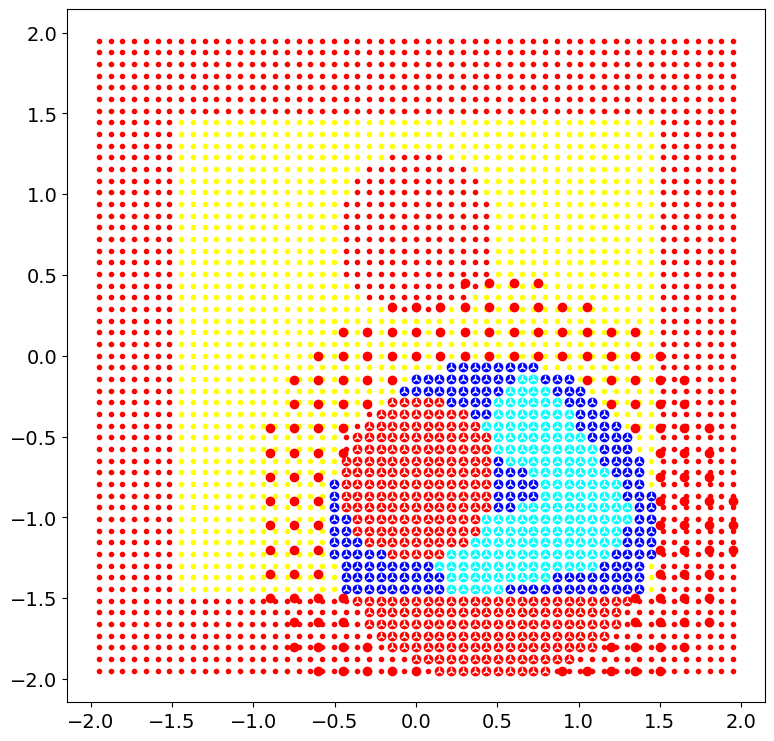

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          601     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29379D+06    |proj g|=  1.17700D+02


 This problem is unconstrained.



At iterate   50    f=  7.42918D+02    |proj g|=  7.88796D-01

At iterate  100    f=  7.42769D+02    |proj g|=  7.23346D-01

At iterate  150    f=  7.42741D+02    |proj g|=  6.97429D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  601    151    251      1     0     0   6.973D-01   7.427D+02
  F =   742.74089041611569     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(601, 2)
numc 601
cmax before 608
n

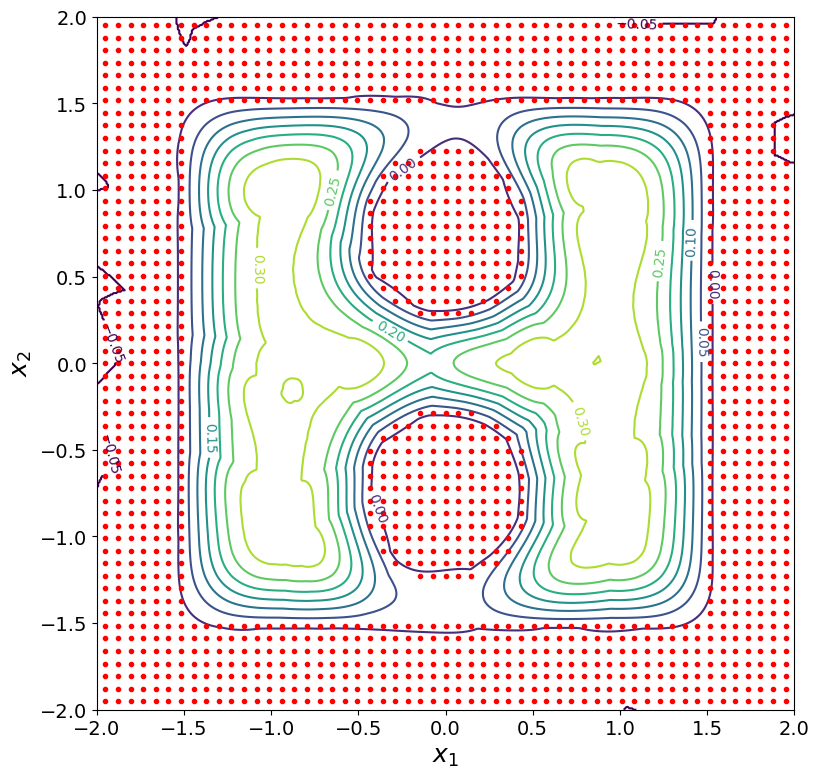

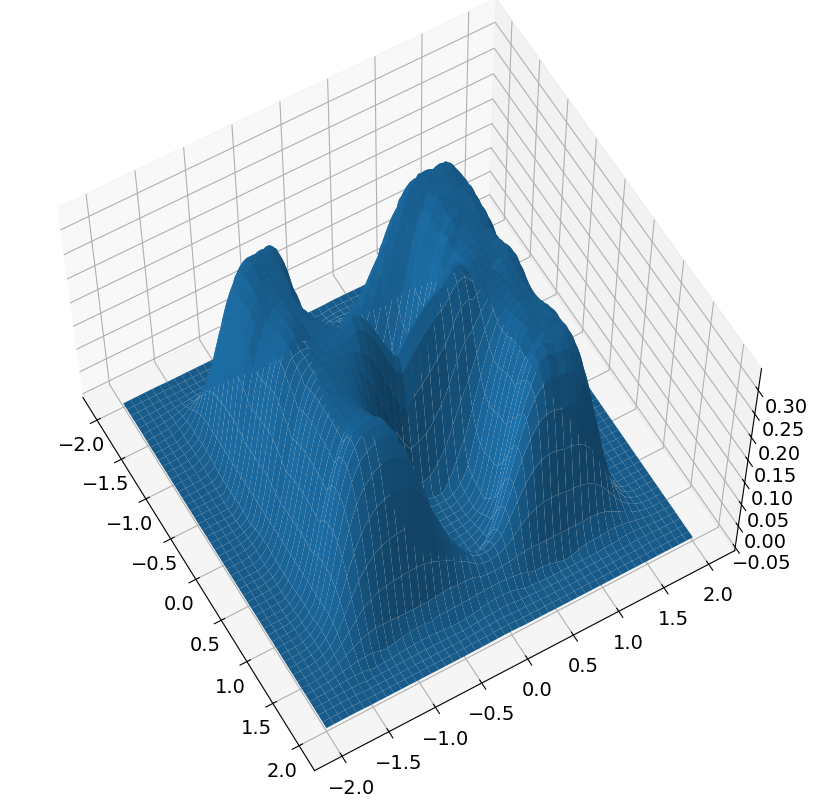

target: [ 1.73117462 -1.2678173 ]
target in goto [ 1.73117462 -1.2678173 ]
position is [ 0.4667817  -1.02004456]
h is 0.10402130073919992
start time is 1050


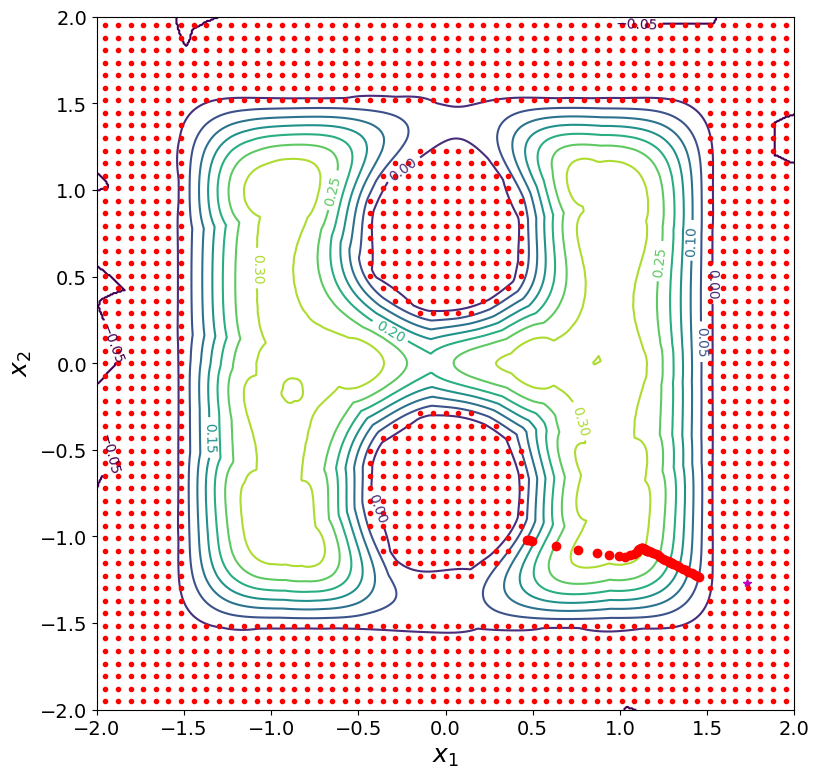

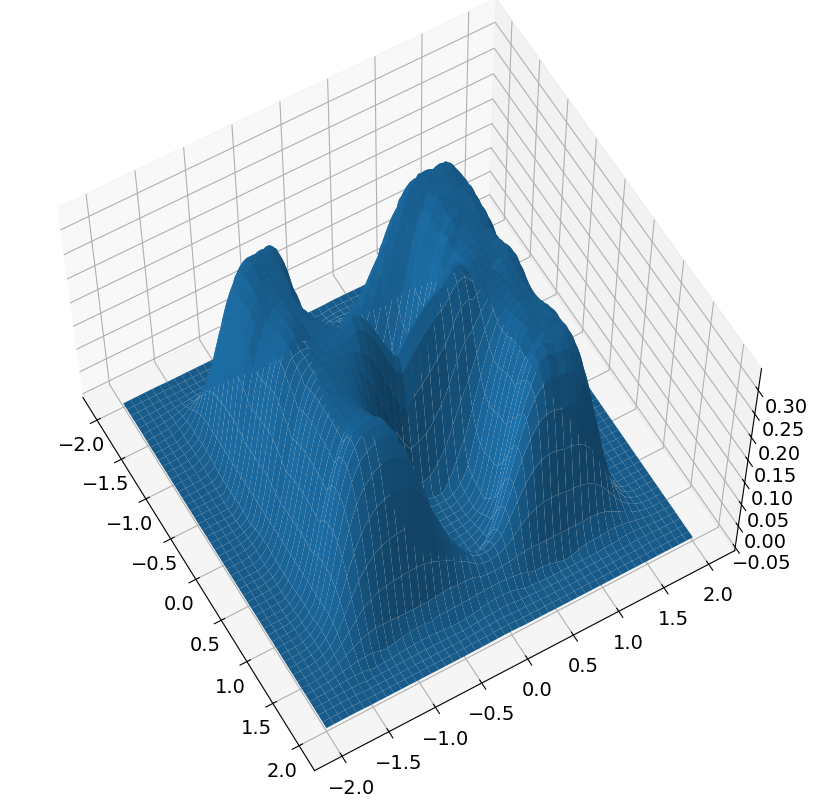

new position is [ 1.45297625 -1.23104195]
h is now 0.04999999999999992
new time is 1100
dx: 1.0085135582269846


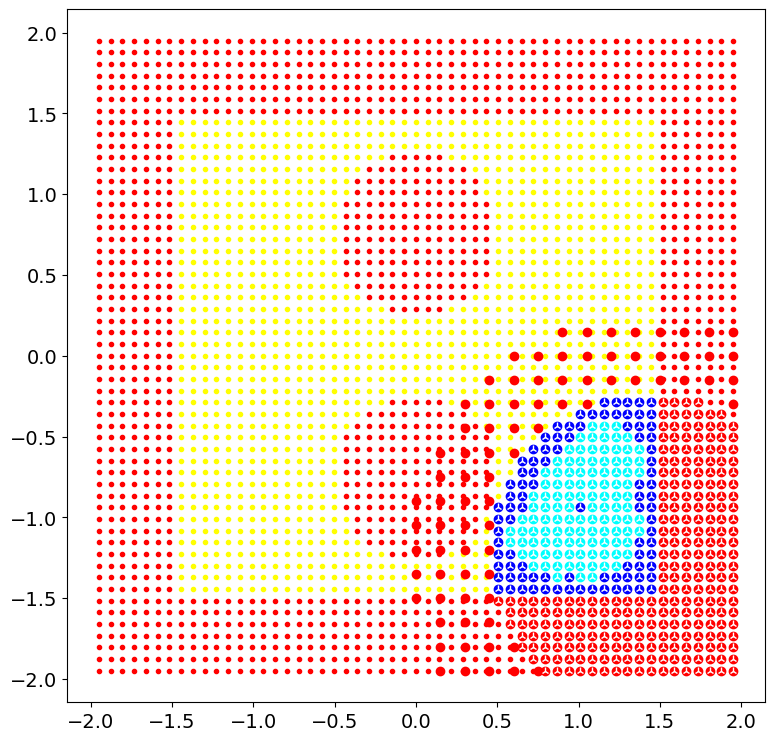

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          453     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.60155D+05    |proj g|=  1.11606D+02


 This problem is unconstrained.



At iterate   50    f=  4.81632D+02    |proj g|=  8.21498D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  453     79    166      1     0     0   1.411D+00   4.816D+02
  F =   481.55250118575640     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(453, 2)
numc 453
cmax before 608
numc <= self.cmax
Cnew shape before (453, 2)
Cnew shape after (453, 2)
theta shape before (453,)
theta_shape after (

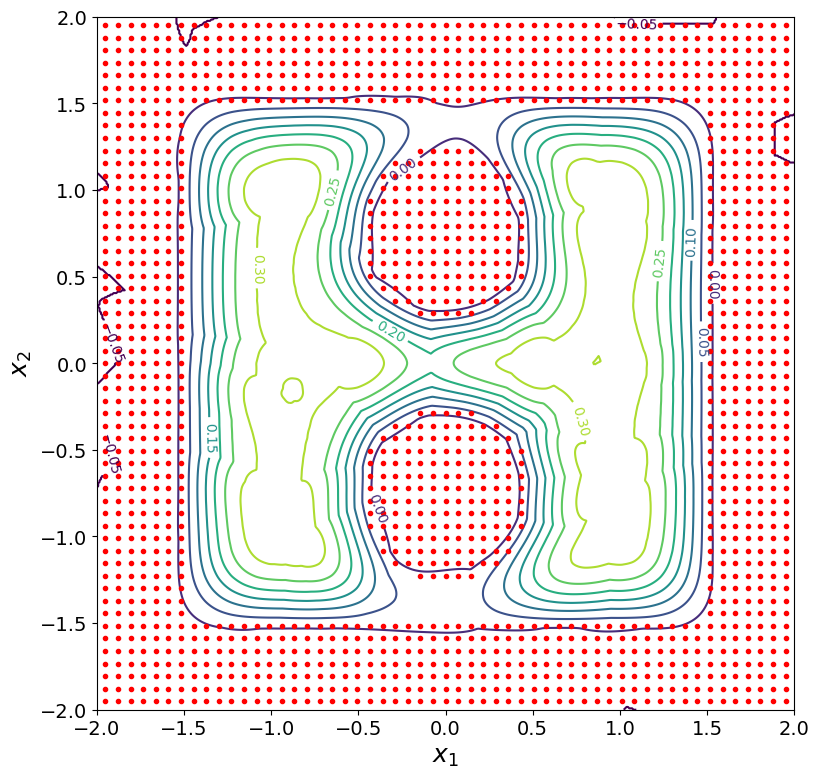

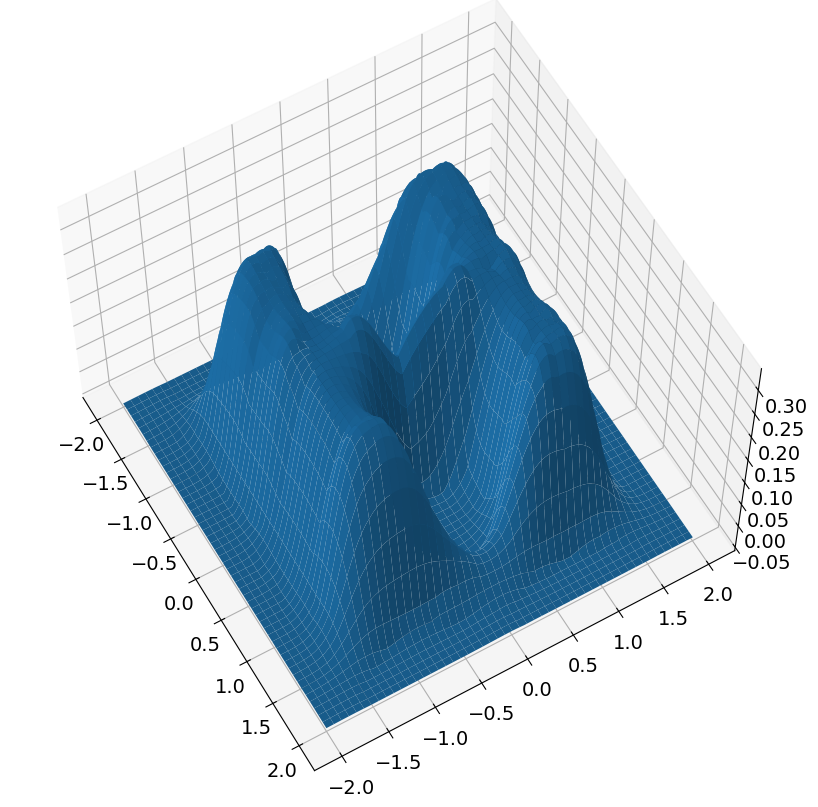

target: [ 0.3784863 -0.8377164]
target in goto [ 0.3784863 -0.8377164]
position is [ 1.45297625 -1.23104195]
h is 0.04999999999999992
start time is 1100


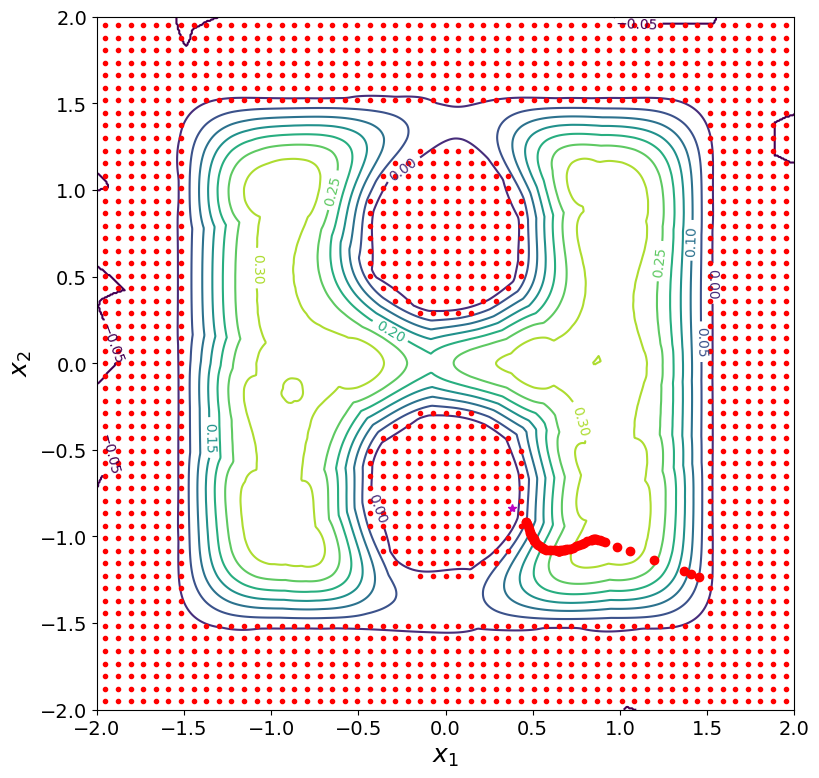

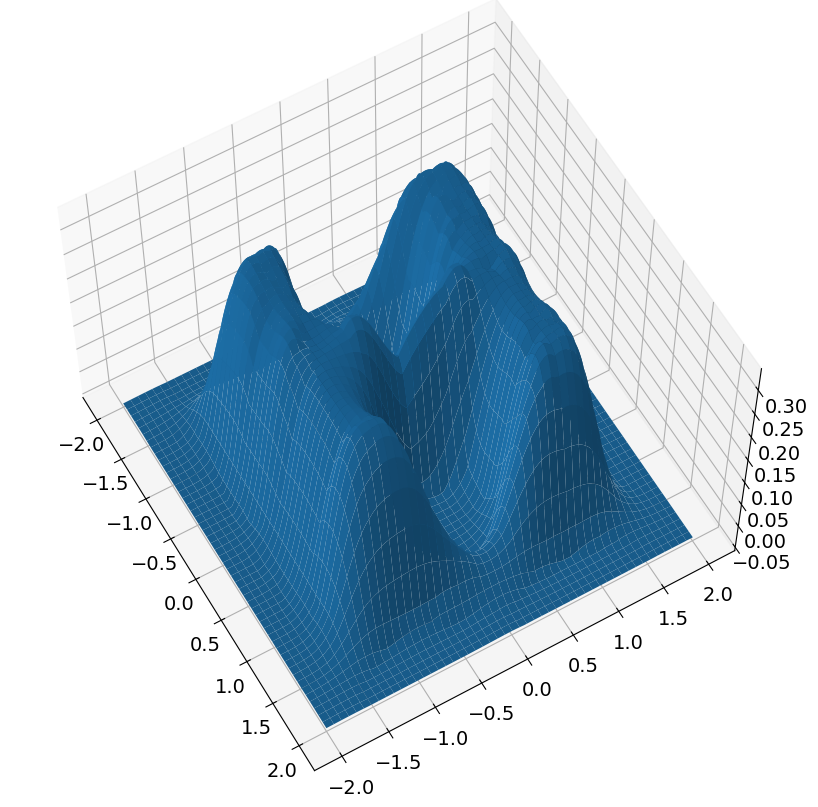

new position is [ 0.46130253 -0.91416008]
h is now 0.04999999999999999
new time is 1150
dx: 1.041071992673158


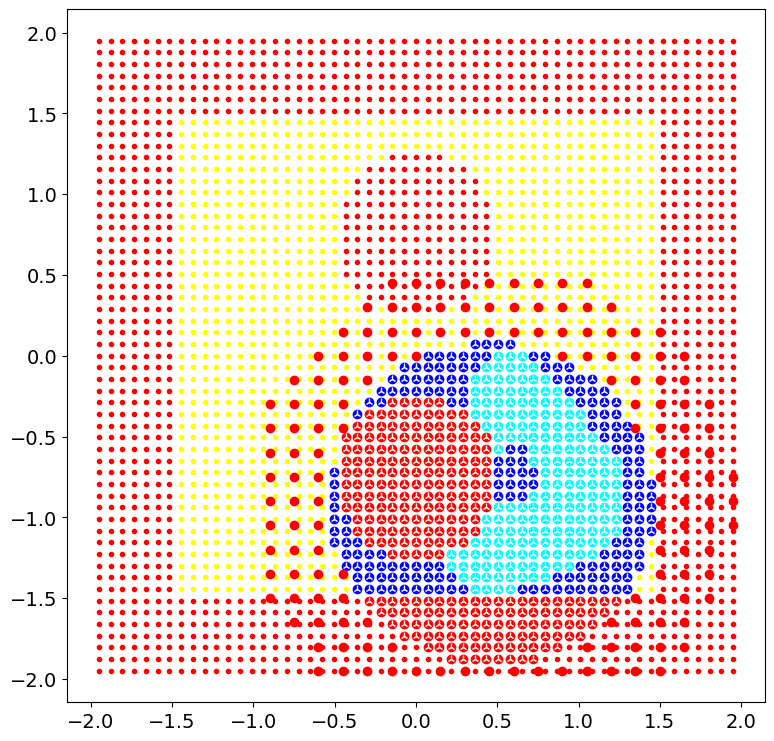

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          605     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29514D+06    |proj g|=  1.08307D+02


 This problem is unconstrained.



At iterate   50    f=  8.09215D+02    |proj g|=  8.07435D-01

At iterate  100    f=  8.08472D+02    |proj g|=  1.28716D+00

At iterate  150    f=  8.08397D+02    |proj g|=  8.82426D-01

At iterate  200    f=  8.08363D+02    |proj g|=  7.86520D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  605    207    326      1     0     0   9.685D-01   8.084D+02
  F =   808.36280769593532     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)


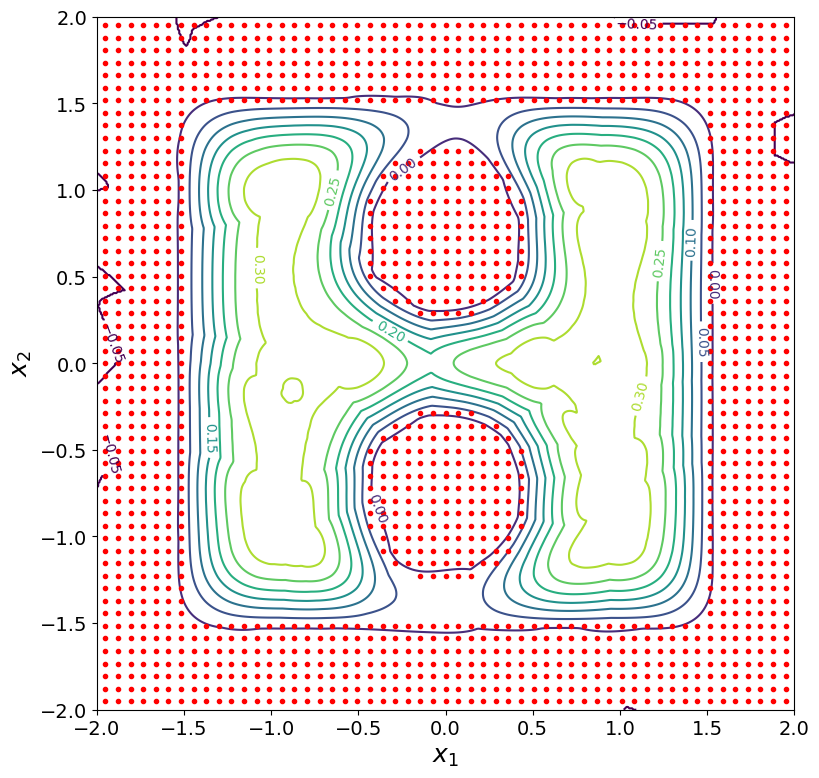

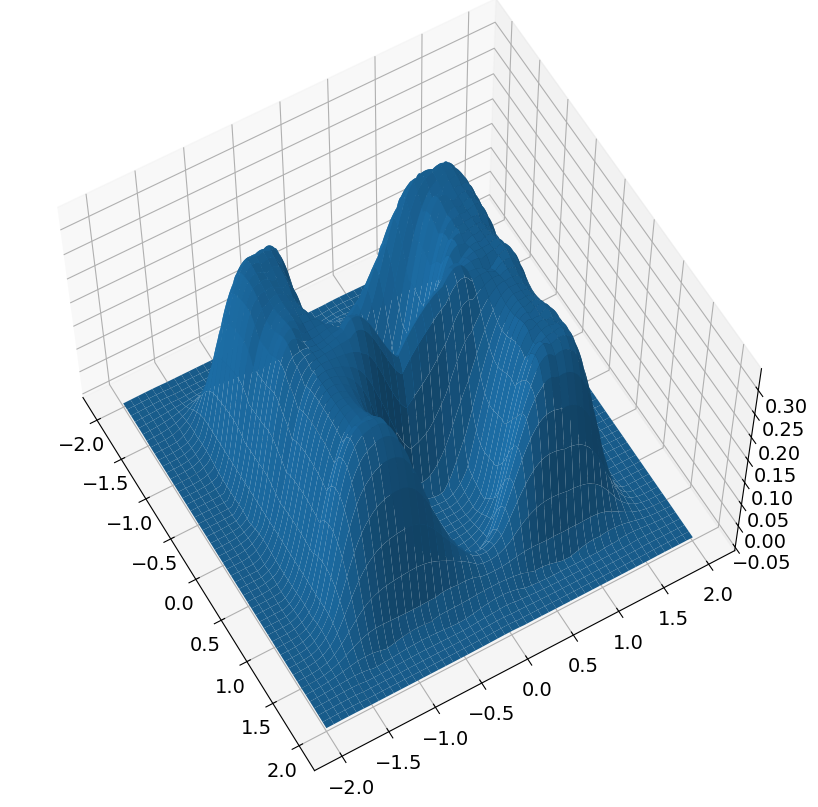

target: [1.52425703 1.80645502]
target in goto [1.52425703 1.80645502]
position is [ 0.46130253 -0.91416008]
h is 0.05259945748256194
start time is 1150


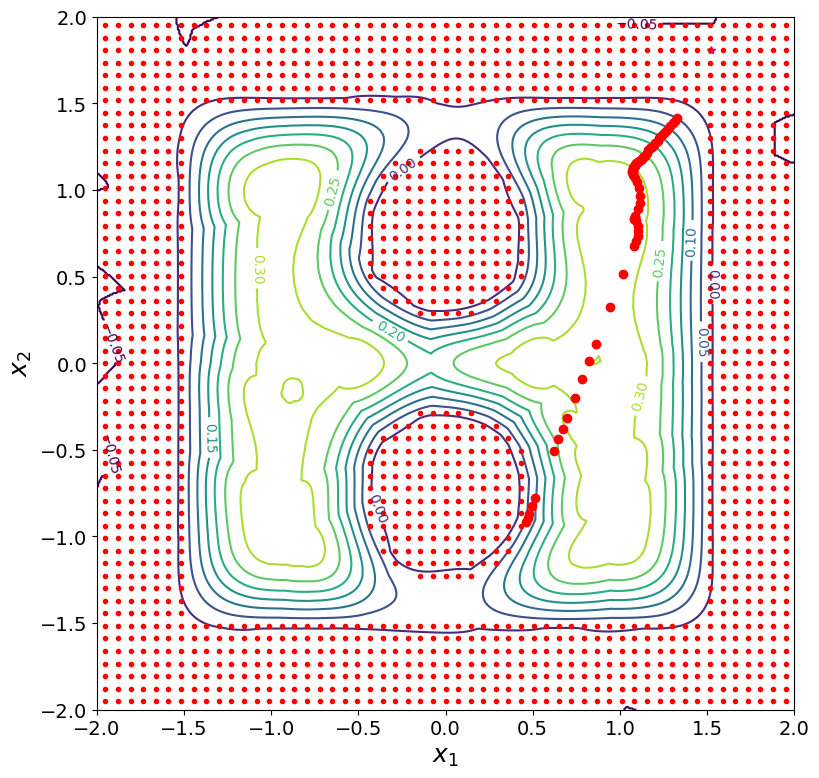

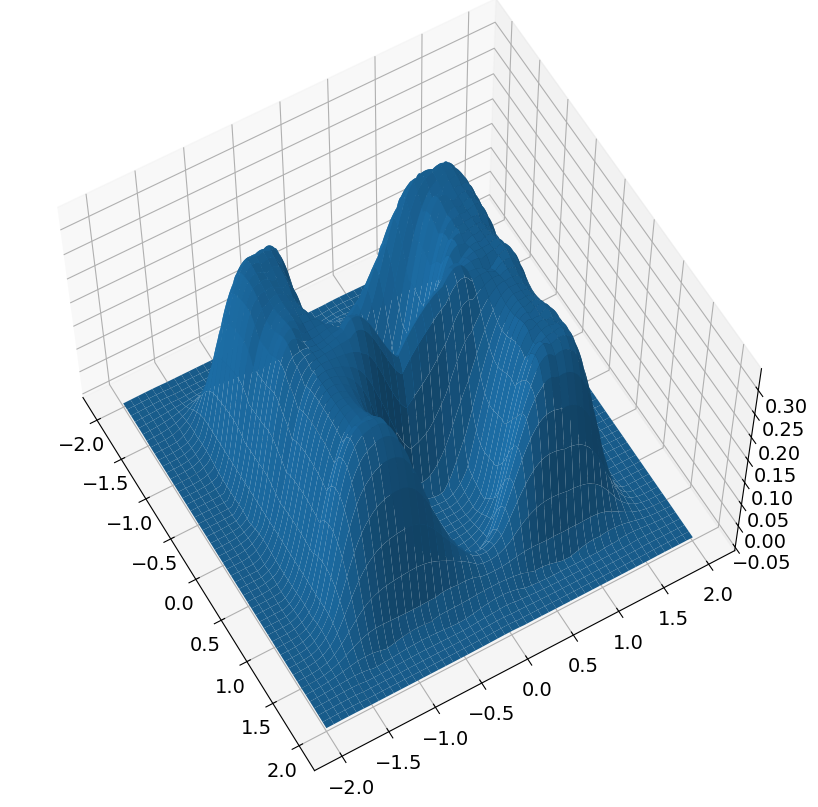

new position is [1.32604858 1.41396955]
h is now 0.05000000000000006
new time is 1200
dx: 2.48354047752459


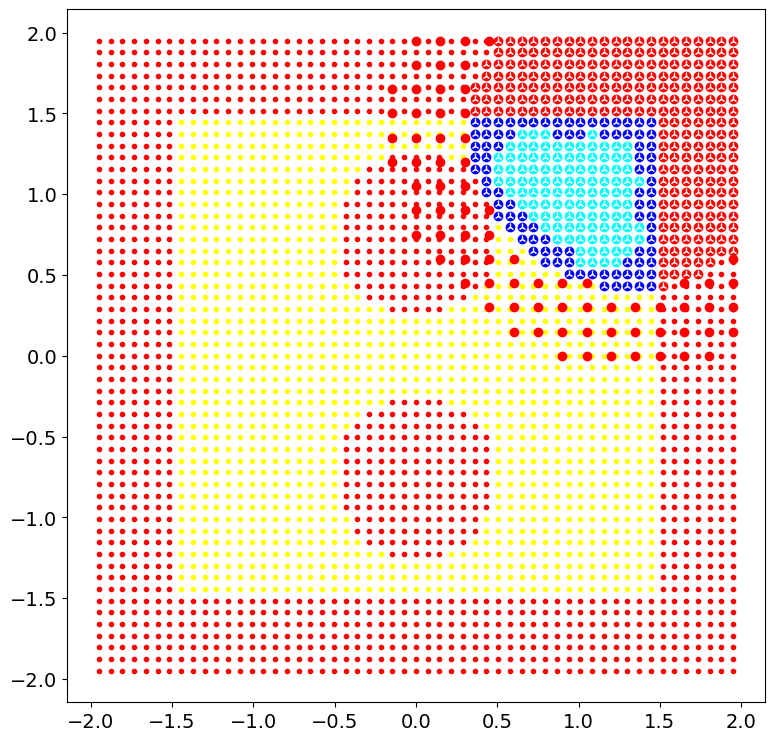

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          446     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.53505D+05    |proj g|=  1.14175D+02


 This problem is unconstrained.



At iterate   50    f=  4.68383D+02    |proj g|=  8.76471D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  446     78    143      1     0     0   9.190D-01   4.684D+02
  F =   468.35323547678502     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(446, 2)
numc 446
cmax before 608
numc <= self.cmax
Cnew shape before (446, 2)
Cnew shape after (446, 2)
theta shape before (446,)
t


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


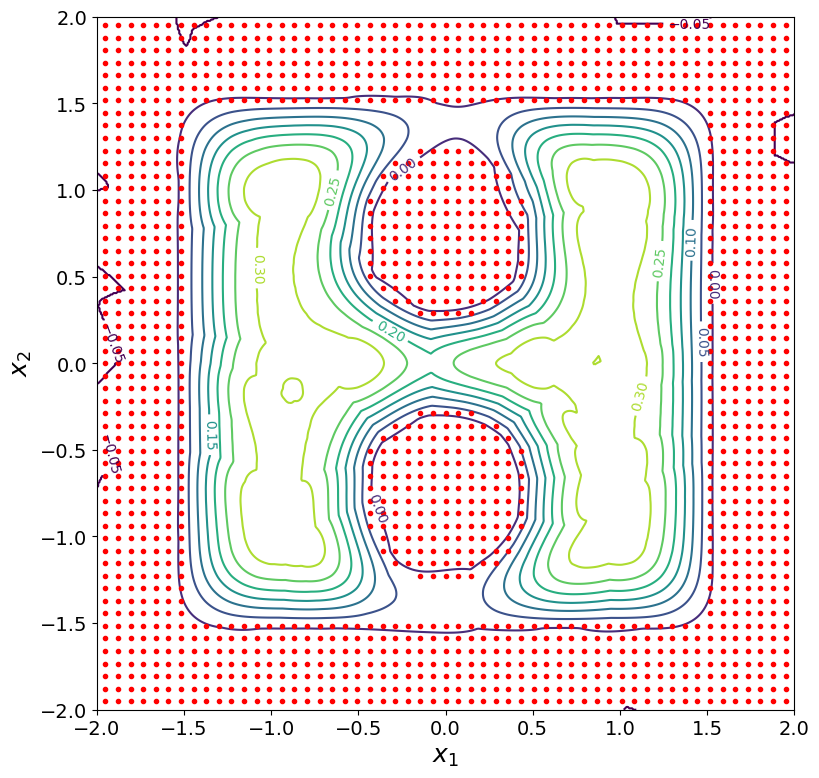

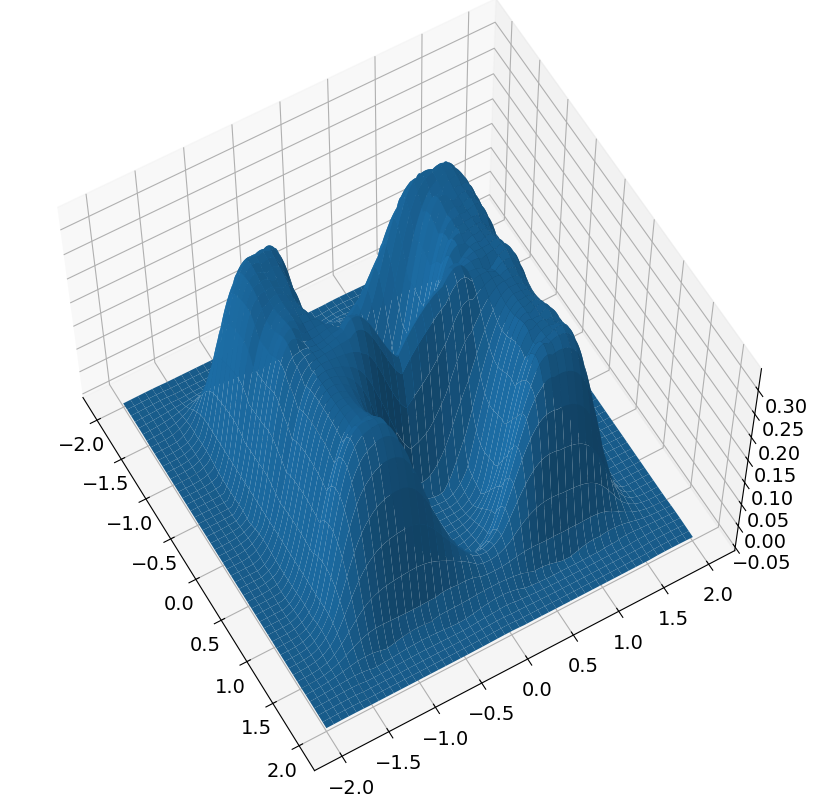

target: [1.89639737 1.61722723]
target in goto [1.89639737 1.61722723]
position is [1.32604858 1.41396955]
h is 0.052835326790200685
start time is 1200


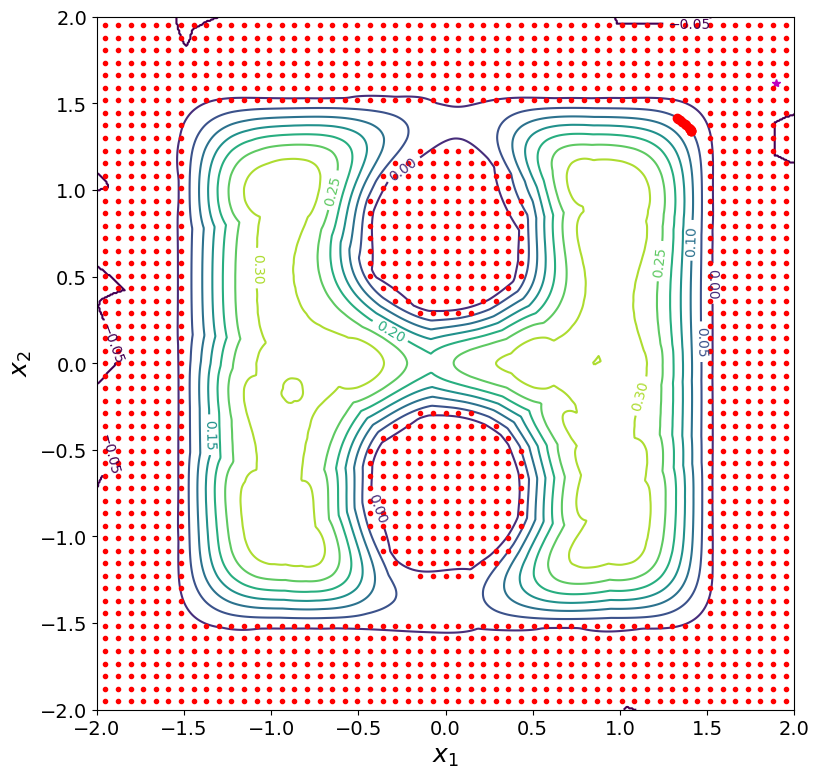

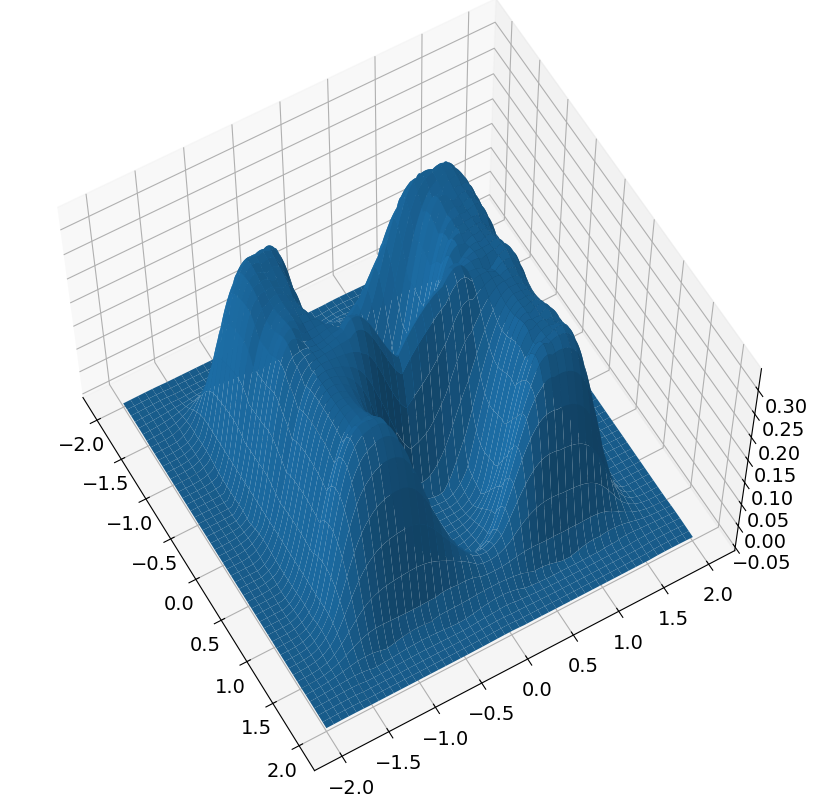

new position is [1.40959048 1.34247643]
h is now 0.05000000000000003
new time is 1250
dx: 0.10995688031570959


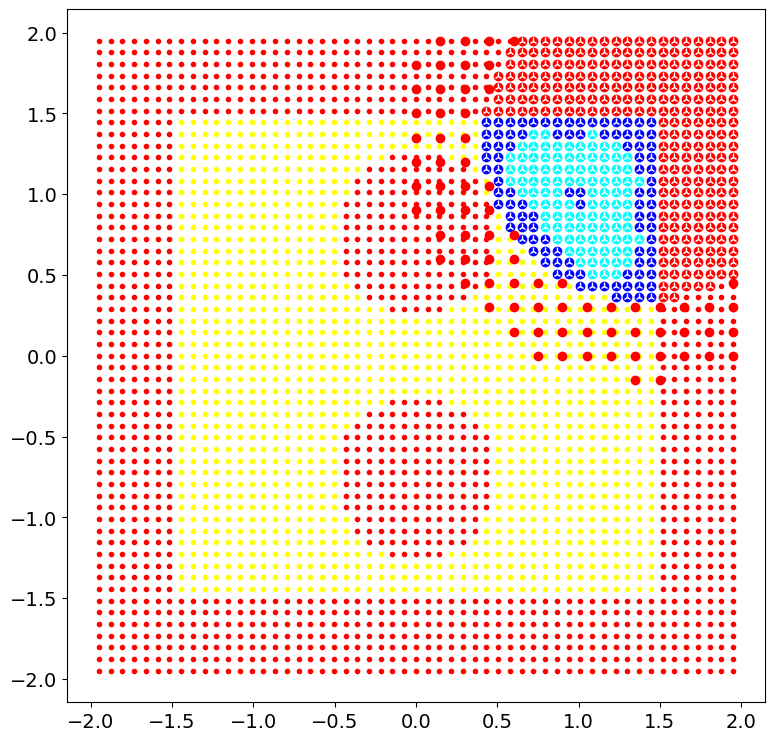

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          445     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.39519D+05    |proj g|=  1.12550D+02


 This problem is unconstrained.



At iterate   50    f=  4.53250D+02    |proj g|=  1.37305D+00

At iterate  100    f=  4.53180D+02    |proj g|=  8.07682D-01

centers shape before:
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(445, 2)
numc 445
cmax before 608
numc <= self.cmax
Cnew shape before (445, 2)
Cnew shape after (445, 2)
theta shape before (445,)
theta_shape after (608,)
cmax after 608
centers shape after
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
(608, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of a

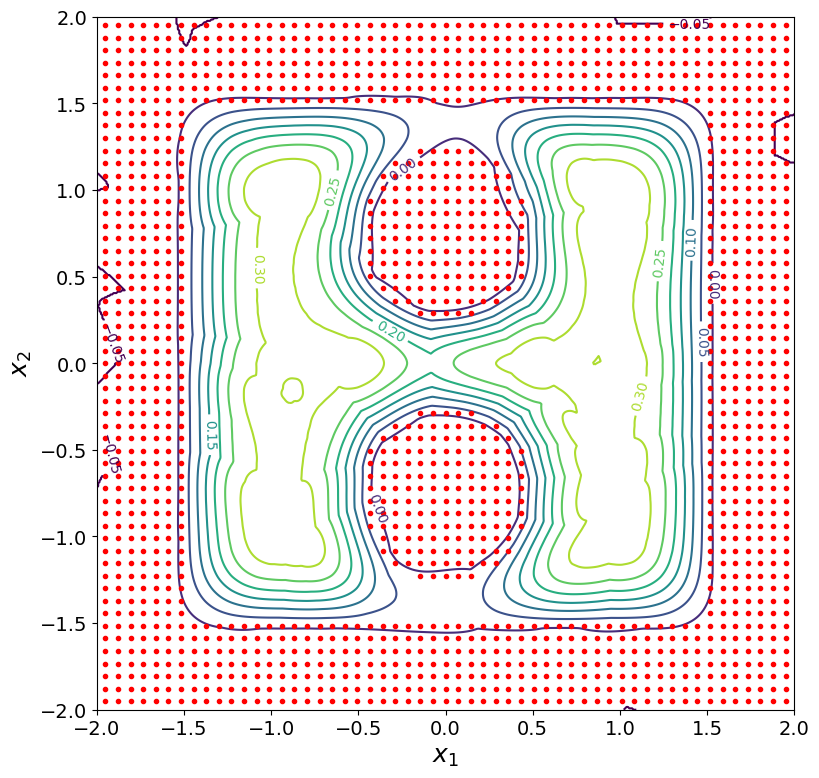

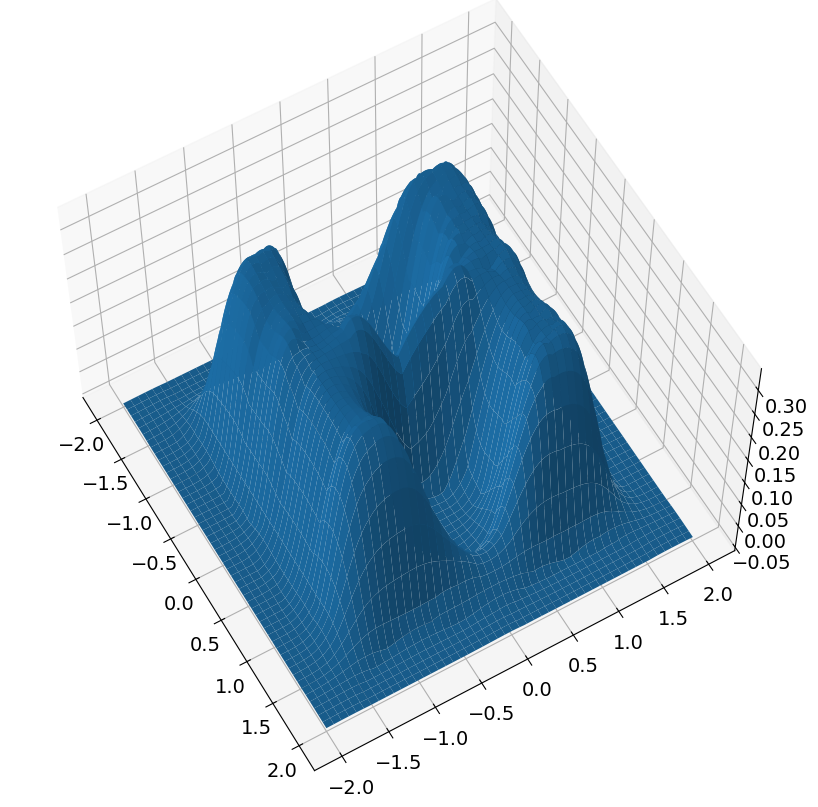

target: [ 1.77409923 -0.60363764]
target in goto [ 1.77409923 -0.60363764]
position is [1.40959048 1.34247643]
h is 0.05000000000000003
start time is 1250


KeyboardInterrupt: 

In [10]:
##########################
### Safe Exploration ###
##########################

for i in range(N):
    ######################
    ### Go to boundary ###
    ######################
    prev_pos = a.pos  
    while np.linalg.norm(a.pos - prev_pos) <= tol:    
        target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)  
        while h(target, np.array(a.centers), np.array(a.thetas))[0] > 0:
            target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)
        print("target:", target) 
        a.goto(target, T=T, tend=tend, tol=tol) 
        print("dx:", np.linalg.norm(a.pos - prev_pos))

    ####################
    ### Collect data ###
    ####################
    # unsafe data:
    scan_safe, scan_unsafe = a.scan()
    samples  = a.sample(rx, grid=s_grid) 
    if scan_unsafe.shape[0] != 0:
        x_unsafe = np.vstack((scan_unsafe, samples))
    else: 
        x_unsafe = samples 
    # safe and buffer data:
    n_safe = scan_safe.shape[0]
    x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)
    C  = [] 
    # centers:
    for x in c_grid:
        if np.linalg.norm(x - a.pos) <= rc:
            C.append(x)
    C = np.array(C)
    a.centers.append(C)
    plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                               (x_buffer, "blue"  , 'o'), 
                               (x_unsafe, "red"   , 'o'),
                               (C       , "white" , '2')])
    #####################
    ### Learn new CBF ###
    #####################

    L = get_learning_cbfs_lagrangian(a, x_safe, x_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
    theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, 10*(np.random.rand(C.shape[0], 1)-5), approx_grad=False, iprint=50)
    a.thetas.append(theta)
    a.rectify_c_and_theta()
    plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)